In [1]:
import math
import random
from typing import Tuple
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
random.seed(10)

In [2]:
import pickle
from pathlib import Path

# Structure: (theta, phi) -> (theta_etilt, phi_scan)
saved_tp = dict()
saved_tp_file = Path("t3p3.pkl")
if saved_tp_file.is_file():
    with open(saved_tp_file, "rb") as f:
        saved_tp = pickle.load(f)
        
# Structure: (segment, polygon) -> (boolean True or False)
saved_los = dict()

saved_los_file = Path("los3.pkl")
if saved_los_file.is_file():
    with open(saved_los_file, "rb") as f:
        saved_los = pickle.load(f)

In [3]:
!pip install Geometry3D shapely

In [4]:
from Geometry3D import *
from shapely import geometry

In [5]:
data = pd.read_csv("C:\\Users\\tniloy\\Downloads\\opencellid dataset\\310.csv", names=['radio', 'mcc', 'mnc', 'lac', 'cid', 'unit', 'longitude', 'latitude', 'range', 'samples', 'changeable', 'created', 'updated', 'averageSignal'])

In [6]:
data.head (10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
0,GSM,310,260,32192,22568,0,-73.858566,40.898438,1779,12,1,1459696254,1489125559,0
1,GSM,310,260,22629,61562,0,-95.876501,41.286475,3367,17,1,1459810860,1609205988,0
2,GSM,310,260,51052,44152,0,-71.084483,42.381728,1000,44,1,1459812328,1514115939,0
3,GSM,310,260,51051,40311,0,-71.085559,42.381356,1000,52,1,1459812328,1527695374,0
4,GSM,310,260,5973,60092,0,-95.570630,29.735371,1000,22,1,1459692332,1490851584,0
5,GSM,310,410,19007,7133,0,-87.258205,40.153886,19135,6,1,1459699529,1472415099,0
6,GSM,310,410,53005,50671,0,-95.563889,30.280380,1000,1,1,1459775023,1459775023,0
7,GSM,310,260,46136,15418,0,-76.999741,39.160080,1000,1,1,1459663271,1459663271,0
8,GSM,310,410,27672,59021,0,-81.741964,26.213691,1000,11,1,1459687298,1491031828,0
9,GSM,310,260,5973,50942,0,-95.560226,29.736557,1000,6,1,1459692332,1469493454,0


In [7]:
# center_x = 0
# center_y = 0
# center_z = 0
# FSS POsition:
lat_FSS= 37.20250
lon_FSS= -80.43444
R  = 6.371e6  #Radius of the earth

x_FSS = R * math.cos(math.radians(lat_FSS)) * math.cos(math.radians(lon_FSS))
y_FSS = R * math.cos(math.radians(lat_FSS)) * math.sin(math.radians(lon_FSS))
z_FSS = R * math.sin(math.radians(lat_FSS))

print("X, Y, Z = "+ str([x_FSS, y_FSS, z_FSS]))


radius=5000 #radius of the inclusion zone
latitude_range = radius / 110574
longitude_range = radius/(111320*math.cos(math.radians(latitude_range)))
print("Total area of inclusion zone is = " + str(radius*radius*math.pi))

X, Y, Z = [843264.3231973607, -5003968.368478095, 3852122.3823358943]
Total area of inclusion zone is = 78539816.33974482


In [8]:
print(latitude_range)
print(longitude_range)

0.04521858664785573
0.044915572737550945


In [9]:
data_within_zone = data[(data['radio'] == 'GSM') & (data['longitude'] <= (lon_FSS + longitude_range)) & (data['longitude'] >= (lon_FSS - longitude_range)) & (data['latitude'] <= (lat_FSS + latitude_range)) & (data['latitude'] >= (lat_FSS - latitude_range))]

data_within_zone.head(10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
780410,GSM,310,260,37630,43582,0,-80.393175,37.196127,8733,3992,1,1413757287,1435049916,0
1813932,GSM,310,260,32453,43561,0,-80.421524,37.189560,1000,9,1,1458834001,1491931840,0
1813934,GSM,310,260,32453,43602,0,-80.410309,37.233810,1000,6,1,1458834001,1479555225,0
1814053,GSM,310,260,32453,43822,0,-80.406704,37.227516,1000,8,1,1458834001,1479576548,0
1814075,GSM,310,260,32453,43583,0,-80.461073,37.203233,2207,15,1,1458834001,1477155991,0
1814213,GSM,310,260,32453,43581,0,-80.409897,37.217972,1000,5,1,1458834001,1473235293,0
1814220,GSM,310,260,32453,43601,0,-80.425186,37.236099,1000,6,1,1458834001,1473191254,0
1814361,GSM,310,260,32453,43562,0,-80.391645,37.165063,1000,11,1,1458834001,1489446412,0
1814366,GSM,310,260,32453,43603,0,-80.425415,37.222710,1000,4,1,1458834001,1474352285,0
1814368,GSM,310,260,32453,43621,0,-80.393486,37.224279,1033,56,1,1458834001,1482422269,0


In [10]:
len(data_within_zone)

33

In [11]:
import json
with open ('C:\\Users\\tniloy\\Downloads\\export (1).geojson') as f:
    df=json.load(f)
    data1=pd.json_normalize(df,record_path=['features'])
data1.head(10)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Feature,relation/548333,relation/548333,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Feature,relation/548339,relation/548339,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Feature,relation/548344,relation/548344,1406,Giles Road,church,NaN,Blacksburg First Wesleyan Church,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Feature,relation/548347,relation/548347,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Feature,relation/548348,relation/548348,NaN,NaN,residential,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Feature,relation/548371,relation/548371,1416,Palmer Drive,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Feature,relation/548372,relation/548372,900,Dickerson Lane,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Feature,relation/548373,relation/548373,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Feature,relation/548386,relation/548386,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data1[data1["properties.height"].notnull()].head(20)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,Feature,relation/1360465,relation/1360465,NaN,NaN,university,14.86,East Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,Feature,relation/1360466,relation/1360466,NaN,NaN,dormitory,14.86,West Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,Feature,relation/1360467,relation/1360467,NaN,NaN,dormitory,11.27,Slusher Wing,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,Feature,relation/1360468,relation/1360468,NaN,NaN,dormitory,33.59,Slusher Tower,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37,Feature,relation/1360469,relation/1360469,NaN,NaN,dormitory,14.86,Main Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,Feature,way/26210227,way/26210227,NaN,NaN,university,15.47,Cheatham Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Feature,way/26210236,way/26210236,285,Ag Quad Lane,university,11.57,Dietrick Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Feature,way/32709325,way/32709325,570,Washington Street Southwest,dormitory,25.82,Hoge Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,Feature,way/32953606,way/32953606,210,Drillfield Drive,university,11.61,Sandy Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
data1["geometry.coordinates"].head(10)

0    [[[-80.4194702, 37.2238774], [-80.4194505, 37....
1    [[[-80.4070717, 37.2320238], [-80.4069865, 37....
2    [[[-80.4068521, 37.2319488], [-80.4069373, 37....
3    [[[-80.4104274, 37.2506844], [-80.4104412, 37....
4    [[[-80.4355296, 37.2138316], [-80.4355103, 37....
5    [[[-80.4416012, 37.2238365], [-80.4417281, 37....
6    [[[-80.3924701, 37.2185727], [-80.3923812, 37....
7    [[[-80.4121293, 37.2397986], [-80.4121648, 37....
8    [[[-80.4075916, 37.2253453], [-80.4076676, 37....
9    [[[-80.4071473, 37.2322051], [-80.4072218, 37....
Name: geometry.coordinates, dtype: object

In [14]:
class Building:
    def __init__(self, coordinates=None, height=None):
        self.coordinates = []
        if coordinates is not None:
            self.coordinates = coordinates
        
        if height is None or not str(height).isdigit():
            self.height = random.uniform(10, 40)
        else:
            self.height = height
        
        self.x_coord, self.y_coord, self.z_coord = self.latlon_to_XYZ()
        
        self.points = []
        for i in range(len(self.x_coord)):
            x, y, z = self.x_coord[i], self.y_coord[i], self.z_coord[i]
            self.points.append(Point(x,y,z))
        
        self.xy_points = np.array([(p.x, p.y) for p in self.points])
        self.xy_polygon = geometry.Polygon(self.xy_points)
        
        self.wall_polygons = self.get_wall_polygons()
    
    def latlon_to_XYZ(self):
        x_coord = np.array([])
        y_coord = np.array([])
        z_coord = np.array([])
        
        # bottom points of building at each coordinate
        for lon, lat in self.coordinates:
            x = R * math.cos(math.radians(lat)) * math.cos(math.radians(lon))
            y = R * math.cos(math.radians(lat)) * math.sin(math.radians(lon))
            x_coord = np.append(x_coord, x)
            y_coord = np.append(y_coord, y)
            z_coord = np.append(z_coord, 0)
            # z_coord = np.append(z_coord, self.height)
            
        # make coordinates to relative to FSS position
        x_coord -= x_FSS
        y_coord -= y_FSS
        
        return x_coord, y_coord, z_coord

    def get_wall_polygons(self):
        polygons = []

        # points = [Point(x,y,0) for x,y in p.boundary.coords]
        # polygons.append(ConvexPolygon(points))
        points = [Point(x,y,self.height) for x,y in self.xy_polygon.boundary.coords]
        # polygons.append(ConvexPolygon(points))

        for i in range(len(points)-1):
            high_point_1 = points[i]
            high_point_2 = points[i + 1]
            low_point_1 = Point(high_point_1.x, high_point_1.y, 0)
            low_point_2 = Point(high_point_2.x, high_point_2.y, 0)

            poly_points = [low_point_1, low_point_2, high_point_1, high_point_2]
            #print(poly_points)
            polygons.append(ConvexPolygon(poly_points))
            
        return polygons
        

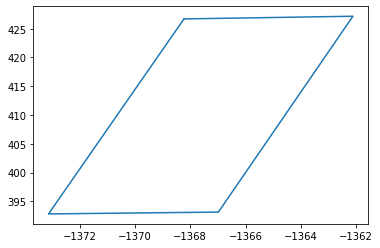

In [15]:
from shapely import geometry

b = Building(data1.iloc[500]["geometry.coordinates"][0], data1.iloc[500]["properties.height"])
x, y = b.xy_polygon.boundary.xy
plt.plot(x, y)

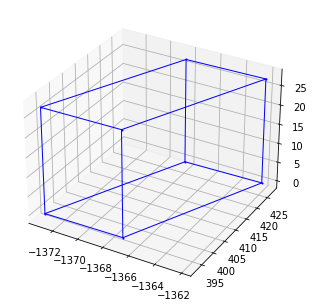

In [16]:
r = Renderer(backend='matplotlib')
for p in b.wall_polygons:
    r.add((p,'b',1),normal_length=0)
r.show()

In [17]:
from tqdm import tqdm
buildings = []

for i in tqdm(range(len(data1))):
    for coords in data1.iloc[i]["geometry.coordinates"]:
        try:
            buildings.append(Building(coords, data1.iloc[i]["properties.height"]))
        except:
            print(f"Skipping building {i}")

  1%|▍                                                                              | 45/8644 [00:00<00:38, 225.85it/s]

Skipping building 26
Skipping building 26
Skipping building 27
Skipping building 27
Skipping building 27
Skipping building 28
Skipping building 28
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 53
Skipping building 53
Skipping building 53
Skipping building 53


100%|█████████████████████████████████████████████████████████████████████████████| 8644/8644 [00:16<00:00, 509.43it/s]

Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8170
Skipping building 8170
Skipping building 8170
Skipping bu

In [18]:
class FSS_Channels:
  # channels start at 0, so a channel plan with 8 channels is from 0 to 7

  band_width = 240e6 # 240MHz

  # 10.7-12.7 GHz frequency range
  range_start = 10.7e9 # 10.7GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 8

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # FSS channel spacing should be 10MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel_start = int((0.5 + channel) * FSS_Channels.space_between_channels + channel * FSS_Channels.band_width)
    channel_end = channel_start + FSS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [19]:
class BS_Channels:
  # channels start at 1, so a channel plan with 5 channels is from 1 to 5

  band_width = 100e6 # 100MHz

  # 12.2-12.7 GHz frequency range
  range_start = 12.2e9 # 12.2GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 5

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # BS channel spacing should be 0MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel -= 1
    
    channel_start = int((0.5 + channel) * BS_Channels.space_between_channels + channel * BS_Channels.band_width)
    channel_end = channel_start + BS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [20]:
# class BS:
#   def __init__(self, radius, max_height, carr_freq, interference_type):
#     self.radius = radius
#     self.max_height = max_height
#     self.carr_freq = carr_freq
#     self.interference_type = interference_type
#     self.base_heights = {
#         'UMi': 10,
#         'UMa': 25,
#         'RMa': 35,
#         None: random.randint(10, 35)
#     }
#     self.BS_x = random.randint(-4000,4000) + 1000*random.random()
#     self.BS_y = random.randint(-4000,4000) + 1000*random.random()
#     self.BS_z = self.base_heights[self.interference_type]

#   def BS_random_co_ordinates(self):
#     return self.BS_x, self.BS_y, self.BS_z
 
#   def UE_random_co_ordinates(self):
#     UE_x = random.randint(-4000,4000) + 1000*random.random()
#     UE_y = random.randint(-4000,4000) + 1000*random.random()
#     UE_z = random.uniform(0,1.5)
    
#     return UE_x, UE_y, UE_z

# # Creating the FSS class
#   def FSS_random_co_ordinates(self):

#     FSS_x = random.randint(-4000,4000) + 1000*random.random()
#     FSS_y = random.randint(-4000,4000) + 1000*random.random()
#     FSS_z = random.choice([1.5,4.5])
    
#     return FSS_x, FSS_y, FSS_z


In [21]:
def path_loss_UMi(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##UMi
##LOS,SF=4:

##(10m<=d_2D)<=D_BP:
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y-BS_Y)**2)+((4.5-10)**2))
    hBs=10
    fc=12
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL1umi=32.4+ 21*math.log10(d_3D)+ 20*math.log10(fc)
    
##(D_BP<=d_2D)<=5000m:
    hBs=10
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL2umi=32.4+40*math.log10(d_3D)+20*math.log10(fc)-9.5*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMiLOS=PL1umi
    elif D_BP<=d_2D and  d_2D<=5000:
        PLUMiLOS= PL2umi  
    else:
        PLUMiLOS=1

##NLOS,SF=7.82:
    PL1umiNLOS= 35.3*math.log10(d_3D)+22.4+21.3*math.log10(fc)-0.3*(hUT-1.5)
    PLUMiNLOS= max(PLUMiLOS,PL1umiNLOS)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, 10), Point(FSS_X, FSS_Y, 4.5))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMi = PLUMiNLOS
                    line_of_sight = False
                else:
                    path_loss_UMi = PLUMiLOS
#                     line_of_sight = True
    
 # intersection(line, polygon): [Intersection], None
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMi = PLUMiNLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMi = PLUMiLOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
    
# #Loss Probability:
#     if d_2D>18:
#         PrLosUmi=(18/d_2D)+math.exp((-(d_2D/36))*(1-(18/d_2D)))     
#     else:
#         PrLosUmi=1 ##d_2d<=18     
#     if PrLosUmi > random.random():
#         path_loss_UMi = PLUMiLOS   
#     else:
#         path_loss_UMi = PLUMiNLOS   
##path_loss 
#     path_loss_UMi= PL2umi*PrLosUmi+PL1umiNLOS*(1-PrLosUmi)
    
    return path_loss_UMi, d_2D, line_of_sight

In [22]:
def path_loss_UMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4:
##(10m<=d_2D)<=D_BP:
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+(FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2)
    hBs=25
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL3uma=28.0+22*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D) <=5000m:
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL4uma=28.0+40*math.log10(d_3D)+20*math.log10(fc)-9*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMALOS=PL3uma
    elif D_BP<=d_2D and d_2D<=5000:
         PLUMALOS= PL4uma  
    else:
        PLUMALOS=1
        
##NLOS,SF=6:
    PL1NLOSuma=13.54+39.08*math.log10(d_3D)+20*math.log10(fc)-0.6*(hUT-1.5)
    PLUMANLOS=max(PLUMALOS,PL1NLOSuma)
    
    line_of_sight = True

##NLOS,SF=7.8 (optional)
##PL_Optional=32.4+20*math.log(fc)+30*math.log(d_3D)


##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMa = PLUMANLOS
                    line_of_sight = False
                else:
                    path_loss_UMa = PLUMALOS
#                     line_of_sight = True
                
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMa = PLUMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMa = PLUMALOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False


##Loss Probability:
#     if d_2D >18:
#         if hUT<=13:
#             ChUT=0
#         elif 13<hUT and hUT<=23:
#             ChUT=((hUT-13)/10)**1.5  
#         PrLOSUma=((18/d_2D)+math.exp((-(d_2D/63))*(1-(18/d_2D))))*(1+ChUT*(5/4)*((d_2D/100)**3)*math.exp(-(d_2D/150)))
#     else:##18m<d_2D:
#         PrLOSUma=1
        
#     if PrLOSUma > random.random():
#         path_loss_UMa = PLUMALOS
    
#     else:
#         path_loss_UMa = PLUMANLOS
    
##Path Loss
#     path_loss_UMa= PL4uma*PrLOSUma+PL1NLOSuma*(1-PrLOSUma)
    return path_loss_UMa, d_2D, line_of_sight

In [23]:
def path_loss_RMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4(PL1),SF=6(PL2)
##10m<=d_2D<=d_BP: 
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2))
    hBs=35
    d_3D= math.sqrt(hBs**2+d_2D**2)
    PL1rma=20*math.log10((40*math.pi*d_3D*fc)/3)+ min(0.03*h**1.72,10)*math.log10(d_3D)-min(0.044*h**1.72,14.77)+0.002*math.log10(h)*d_3D
    
##d_BP<=d_2D<=10km:
    hUT=4.5
    c=3e8
    d_BP= (2*math.pi*hBs*hUT*12e9)/c
    PL2rma= PL1rma*(d_BP)+40*math.log10(d_3D/d_BP)

    if 10<=d_2D and d_2D <=d_BP:
        PLRMALOS=PL1rma
    elif d_BP<=d_2D and d_2D <=10000:
        PLRMALOS= PL2rma  
    else:
        PLRMALOS=1

##NLOS,SF=8:
    W=20
    h=5
    PL1NLOSrma= 161.04-7.11*math.log10(W)+7.5*math.log10(h)-(24.37-3.7*(h/hBs)**2)*math.log10(hBs)+(43.42-3.1*math.log10(hBs))*(math.log10(d_3D)-3)+20*math.log10(fc)-(3.2*(math.log10(11.75*hUT))**2-4.97)
    PLRMANLOS=max(PLRMALOS,PL1NLOSrma)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_RMa = PLRMANLOS
                    line_of_sight = False
                else:
                    path_loss_RMa = PLRMALOS
                    # line_of_sight = True
   
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_RMa = PLRMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_RMa = PLRMALOS
                # line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
                
    

# ##Loss Probability:
#     if d_2D>10:
#         PrLOSrma=math.exp(-((d_2D-10)/1000))
        
# ## 10m<d_2D:
#     else:
#         PrLOSrma=1
        
#     if PrLOSrma > random.random():
#         path_loss_RMa= PLRMALOS
    
#     else:
#         path_loss_RMa = PLRMANLOS

##PathLoss:
#     path_loss_RMa=PL2rma*PrLOSrma+PL1NLOSrma*(1-PrLOSrma)
    return path_loss_RMa, d_2D,  line_of_sight

In [24]:
def Interface_UMi_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMi,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        # theta_tilt, phi_scan = max_gain_5g_parameters(theta, phi)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, (10-4.5)

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
#         print("Angle between interference axis and FSS main lobe:", fss_phi_difference)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)

        TXPower= -6.77     #8- 10* math.log10(30) #N=30, for 38dbm=8db
#         LBuildingLoss=1
        interface1=TXPower+ G_5G_R-pathloss_UMi- LBodyLoss + G_Rx_5G
        return interface1,pathloss_UMi

In [25]:
def Interface_UMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface2=TXPower+ G_5G_R-pathloss_UMa- LBodyLoss + G_Rx_5G
        return interface2,pathloss_UMa

In [26]:
def Interface_RMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_RMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("fss_phi_difference:", fss_phi_difference)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface3=TXPower+ G_5G_R-pathloss_RMa-LBodyLoss + G_Rx_5G
        return interface3,pathloss_RMa

In [27]:
k = 1.38064852*10**(-23)
T=200
B=240e6
Noise = 10*math.log10(k*T*B)
Noise_W = 10 ** (Noise / 10)
print('Noise:', Noise)
print('Noise in Watts:', Noise_W)

Noise: -121.78675630934148
Noise in Watts: 6.627112895999999e-13


In [28]:
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33

# fss1 = BS(radius, max_height=1.5, carr_freq=12e3, interference_type=None)

x,y,z = 0,0,4.5

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}
  
exclusion_zones = [500, 1000, 2000, 3000, 4000]
        
def simulate(output=True):
    FSS_X=np.array([])
    FSS_Y=np.array([])
    FSS_Z=np.array([])
    FSS_CHANNELS = []
    for i in range (1):
        FSS_X = np.append(FSS_X, 0)
        FSS_Y = np.append(FSS_Y, 0)
        FSS_Z = np.append(FSS_Z, 4.5)
        # 0 means not in use, 1 means in use
        channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
        channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
        FSS_CHANNELS.append(channels_used)
        if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
    if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)

    # Create base stations
    BS_X=np.array([])
    BS_Y=np.array([])
    BS_Z=np.array([])
    
    # Randomly select base stations 
    # base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

    # for i in base_station_indexes:
    for i in range(base_station_count):
        lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#         bs1 = BS(radius, max_height=35, carr_freq=12e3, interference_type=None)
        x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
        y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))

        BS_X = np.append(BS_X, x_BS - x_FSS)
        BS_Y = np.append(BS_Y, y_BS - y_FSS)
        BS_Z = np.append(BS_Z, 10)
        if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))
    
    if output: print(BS_X,BS_Y,BS_Z)

    # Create user equipment
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for p in range (len(BS_X)):
        for i in range(3):
    # number of split regions
    # i is the sector number
            for j in range(10):
      # number of UEs per region
      # j is the number of the UE in one sector
                bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
                theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
                # 0-120, 120-240, 240-360
                radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

                x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
                y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

                UE_X = np.append(UE_X, x1)
                UE_Y = np.append(UE_Y, y1)
                UE_Z = np.append(UE_Z, 1.5)

                maximum_UEs_per_channel = 4

                if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                    raise Exception(f"BS cannot support {j} UEs")

                count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

                channel = random.randint(1, BS_Channels.channel_count)

                while count[channel] >= maximum_UEs_per_channel:
                    channel = random.randint(1, BS_Channels.channel_count)

                count[channel] += 1

                UE_CHANNEL = np.append(UE_CHANNEL, channel)

                if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
            if output: print(UE_X,UE_Y,UE_Z)
        
    pathloss_UMa=np.empty([0])
    pathloss_UMi=np.empty([0])
    pathloss_RMa=np.empty([0])
    distance_UMa=np.empty([0])
    distance_UMi=np.empty([0])
    distance_RMa=np.empty([0])
    line_of_sight=np.empty([0])
    for i in range(len(BS_X)):
        for j in range (len(FSS_X)):
            pathlossumi,distance,los_single = path_loss_UMi(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5)
            pathlossuma,distance,los_single = path_loss_UMa(BS_X[i],BS_Y[i],25,FSS_X[j],FSS_Y[j],FSS_Z[j])
            pathlossrma,distance,los_single = path_loss_RMa(BS_X[i],BS_Y[i],35,FSS_X[j],FSS_Y[j],FSS_Z[j])
            if output: print("pathloss umi:", pathlossumi, "uma:", pathlossuma, "rma:", pathlossrma, "for distance", distance)
            
            pathloss_UMa=np.append(pathloss_UMa,pathlossuma)
            distance_UMa=np.append(distance_UMa,distance)
            pathloss_UMi=np.append(pathloss_UMi,pathlossumi)
            distance_UMi=np.append(distance_UMi,distance)
            pathloss_RMa=np.append(pathloss_RMa,pathlossrma)
            distance_RMa=np.append(distance_RMa,distance)
            
            line_of_sight=np.append(line_of_sight,los_single)
            

    if output: print(pathloss_UMi,distance_UMi)
    if output: print(pathloss_UMa,distance_UMa)
    if output: print(pathloss_RMa,distance_RMa)

    interface_UMi_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_UMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_RMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    for i in range(len(BS_X)):
        interface_UMi_BS=np.empty([0])
        interface_UMa_BS=np.empty([0])
        interface_RMa_BS=np.empty([0])
        for j in range(len(FSS_X)):
            print(f"BS {i}, FSS {j}, pathloss {pathloss_UMi[i*len(FSS_X)+j]}")
            for k in random.sample(range(len(UE_X)),30):
                # channel check
                # if UE is using channel 1, the start is 12.2GHz and the end is 12.3GHz
                bs_channel_start, bs_channel_end = BS_Channels.getChannelRange(UE_CHANNEL[k])
                bs_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))

                interference_found = False

                for fss_channel in FSS_CHANNELS[j]:
                    # if fss_channel >= 6:
                    fss_channel_start, fss_channel_end = FSS_Channels.getChannelRange(fss_channel)
                    fss_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))
                    
                    bs_set = set(bs_channel_range)
                    if len(bs_set.intersection(fss_channel_range)):
                        interference_found = True

                if not interference_found:
#                    
                    continue

                for interference_type in ["UMi", "UMa", "RMa"]:
                    if interference_type == "UMi":
                        BS_Z = np.array([10 for i in range(len(BS_X))])
                    elif interference_type == "UMa":
                        BS_Z = np.array([25 for i in range(len(BS_X))])
                    elif interference_type == "RMa":
                        BS_Z = np.array([35 for i in range(len(BS_X))])
                    # bs_ue_x, bs_ue_y, bs_ue_z = BS_X-UE_X, BS_Y-UE_Y, BS_Z-UE_Z
                    bs_ue_x, bs_ue_y, bs_ue_z = UE_X[k]-BS_X[i], UE_Y[k]-BS_Y[i], UE_Z[k]-BS_Z[i]

                    theta_bs_ue = np.arctan(bs_ue_y/bs_ue_x)
                    phi_bs_ue = np.sqrt(bs_ue_x**2 + bs_ue_y**2) / bs_ue_z

                    theta_bs_ue = np.degrees(theta_bs_ue) % 360
                    phi_bs_ue = np.degrees(phi_bs_ue) % 360
                    if output: print("theta_bs_ue:", theta_bs_ue, "phi_bs_ue:", phi_bs_ue)

                    theta_tilt, phi_scan = max_gain_5g_parameters(theta_bs_ue, phi_bs_ue)
                    theta_tilt=10
                    
                    
#                     x, y, z = BS_X[i]-FSS_X[j], BS_Y[i]-FSS_Y[j], (10-4.5)
#                     theta_bs_es = math.degrees(math.atan(y/x)) % 360
#                     phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
#                     Angle_interferences_beam = (phi_bs_ue + phi_bs_es) 
#                     print("Angle between interference axis and Beams:",  Angle_interferences_beam )
#                     if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        

                    if interference_type == "UMi":
                        interfaceumi,pathloss_UMi_x= Interface_UMi_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMi'],pathloss_UMi[i*len(FSS_X)+j],theta_tilt,phi_scan)
                        print("UE:", k, "/ interference umi:", interfaceumi, "/ pathloss:", pathlossumi)
                        interface_UMi_BS=np.append(interface_UMi_BS,interfaceumi)
#                     elif interference_type == "UMa":
#                         interfaceuma,pathloss_UMa_x= Interface_UMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMa'],pathloss_UMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference uma:", interfaceuma, "pathloss:", pathlossuma)
#                         interface_UMa_BS=np.append(interface_UMa_BS,interfaceuma)
#                     elif interference_type == "RMa":
#                         interfacerma,pathloss_RMa_x= Interface_RMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['RMa'],pathloss_RMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference rma:", interfacerma, "pathloss:", pathlossrma)
#                         interface_RMa_BS=np.append(interface_RMa_BS,interfacerma)

        for exclusion_zone in exclusion_zones:
            if distance_UMi[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMi_W[exclusion_zone] = np.append(interface_UMi_W[exclusion_zone], np.sum(10 ** (interface_UMi_BS / 10)))
            if distance_UMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMa_W[exclusion_zone] = np.append(interface_UMa_W[exclusion_zone], np.sum(10 ** (interface_UMa_BS / 10)))
            if distance_RMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_RMa_W[exclusion_zone] = np.append(interface_RMa_W[exclusion_zone], np.sum(10 ** (interface_RMa_BS / 10)))
    
    
    if output: print(interface_UMi_W,pathloss_UMi)
    if output: print(interface_UMa_W,pathloss_UMa)
    if output: print(interface_RMa_W,pathloss_RMa)

    # I_N_UMi = np.array([interfaceumi-Noise for interfaceumi in interface_UMi])
    I_N_UMi, I_N_UMa, I_N_RMa = dict(), dict(), dict()
    for exclusion_zone in exclusion_zones:
        I_N_UMi[exclusion_zone] = interface_UMi_W[exclusion_zone] / Noise_W
    if output: print('I/N UMi:', I_N_UMi) 
    for exclusion_zone in exclusion_zones:
        I_N_UMa[exclusion_zone] = interface_UMa_W[exclusion_zone] / Noise_W  
    if output: print('I/N UMa:', I_N_UMa)
    for exclusion_zone in exclusion_zones:
        I_N_RMa[exclusion_zone] = interface_RMa_W[exclusion_zone] / Noise_W
    if output: print('I/N RMa:', I_N_RMa)  

    return distance_RMa, I_N_RMa, distance_UMa, I_N_UMa, distance_UMi, I_N_UMi, line_of_sight

In [29]:
# Prototype functions to calculate antenna gain of 5G base station and FSS earth station

import math, cmath
from scipy import optimize

# gain is in dBi

# 3GPP TR 38.901
# https://www.etsi.org/deliver/etsi_tr/138900_138999/138901/14.00.00_60/tr_138901v140000p.pdf
antenna_gain_max = 8

# values recommended by Dr. Zoheb
rows = 16  # Nv
cols = 16  # Nh
hspace = 0.5  # dh/λ
vspace = 0.5  # dv/λ

# constant values based on ECC Rep 281
phi_3db = 80  # degrees
theta_3db = 65  # degrees
front_to_back_ratio = 30  # dB
side_lobe_level_limit = 30  # dB

# antenna horizontal pattern
def gain_antenna_element_horizontal(phi) -> float:
    return -min(
                12 * (phi / phi_3db)**2, 
                front_to_back_ratio
            )

# antenna vertical pattern
def gain_antenna_element_vertical(theta) -> float:
    return -min(
                12 * ((theta - 90) / theta_3db)**2,
                side_lobe_level_limit
            )

# antenna element gain of elevation and azimuth plane
def gain_antenna_element(theta, phi) -> float:
    return antenna_gain_max - \
            min(
                -(gain_antenna_element_horizontal(phi) + gain_antenna_element_vertical(theta)), 
                front_to_back_ratio
            )

def superposition(n, m, theta, phi, hspace, vspace) -> complex:
    return cmath.exp(complex(0, 2 * math.pi * \
                (
                    (n-1) * vspace * math.cos(math.radians(theta)) + \
                    (m-1) * hspace * math.sin(math.radians(theta)) * math.sin(math.radians(phi))
                )
            ))

def weighting(n, m, theta_tilt, phi_scan, hspace, vspace) -> complex:
    return cmath.exp(complex(0, -2 * math.pi * \
                (
                    (n-1) * vspace * math.sin(math.radians(theta_tilt)) + \
                    (m-1) * hspace * math.cos(math.radians(theta_tilt)) * math.sin(math.radians(phi_scan))
                )
            )) / cmath.sqrt(rows * cols)

# returns theta_tilt and phi_scan which yield maximum antenna gain given theta and phi
def max_gain_5g_parameters(theta, phi, coarse=True, rounding_precision=0) -> tuple:
    if coarse:
        theta = round(theta, rounding_precision)
        phi = round(phi, rounding_precision)
    if (theta, phi) in saved_tp:
        # print(f'match found for ({theta}, {phi}), using that')
        return saved_tp.get((theta, phi))
    
    
    
    # return max_parameters
    # scipy's optimization can only find the minimum, so we pass a function which returns the negative of the weighting function
    result = optimize.brute(
        lambda x: -beam_pattern_5g(theta, phi, x[0], x[1]),  # x[0] = theta_tilt, x[1] = phi_scan
        # theta_tilt is between -90 and 90 degrees, phi_scan is between -180 and 180 degrees
        ranges = [(-90, 90), (-180, 180)]
        
    )
    saved_tp[(theta, phi)] = tuple(x for x in result)
    
    return saved_tp[(theta, phi)]


# a_A, the directional pattern from beam forming with an array of elements
def beam_pattern_5g(theta, phi, theta_tilt, phi_scan) -> float:
    summation = 0
    # weighting multiplied by the superposition vector
    for n in range(1, rows+1):
        for m in range(1, cols+1):
            # print(f"{theta_tilt}, {phi_scan}, {abs(weighting(n, m, theta_tilt, phi_scan, hspace, vspace))}")
            summation += weighting(n, m, theta_tilt, phi_scan, hspace, vspace) * superposition(n, m, theta, phi, hspace, vspace)

    return abs(summation)**2

# antenna gain of 5G base station (represented by a single beam i)
def gain_5g(theta, phi, theta_tilt, phi_scan) -> float:
    beam_pattern = beam_pattern_5g(theta, phi, theta_tilt, phi_scan)

    return gain_antenna_element(theta, phi) + \
           10 * math.log10(beam_pattern)

# space refers to D/λ
def get_phi_min(space) -> float:
    # Rec. ITU-R S.465-6
    if space >= 50:
        return max(1.0, 100 * (1 / space))
    else:
        return max(2.0, 114 * (space ** -1.09))

# receiving antenna gain of FSS earth station
# phi is an angle between base station antenna direction and FSS ES antenna's main axis (elevation angle)
def gain_fss_s1428(phi, phi_min) -> float:

    if 0 < phi < phi_min:
        return 32 - 25 * math.log10(phi_min)
    elif phi_min <= phi < 48:
        return 32 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -10

    # This function is only defined where phi is within (0, 180]
    raise ValueError(f'Angle phi must be within the interval (0, 180] degrees, was {phi} degrees instead')

# co-polarized components only
# https://www.etsi.org/deliver/etsi_en/303900_303999/303981/01.02.01_60/en_303981v010201p.pdf
def gain_fss_wbes_b(phi) -> float:
    if 0 <= phi < 6:
        return 20
    elif 6 <= phi < 48:
        return 40 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -2
    elif 180 <= phi <= 360:
        return gain_fss_wbes_b(360 - phi)

    # This function is only defined where phi is within [6, 180]
    raise ValueError(f'Angle phi must be within the interval [6, 180] degrees, was {phi} degrees instead')
    

In [30]:
# from tqdm import tqdm
# distance_RMa, I_N_RMa_W, I_N_RMa_noAverage, distance_UMa, I_N_UMa_W, I_N_UMa_noAverage, distance_UMi, I_N_UMi_W, I_N_UMi_noAverage, line_of_sight = [np.empty([0]) for x in range(10)]
# simulation_count = 10
# for i in tqdm(range(simulation_count)):
#    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)

#    distance_RMa = np.append(distance_RMa, distance_RMa_single)
#    # print(I_N_RMa_single_W)
#    I_N_RMa_W = np.append(I_N_RMa_W, I_N_RMa_single_W)
#    I_N_RMa_noAverage = np.append(I_N_RMa_noAverage, 10 * np.log10(I_N_RMa_single_W))
   
#    distance_UMa = np.append(distance_UMa, distance_UMa_single)
#    I_N_UMa_W = np.append(I_N_UMa_W, I_N_UMa_single_W)
#    I_N_UMa_noAverage = np.append(I_N_UMa_noAverage, 10 * np.log10(I_N_UMa_single_W))

#    distance_UMi = np.append(distance_UMi, distance_UMi_single)
#    I_N_UMi_W = np.append(I_N_UMi_W, I_N_UMi_single_W)
#    I_N_UMi_noAverage = np.append(I_N_UMi_noAverage, 10 * np.log10(I_N_UMi_single_W))
    
#    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     arr[arr == -np.inf]=0
    
# I_N_RMa = 10 * np.log10(np.average(I_N_RMa_W))
# I_N_UMa = 10 * np.log10(np.average(I_N_UMa_W))
# I_N_UMi = 10 * np.log10(np.average(I_N_UMi_W))

# pairs = {
#   'RMa': (np.average(distance_RMa), I_N_RMa),
#   'UMa': (np.average(distance_UMa), I_N_UMa),
#   'UMi': (np.average(distance_UMi), I_N_UMi)
# }

# pairs_noAverage = {
#   'RMa': (distance_RMa, I_N_RMa_noAverage),
#   'UMa': (distance_UMa, I_N_UMa_noAverage),
#   'UMi': (distance_UMi, I_N_UMi_noAverage)
# }


In [31]:
from tqdm import tqdm
distance_RMa, distance_UMa, distance_UMi, line_of_sight = [np.empty([0]) for x in range(4)]
I_N_RMa_W, I_N_RMa_noAverage, I_N_UMa_W, I_N_UMa_noAverage, I_N_UMi_W, I_N_UMi_noAverage = [{exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones} for x in range(6)]

simulation_count = 10
for i in tqdm(range(simulation_count)):
    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)
    distance_RMa = np.append(distance_RMa, distance_RMa_single)
    distance_UMa = np.append(distance_UMa, distance_UMa_single)
    distance_UMi = np.append(distance_UMi, distance_UMi_single)

    I_N_groups = [
      (I_N_RMa_W, I_N_RMa_noAverage, I_N_RMa_single_W),
      (I_N_UMa_W, I_N_UMa_noAverage, I_N_UMa_single_W),
      (I_N_UMi_W, I_N_UMi_noAverage, I_N_UMi_single_W)
   ]
    for I_N_W, I_N_noAverage, I_N_single_W in I_N_groups:
        for exclusion_zone in exclusion_zones:
            I_N_W[exclusion_zone] = np.append(I_N_W[exclusion_zone], I_N_single_W[exclusion_zone])
            I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
    
    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
    arr[arr == -np.inf]=0

# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     for exclusion_zone in exclusion_zones:
#         arr[exclusion_zone][arr[exclusion_zone] == -np.inf]=0
    
I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}
I_N_UMi = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMi_W[exclusion_zone])) for exclusion_zone in I_N_UMi_W}

pairs = {
  'RMa': (np.average(distance_RMa), I_N_RMa),
  'UMa': (np.average(distance_UMa), I_N_UMa),
  'UMi': (np.average(distance_UMi), I_N_UMi)
}

pairs_noAverage = {
  'RMa': (distance_RMa, I_N_RMa_noAverage),
  'UMa': (distance_UMa, I_N_UMa_noAverage),
  'UMi': (distance_UMi, I_N_UMi_noAverage)
}


 40%|██████████████████████████████▊                                              | 3277/8177 [00:07<00:14, 345.07it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7063/8177 [00:14<00:02, 388.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.23it/s]

 29%|██████████████████████▎                                                      | 2364/8177 [00:05<00:17, 341.53it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5981/8177 [00:12<00:04, 523.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.42it/s]

 16%|████████████▎                                                                | 1313/8177 [00:03<00:13, 506.23it/s]


 61%|██████████████████████████████████████████████▊                              | 4965/8177 [00:10<00:06, 515.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.52it/s]

  4%|███▏                                                                          | 336/8177 [00:00<00:18, 414.93it/s]


 49%|█████████████████████████████████████▊                                       | 4009/8177 [00:08<00:08, 518.15it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7751/8177 [00:16<00:01, 340.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.96it/s]

 38%|█████████████████████████████                                                | 3087/8177 [00:06<00:12, 416.16it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6863/8177 [00:13<00:02, 548.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.40it/s]

 27%|████████████████████▋                                                        | 2202/8177 [00:04<00:14, 401.49it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5778/8177 [00:12<00:04, 533.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.22it/s]

 12%|█████████▌                                                                   | 1013/8177 [00:02<00:11, 609.06it/s]


 57%|███████████████████████████████████████████▌                                 | 4626/8177 [00:10<00:06, 528.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.69it/s]

  0%|▎                                                                              | 28/8177 [00:00<00:29, 278.31it/s]


 41%|███████████████████████████████▊                                             | 3378/8177 [00:07<00:10, 438.55it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7041/8177 [00:15<00:02, 384.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.04it/s]

 28%|█████████████████████▎                                                       | 2268/8177 [00:05<00:14, 419.15it/s]


 71%|███████████████████████████████████████████████████████                      | 5846/8177 [00:12<00:04, 488.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.83it/s]

 13%|██████████▎                                                                  | 1091/8177 [00:02<00:13, 519.63it/s]


 58%|████████████████████████████████████████████▋                                | 4744/8177 [00:10<00:06, 539.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.75it/s]

  1%|█                                                                             | 114/8177 [00:00<00:34, 236.38it/s]


 44%|█████████████████████████████████▌                                           | 3562/8177 [00:08<00:09, 511.95it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7223/8177 [00:15<00:02, 472.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.11it/s]

 31%|███████████████████████▋                                                     | 2518/8177 [00:05<00:13, 433.15it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6146/8177 [00:13<00:03, 542.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.98it/s]

 18%|█████████████▌                                                               | 1442/8177 [00:03<00:12, 545.23it/s]


 64%|████████████████████████████████████████████████▉                            | 5199/8177 [00:11<00:05, 504.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.04it/s]

  6%|████▌                                                                         | 480/8177 [00:01<00:23, 333.12it/s]


 52%|███████████████████████████████████████▊                                     | 4232/8177 [00:09<00:07, 553.59it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7992/8177 [00:16<00:00, 528.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.08it/s]

 39%|██████████████████████████████                                               | 3199/8177 [00:07<00:13, 377.06it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6977/8177 [00:14<00:02, 526.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.32it/s]

 28%|█████████████████████▏                                                       | 2251/8177 [00:05<00:13, 424.24it/s]


 73%|███████████████████████████████████████████████████████▊                     | 5933/8177 [00:12<00:04, 517.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.97it/s]

 15%|███████████▎                                                                 | 1197/8177 [00:03<00:15, 457.49it/s]


 60%|█████████████████████████████████████████████▉                               | 4875/8177 [00:10<00:06, 510.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.76it/s]

  2%|█▊                                                                            | 184/8177 [00:00<00:26, 299.69it/s]


 46%|███████████████████████████████████                                          | 3729/8177 [00:08<00:07, 559.71it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7520/8177 [00:15<00:01, 544.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.64it/s]

 34%|█████████████████████████▉                                                   | 2750/8177 [00:06<00:10, 528.88it/s]


 78%|████████████████████████████████████████████████████████████                 | 6375/8177 [00:13<00:03, 548.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.41it/s]

 19%|██████████████▋                                                              | 1562/8177 [00:03<00:12, 550.43it/s]


 63%|████████████████████████████████████████████████▏                            | 5118/8177 [00:11<00:06, 483.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.65it/s]

  4%|███▍                                                                          | 361/8177 [00:01<00:19, 396.64it/s]


 48%|█████████████████████████████████████                                        | 3933/8177 [00:08<00:07, 568.30it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7657/8177 [00:16<00:01, 353.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.06it/s]

 36%|███████████████████████████▉                                                 | 2969/8177 [00:06<00:13, 377.34it/s]


 82%|██████████████████████████████████████████████████████████████▉              | 6688/8177 [00:13<00:02, 503.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.87it/s]

 24%|██████████████████▋                                                          | 1989/8177 [00:04<00:11, 527.78it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5708/8177 [00:11<00:04, 567.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.01it/s]

 12%|█████████▌                                                                   | 1013/8177 [00:02<00:11, 619.60it/s]


 58%|████████████████████████████████████████████▎                                | 4712/8177 [00:10<00:06, 557.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.32it/s]

  1%|█                                                                             | 115/8177 [00:00<00:33, 240.44it/s]


 45%|██████████████████████████████████▋                                          | 3683/8177 [00:08<00:07, 564.93it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7445/8177 [00:15<00:01, 611.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.36it/s]

 33%|█████████████████████████▍                                                   | 2695/8177 [00:06<00:10, 547.80it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6342/8177 [00:13<00:03, 558.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.59it/s]

 20%|███████████████▎                                                             | 1625/8177 [00:03<00:13, 480.11it/s]


 65%|█████████████████████████████████████████████████▊                           | 5290/8177 [00:11<00:05, 497.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.92it/s]

  6%|█████                                                                         | 525/8177 [00:01<00:21, 353.35it/s]


 51%|███████████████████████████████████████▋                                     | 4208/8177 [00:09<00:07, 519.40it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7884/8177 [00:16<00:00, 429.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.16it/s]

 38%|████████████████████████████▉                                                | 3068/8177 [00:07<00:13, 385.95it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6665/8177 [00:14<00:03, 485.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.12it/s]

 23%|█████████████████▉                                                           | 1910/8177 [00:04<00:12, 485.56it/s]


 67%|███████████████████████████████████████████████████▎                         | 5452/8177 [00:11<00:05, 536.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.50it/s]

  7%|█████▌                                                                        | 586/8177 [00:01<00:23, 320.53it/s]


 51%|███████████████████████████████████████▍                                     | 4187/8177 [00:09<00:07, 523.27it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7810/8177 [00:16<00:00, 395.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.36it/s]

 37%|████████████████████████████                                                 | 2985/8177 [00:07<00:14, 367.59it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6571/8177 [00:14<00:03, 511.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.68it/s]

 22%|████████████████▉                                                            | 1804/8177 [00:04<00:12, 526.28it/s]


 65%|██████████████████████████████████████████████████                           | 5315/8177 [00:11<00:06, 465.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.12it/s]

  6%|████▋                                                                         | 492/8177 [00:01<00:21, 356.97it/s]


 52%|████████████████████████████████████████▍                                    | 4292/8177 [00:09<00:06, 576.30it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8048/8177 [00:16<00:00, 476.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.72it/s]

 41%|███████████████████████████████▌                                             | 3350/8177 [00:07<00:11, 422.96it/s]


 87%|███████████████████████████████████████████████████████████████████▎         | 7146/8177 [00:14<00:02, 418.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.59it/s]

 31%|████████████████████████▏                                                    | 2562/8177 [00:05<00:12, 456.04it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6296/8177 [00:12<00:03, 575.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.26it/s]

 20%|███████████████▎                                                             | 1627/8177 [00:03<00:13, 475.91it/s]


 65%|█████████████████████████████████████████████████▊                           | 5295/8177 [00:11<00:05, 522.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.95it/s]

  7%|█████▍                                                                        | 572/8177 [00:01<00:22, 345.59it/s]


 54%|█████████████████████████████████████████▍                                   | 4398/8177 [00:09<00:06, 559.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.41it/s]



 42%|████████████████████████████████                                             | 3405/8177 [00:07<00:10, 454.09it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7174/8177 [00:14<00:02, 429.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.05it/s]

 30%|███████████████████████▍                                                     | 2485/8177 [00:05<00:12, 441.24it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6153/8177 [00:12<00:03, 548.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.48it/s]

 18%|██████████████▏                                                              | 1505/8177 [00:03<00:11, 565.51it/s]


 62%|███████████████████████████████████████████████▊                             | 5078/8177 [00:11<00:05, 536.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.19it/s]

  5%|███▉                                                                          | 411/8177 [00:01<00:20, 383.94it/s]


 50%|██████████████████████████████████████▏                                      | 4054/8177 [00:08<00:07, 546.13it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7791/8177 [00:16<00:01, 385.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.17it/s]

 38%|█████████████████████████████▏                                               | 3097/8177 [00:07<00:12, 417.60it/s]


 83%|████████████████████████████████████████████████████████████████             | 6799/8177 [00:14<00:02, 523.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.41it/s]

 26%|███████████████████▋                                                         | 2092/8177 [00:04<00:12, 486.67it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5797/8177 [00:12<00:04, 496.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.09it/s]

 13%|█████████▋                                                                   | 1023/8177 [00:02<00:11, 628.49it/s]


 58%|████████████████████████████████████████████▉                                | 4768/8177 [00:10<00:06, 518.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.23it/s]

  1%|█                                                                             | 113/8177 [00:00<00:33, 238.21it/s]


 44%|█████████████████████████████████▋                                           | 3579/8177 [00:08<00:08, 533.09it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7356/8177 [00:15<00:01, 580.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.50it/s]

 32%|████████████████████████▋                                                    | 2625/8177 [00:05<00:11, 495.79it/s]


 77%|███████████████████████████████████████████████████████████                  | 6270/8177 [00:13<00:03, 578.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.42it/s]

 19%|██████████████▌                                                              | 1553/8177 [00:03<00:11, 559.47it/s]


 63%|████████████████████████████████████████████████▊                            | 5178/8177 [00:11<00:05, 505.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.38it/s]

  5%|███▊                                                                          | 404/8177 [00:01<00:20, 381.17it/s]


 50%|██████████████████████████████████████▊                                      | 4121/8177 [00:09<00:07, 562.76it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7867/8177 [00:16<00:00, 437.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.37it/s]

 38%|█████████████████████████████▌                                               | 3141/8177 [00:07<00:12, 418.52it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6865/8177 [00:14<00:02, 549.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.82it/s]

 26%|████████████████████▎                                                        | 2151/8177 [00:04<00:11, 512.30it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5757/8177 [00:12<00:04, 511.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.77it/s]

 13%|██████████▏                                                                  | 1088/8177 [00:02<00:13, 532.67it/s]


 60%|█████████████████████████████████████████████▉                               | 4878/8177 [00:10<00:06, 517.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.38it/s]

  3%|██▎                                                                           | 239/8177 [00:00<00:21, 364.05it/s]


 48%|████████████████████████████████████▌                                        | 3886/8177 [00:08<00:07, 567.82it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7689/8177 [00:15<00:01, 341.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.88it/s]

 37%|████████████████████████████▎                                                | 3005/8177 [00:06<00:13, 371.92it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6752/8177 [00:13<00:02, 539.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.81it/s]

 25%|███████████████████▏                                                         | 2035/8177 [00:04<00:12, 481.71it/s]


 69%|█████████████████████████████████████████████████████▎                       | 5657/8177 [00:11<00:04, 552.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.22it/s]

 12%|█████████                                                                     | 946/8177 [00:02<00:13, 526.90it/s]


 57%|████████████████████████████████████████████▏                                | 4698/8177 [00:10<00:06, 571.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.91it/s]

  1%|█                                                                             | 115/8177 [00:00<00:32, 244.44it/s]


 45%|██████████████████████████████████▍                                          | 3651/8177 [00:08<00:07, 585.67it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7465/8177 [00:15<00:01, 586.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.89it/s]

 32%|████████████████████████▊                                                    | 2631/8177 [00:06<00:11, 487.77it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6146/8177 [00:13<00:03, 523.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.07it/s]

 16%|████████████▍                                                                | 1322/8177 [00:03<00:12, 531.21it/s]


 61%|██████████████████████████████████████████████▌                              | 4951/8177 [00:10<00:06, 487.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.54it/s]

  2%|█▋                                                                            | 181/8177 [00:00<00:27, 292.16it/s]


 45%|██████████████████████████████████▊                                          | 3700/8177 [00:08<00:08, 540.78it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7308/8177 [00:15<00:01, 498.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.09it/s]

 31%|████████████████████████                                                     | 2551/8177 [00:05<00:12, 446.21it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6180/8177 [00:13<00:03, 559.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.74it/s]

 17%|█████████████▏                                                               | 1400/8177 [00:03<00:13, 514.19it/s]


 63%|████████████████████████████████████████████████▎                            | 5131/8177 [00:11<00:06, 483.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.85it/s]

  5%|███▉                                                                          | 408/8177 [00:01<00:20, 373.42it/s]


 50%|██████████████████████████████████████▎                                      | 4071/8177 [00:08<00:07, 568.22it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7811/8177 [00:16<00:00, 411.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.59it/s]

 38%|█████████████████████████████▌                                               | 3140/8177 [00:07<00:12, 417.57it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6927/8177 [00:14<00:02, 535.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.34it/s]

 28%|█████████████████████▏                                                       | 2255/8177 [00:05<00:13, 428.92it/s]


 73%|███████████████████████████████████████████████████████▊                     | 5933/8177 [00:12<00:04, 518.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.12it/s]

 15%|███████████▍                                                                 | 1213/8177 [00:02<00:14, 468.86it/s]


 61%|██████████████████████████████████████████████▋                              | 4955/8177 [00:10<00:06, 524.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.53it/s]

  4%|███                                                                           | 325/8177 [00:01<00:19, 399.68it/s]


 48%|████████████████████████████████████▌                                        | 3889/8177 [00:08<00:07, 543.78it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7621/8177 [00:15<00:01, 439.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.39it/s]

 35%|██████████████████████████▊                                                  | 2850/8177 [00:06<00:11, 460.93it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6466/8177 [00:13<00:03, 522.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.49it/s]

 21%|████████████████▍                                                            | 1740/8177 [00:04<00:12, 511.99it/s]


 65%|█████████████████████████████████████████████████▋                           | 5283/8177 [00:11<00:05, 493.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.45it/s]

  6%|████▌                                                                         | 484/8177 [00:01<00:26, 290.10it/s]


 51%|███████████████████████████████████████                                      | 4154/8177 [00:09<00:07, 570.86it/s]


 96%|██████████████████████████████████████████████████████████████████████████▎  | 7888/8177 [00:16<00:00, 432.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.72it/s]

 38%|████████████████████████████▉                                                | 3076/8177 [00:07<00:12, 401.05it/s]


 83%|███████████████████████████████████████████████████████████████▊             | 6779/8177 [00:14<00:02, 536.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.30it/s]

 25%|███████████████████▎                                                         | 2048/8177 [00:04<00:13, 470.58it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5706/8177 [00:12<00:04, 556.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.44it/s]

 11%|████████▊                                                                     | 921/8177 [00:02<00:14, 485.55it/s]


 57%|███████████████████████████████████████████▉                                 | 4662/8177 [00:10<00:06, 555.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.18it/s]

  1%|▊                                                                              | 81/8177 [00:00<00:38, 207.63it/s]


 44%|█████████████████████████████████▉                                           | 3605/8177 [00:08<00:07, 577.50it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7378/8177 [00:15<00:01, 610.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.60it/s]

 32%|████████████████████████▋                                                    | 2626/8177 [00:05<00:11, 503.66it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6285/8177 [00:13<00:03, 576.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.20it/s]

 19%|██████████████▉                                                              | 1580/8177 [00:03<00:13, 496.83it/s]


 64%|█████████████████████████████████████████████████▌                           | 5263/8177 [00:11<00:05, 528.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.10it/s]

  6%|█████                                                                         | 528/8177 [00:01<00:21, 357.53it/s]


 52%|███████████████████████████████████████▊                                     | 4231/8177 [00:09<00:07, 535.26it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7993/8177 [00:16<00:00, 523.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.52it/s]

 39%|██████████████████████████████▍                                              | 3227/8177 [00:07<00:15, 321.29it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7028/8177 [00:14<00:02, 384.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.86it/s]

 29%|██████████████████████▎                                                      | 2373/8177 [00:05<00:17, 339.21it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6117/8177 [00:12<00:03, 561.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.86it/s]

 17%|█████████████▏                                                               | 1394/8177 [00:03<00:12, 564.59it/s]


 63%|████████████████████████████████████████████████▏                            | 5118/8177 [00:10<00:05, 515.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.69it/s]

  6%|████▎                                                                         | 455/8177 [00:01<00:20, 370.00it/s]


 52%|███████████████████████████████████████▊                                     | 4228/8177 [00:09<00:07, 529.93it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:16<00:00, 516.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.15it/s]

 40%|██████████████████████████████▋                                              | 3263/8177 [00:07<00:14, 337.75it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7077/8177 [00:14<00:02, 379.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.48it/s]

 30%|███████████████████████                                                      | 2444/8177 [00:05<00:13, 410.59it/s]


 75%|██████████████████████████████████████████████████████████                   | 6163/8177 [00:12<00:03, 549.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.48it/s]

 18%|██████████████▏                                                              | 1503/8177 [00:03<00:11, 564.38it/s]


 64%|█████████████████████████████████████████████████▌                           | 5267/8177 [00:10<00:05, 533.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.02it/s]

  6%|█████                                                                         | 525/8177 [00:01<00:21, 355.75it/s]


 53%|████████████████████████████████████████▍                                    | 4299/8177 [00:09<00:06, 573.49it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8048/8177 [00:16<00:00, 482.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.20it/s]

 40%|██████████████████████████████▋                                              | 3264/8177 [00:07<00:14, 338.99it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7060/8177 [00:14<00:02, 392.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.07it/s]

 30%|███████████████████████                                                      | 2444/8177 [00:05<00:14, 406.70it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6174/8177 [00:12<00:03, 561.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.20it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 615.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.58it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 464.84it/s]


 69%|█████████████████████████████████████████████████████▏                       | 5654/8177 [00:07<00:02, 888.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.00it/s]

 38%|█████████████████████████████                                                | 3092/8177 [00:04<00:07, 665.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.51it/s]

  7%|█████▏                                                                        | 543/8177 [00:00<00:13, 578.62it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6463/8177 [00:08<00:01, 891.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.99it/s]

 45%|██████████████████████████████████▊                                          | 3699/8177 [00:05<00:05, 866.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.30it/s]

 14%|██████████▊                                                                  | 1146/8177 [00:01<00:09, 740.23it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7092/8177 [00:09<00:01, 667.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.78it/s]

 34%|██████████████████████████▎                                                  | 2795/8177 [00:06<00:10, 511.54it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6444/8177 [00:13<00:03, 544.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.21it/s]

 21%|████████████████▍                                                            | 1739/8177 [00:04<00:12, 519.92it/s]


 65%|██████████████████████████████████████████████████▎                          | 5342/8177 [00:11<00:05, 500.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.22it/s]

  7%|█████▎                                                                        | 560/8177 [00:01<00:22, 331.67it/s]


 52%|███████████████████████████████████████▉                                     | 4237/8177 [00:09<00:07, 552.68it/s]


 97%|██████████████████████████████████████████████████████████████████████████▌  | 7924/8177 [00:16<00:00, 470.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.45it/s]

 38%|█████████████████████████████▌                                               | 3135/8177 [00:07<00:12, 409.65it/s]


 83%|████████████████████████████████████████████████████████████████             | 6803/8177 [00:14<00:02, 505.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.70it/s]

 25%|███████████████████▍                                                         | 2060/8177 [00:04<00:12, 485.39it/s]


 69%|█████████████████████████████████████████████████████▏                       | 5654/8177 [00:12<00:04, 543.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.36it/s]

 11%|████████▎                                                                     | 869/8177 [00:02<00:15, 471.10it/s]


 56%|███████████████████████████████████████████▏                                 | 4581/8177 [00:10<00:06, 538.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.12it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 94 / interference umi: -188.0766476508776 / pathloss: 125.47617490800064
UE: 136 / interference umi: -199.2166751695732 / pathloss: 125.47617490800064
UE: 575 / interference umi: -189.3641151218339 / pathloss: 125.47617490800064
UE: 573 / interference umi: -192.97958282173298 / pathloss: 125.47617490800064
UE: 697 / interference umi: -192.45923839374302 / pathloss: 125.47617490800064
UE: 478 / interference umi: -186.6196419994324 / pathloss: 125.47617490800064
UE: 359 / interference umi: -187.75397485359514 / pathloss: 125.47617490800064
UE: 807 / interference umi: -188.44063996494873 / pathloss: 125.47617490800064
UE: 45 / interference umi: -187.6865837277192 / pathloss: 125.47617490800064
UE: 903 / interference umi: -175.8039186027831 / pathloss: 125.47617490800064
UE: 731 / interference umi: -218.5960797455619 / pathloss: 125.47617490800064
UE: 773 / interference umi: -207.6814502164664 / pathloss: 125.47617490800064
UE: 278 / interferenc

UE: 376 / interference umi: -202.78632094047913 / pathloss: 125.47617490800064
UE: 672 / interference umi: -192.2857123453907 / pathloss: 125.47617490800064
UE: 871 / interference umi: -183.5143713724563 / pathloss: 125.47617490800064
UE: 752 / interference umi: -185.8065125511933 / pathloss: 125.47617490800064
UE: 889 / interference umi: -185.92835070329062 / pathloss: 125.47617490800064
UE: 778 / interference umi: -179.5891434660511 / pathloss: 125.47617490800064
UE: 350 / interference umi: -183.75902449137976 / pathloss: 125.47617490800064
UE: 775 / interference umi: -187.69529152651467 / pathloss: 125.47617490800064
UE: 820 / interference umi: -189.2639696861101 / pathloss: 125.47617490800064
UE: 430 / interference umi: -194.10835009753544 / pathloss: 125.47617490800064
UE: 619 / interference umi: -192.88208623865205 / pathloss: 125.47617490800064
UE: 37 / interference umi: -192.77559262965661 / pathloss: 125.47617490800064
UE: 584 / interference umi: -193.50056846267947 / pathloss

UE: 734 / interference umi: -210.37781939029182 / pathloss: 125.47617490800064
UE: 347 / interference umi: -179.00970426032083 / pathloss: 125.47617490800064
UE: 287 / interference umi: -202.73681401823396 / pathloss: 125.47617490800064
UE: 961 / interference umi: -207.20468918128333 / pathloss: 125.47617490800064
UE: 689 / interference umi: -204.01853115471053 / pathloss: 125.47617490800064
UE: 707 / interference umi: -191.6940201035947 / pathloss: 125.47617490800064
UE: 418 / interference umi: -209.54011361603412 / pathloss: 125.47617490800064
UE: 476 / interference umi: -201.65939205851615 / pathloss: 125.47617490800064
UE: 934 / interference umi: -201.53489942376305 / pathloss: 125.47617490800064
UE: 712 / interference umi: -202.10737542553025 / pathloss: 125.47617490800064
UE: 778 / interference umi: -200.3510048397714 / pathloss: 125.47617490800064
UE: 279 / interference umi: -191.46614544495426 / pathloss: 125.47617490800064
UE: 75 / interference umi: -204.01847131116605 / pathl

C:\Users\tniloy\AppData\Local\Temp\ipykernel_2336\1761302164.py:20: RuntimeWarning: divide by zero encountered in log10
  I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
 10%|███████▉                                                                       | 1/10 [27:40<4:09:08, 1660.96s/it]

-173.2924400889022 / pathloss: 125.47617490800064
UE: 467 / interference umi: -168.3024410099063 / pathloss: 125.47617490800064
UE: 265 / interference umi: -163.28171780671357 / pathloss: 125.47617490800064
UE: 828 / interference umi: -179.1531972311378 / pathloss: 125.47617490800064
UE: 146 / interference umi: -174.0919641020157 / pathloss: 125.47617490800064
UE: 893 / interference umi: -172.450734784699 / pathloss: 125.47617490800064
UE: 863 / interference umi: -183.2294860409297 / pathloss: 125.47617490800064
UE: 736 / interference umi: -169.52490577868082 / pathloss: 125.47617490800064
UE: 542 / interference umi: -163.61652955802472 / pathloss: 125.47617490800064
UE: 171 / interference umi: -205.13795430705986 / pathloss: 125.47617490800064
UE: 81 / interference umi: -172.66750747537446 / pathloss: 125.47617490800064
UE: 563 / interference umi: -179.09750922461845 / pathloss: 125.47617490800064
UE: 709 / interference umi: -176.98515021471 / pathloss: 125.47617490800064
UE: 954 / in


 68%|████████████████████████████████████████████████████▎                        | 5558/8177 [00:07<00:02, 879.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.59it/s]

 37%|████████████████████████████▌                                                | 3028/8177 [00:04<00:08, 643.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.18it/s]

  6%|████▌                                                                         | 483/8177 [00:00<00:13, 575.31it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6393/8177 [00:08<00:01, 918.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.43it/s]

 47%|███████████████████████████████████▉                                         | 3819/8177 [00:05<00:04, 885.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.79it/s]

 15%|███████████▉                                                                 | 1262/8177 [00:01<00:08, 808.56it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7159/8177 [00:09<00:01, 638.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.03it/s]

 56%|███████████████████████████████████████████                                  | 4576/8177 [00:06<00:04, 896.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.43it/s]

 26%|███████████████████▋                                                         | 2095/8177 [00:02<00:07, 797.36it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7987/8177 [00:10<00:00, 788.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.27it/s]

 65%|██████████████████████████████████████████████████▍                          | 5352/8177 [00:07<00:03, 834.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.85it/s]

 34%|██████████████████████████▎                                                  | 2791/8177 [00:03<00:06, 828.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.43it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:12, 617.72it/s]


 74%|█████████████████████████████████████████████████████████▎                   | 6088/8177 [00:07<00:02, 791.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.46it/s]

 42%|███████████████████████████████▉                                             | 3396/8177 [00:04<00:06, 693.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.37it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 701.72it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6735/8177 [00:08<00:01, 846.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.89it/s]

 50%|██████████████████████████████████████▍                                      | 4080/8177 [00:05<00:04, 888.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.72it/s]

 19%|██████████████▌                                                              | 1544/8177 [00:02<00:07, 884.19it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7464/8177 [00:09<00:00, 886.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.62it/s]

 59%|█████████████████████████████████████████████▍                               | 4826/8177 [00:06<00:03, 851.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.98it/s]

 28%|█████████████████████▏                                                       | 2251/8177 [00:03<00:08, 709.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.18it/s]



 68%|████████████████████████████████████████████████████                         | 5530/8177 [00:07<00:03, 862.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.91it/s]

 36%|███████████████████████████▊                                                 | 2952/8177 [00:04<00:07, 655.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.81it/s]

  5%|███▉                                                                          | 413/8177 [00:00<00:13, 592.66it/s]


 77%|███████████████████████████████████████████████████████████                  | 6271/8177 [00:08<00:02, 904.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.99it/s]

 44%|██████████████████████████████████                                           | 3618/8177 [00:04<00:05, 863.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.42it/s]

 13%|██████████                                                                   | 1072/8177 [00:01<00:08, 887.31it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7020/8177 [00:08<00:01, 754.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.04it/s]

 55%|██████████████████████████████████████████▏                                  | 4481/8177 [00:05<00:03, 928.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.11it/s]

 23%|██████████████████                                                           | 1913/8177 [00:02<00:07, 823.23it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7764/8177 [00:10<00:00, 616.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.99it/s]

 63%|████████████████████████████████████████████████▊                            | 5177/8177 [00:06<00:03, 828.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.09it/s]

 32%|████████████████████████▍                                                    | 2600/8177 [00:03<00:07, 747.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.44it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:20, 397.96it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5916/8177 [00:07<00:02, 835.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.76it/s]

 40%|██████████████████████████████▌                                              | 3240/8177 [00:04<00:08, 566.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.89it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:10, 699.22it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6742/8177 [00:08<00:01, 843.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.39it/s]

 50%|██████████████████████████████████████▌                                      | 4090/8177 [00:05<00:04, 889.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.97it/s]

 19%|██████████████▍                                                              | 1532/8177 [00:02<00:07, 887.78it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7389/8177 [00:09<00:00, 890.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.19it/s]

 57%|████████████████████████████████████████████                                 | 4674/8177 [00:06<00:03, 906.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.25it/s]

 25%|███████████████████▌                                                         | 2074/8177 [00:02<00:07, 800.91it/s]


 96%|██████████████████████████████████████████████████████████████████████████▎  | 7890/8177 [00:10<00:00, 677.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.08it/s]

 64%|████████████████████████████████████████████████▉                            | 5201/8177 [00:06<00:03, 822.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.71it/s]

 30%|███████████████████████▍                                                     | 2491/8177 [00:03<00:08, 679.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.43it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 370.42it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5833/8177 [00:07<00:02, 837.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.47it/s]

 39%|██████████████████████████████▍                                              | 3229/8177 [00:04<00:08, 566.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.32it/s]

  8%|██████▌                                                                       | 691/8177 [00:01<00:11, 647.63it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6634/8177 [00:08<00:02, 762.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.07it/s]

 49%|█████████████████████████████████████▋                                       | 4000/8177 [00:05<00:04, 870.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.46it/s]

 18%|█████████████▊                                                               | 1467/8177 [00:02<00:07, 864.05it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7364/8177 [00:09<00:00, 865.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.86it/s]

 58%|████████████████████████████████████████████▉                                | 4769/8177 [00:06<00:03, 866.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.90it/s]

 27%|█████████████████████▏                                                       | 2247/8177 [00:03<00:08, 707.11it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8059/8177 [00:10<00:00, 762.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.28it/s]

 66%|███████████████████████████████████████████████████                          | 5425/8177 [00:07<00:03, 851.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.26it/s]

 35%|███████████████████████████                                                  | 2877/8177 [00:03<00:06, 772.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.34it/s]

  4%|███▎                                                                          | 351/8177 [00:00<00:12, 622.51it/s]


 75%|██████████████████████████████████████████████████████████                   | 6167/8177 [00:07<00:02, 897.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.19it/s]

 43%|█████████████████████████████████▏                                           | 3522/8177 [00:04<00:05, 778.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.43it/s]

 13%|██████████                                                                   | 1072/8177 [00:01<00:08, 884.12it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6985/8177 [00:08<00:01, 844.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.12it/s]

 53%|█████████████████████████████████████████▏                                   | 4368/8177 [00:05<00:04, 896.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.47it/s]

 22%|█████████████████▏                                                           | 1822/8177 [00:02<00:07, 864.11it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7715/8177 [00:09<00:00, 606.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.16it/s]

 62%|████████████████████████████████████████████████                             | 5098/8177 [00:06<00:03, 819.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.20it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 716.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.82it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 373.86it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5833/8177 [00:07<00:02, 841.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.02it/s]

 40%|██████████████████████████████▌                                              | 3246/8177 [00:04<00:08, 563.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.45it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 697.50it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6765/8177 [00:08<00:01, 859.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.51it/s]

 51%|███████████████████████████████████████▍                                     | 4185/8177 [00:05<00:04, 889.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.48it/s]

 20%|███████████████▎                                                             | 1632/8177 [00:02<00:08, 801.10it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7376/8177 [00:09<00:00, 875.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.78it/s]

 58%|████████████████████████████████████████████▊                                | 4763/8177 [00:06<00:03, 865.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.80it/s]

 27%|████████████████████▍                                                        | 2170/8177 [00:02<00:07, 764.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.88it/s]



 68%|████████████████████████████████████████████████████▎                        | 5559/8177 [00:07<00:02, 880.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.12it/s]

 36%|███████████████████████████▊                                                 | 2957/8177 [00:04<00:07, 657.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.55it/s]

  5%|████                                                                          | 420/8177 [00:00<00:12, 604.28it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6299/8177 [00:08<00:02, 919.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.58it/s]

 44%|██████████████████████████████████▎                                          | 3638/8177 [00:05<00:05, 877.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.00it/s]

 13%|██████████                                                                   | 1073/8177 [00:01<00:08, 874.99it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7019/8177 [00:08<00:01, 755.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.06it/s]

 55%|██████████████████████████████████████████▎                                  | 4487/8177 [00:05<00:03, 925.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.28it/s]

 25%|██████████████████▉                                                          | 2008/8177 [00:02<00:07, 848.91it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7880/8177 [00:10<00:00, 693.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.40it/s]

 64%|█████████████████████████████████████████████████▍                           | 5256/8177 [00:06<00:03, 841.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.25it/s]

 33%|█████████████████████████▍                                                   | 2706/8177 [00:03<00:06, 831.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.29it/s]

  3%|██▋                                                                           | 285/8177 [00:00<00:13, 602.58it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6094/8177 [00:07<00:02, 881.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.90it/s]

 42%|████████████████████████████████▏                                            | 3420/8177 [00:04<00:06, 711.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.47it/s]

 12%|█████████▏                                                                    | 961/8177 [00:01<00:08, 818.86it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6906/8177 [00:08<00:01, 846.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.00it/s]

 51%|███████████████████████████████████████                                      | 4152/8177 [00:05<00:04, 882.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.08it/s]

 20%|███████████████▏                                                             | 1608/8177 [00:02<00:08, 788.51it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7511/8177 [00:09<00:00, 930.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.50it/s]

 60%|██████████████████████████████████████████████▎                              | 4921/8177 [00:06<00:03, 848.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.15it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 717.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.01it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▏                       | 5650/8177 [00:07<00:02, 884.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.44it/s]

 37%|████████████████████████████▌                                                | 3028/8177 [00:04<00:08, 636.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.69it/s]

  7%|█████▏                                                                        | 540/8177 [00:00<00:13, 577.28it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6341/8177 [00:08<00:02, 850.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.02it/s]

 44%|█████████████████████████████████▌                                           | 3568/8177 [00:05<00:05, 802.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.76it/s]

 11%|████████▊                                                                     | 929/8177 [00:01<00:09, 755.47it/s]


 83%|████████████████████████████████████████████████████████████████             | 6799/8177 [00:08<00:01, 839.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.25it/s]

 50%|██████████████████████████████████████▋                                      | 4110/8177 [00:05<00:04, 897.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.77it/s]

 19%|██████████████▌                                                              | 1540/8177 [00:02<00:07, 887.32it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7456/8177 [00:09<00:00, 868.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.93it/s]

 59%|█████████████████████████████████████████████▎                               | 4817/8177 [00:06<00:03, 862.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.73it/s]

 26%|████████████████████▎                                                        | 2158/8177 [00:03<00:07, 815.60it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8066/8177 [00:10<00:00, 752.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.24it/s]

 66%|███████████████████████████████████████████████████                          | 5428/8177 [00:07<00:03, 854.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.45it/s]

 35%|██████████████████████████▉                                                  | 2863/8177 [00:03<00:06, 770.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.31it/s]

  4%|███▍                                                                          | 354/8177 [00:00<00:12, 628.02it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6155/8177 [00:07<00:02, 885.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.83it/s]

 43%|█████████████████████████████████▏                                           | 3523/8177 [00:04<00:05, 776.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.92it/s]

 12%|█████████▍                                                                   | 1002/8177 [00:01<00:08, 895.50it/s]


 85%|█████████████████████████████████████████████████████████████████            | 6915/8177 [00:08<00:01, 862.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.35it/s]

 54%|█████████████████████████████████████████▎                                   | 4381/8177 [00:05<00:04, 891.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.28it/s]

 23%|██████████████████                                                           | 1915/8177 [00:02<00:07, 825.91it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7795/8177 [00:10<00:00, 647.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.25it/s]

 63%|████████████████████████████████████████████████▊                            | 5180/8177 [00:06<00:03, 835.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.32it/s]

 32%|████████████████████████▌                                                    | 2603/8177 [00:03<00:07, 752.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.77it/s]

  3%|█▉                                                                            | 206/8177 [00:00<00:15, 498.70it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6009/8177 [00:07<00:02, 866.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.89it/s]

 42%|████████████████████████████████▏                                            | 3419/8177 [00:04<00:06, 707.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.54it/s]

 12%|█████████▎                                                                    | 974/8177 [00:01<00:08, 848.65it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6926/8177 [00:08<00:01, 850.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.94it/s]

 52%|████████████████████████████████████████▍                                    | 4290/8177 [00:05<00:04, 918.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.05it/s]

 21%|████████████████▍                                                            | 1746/8177 [00:02<00:07, 845.48it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7667/8177 [00:09<00:00, 635.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.21it/s]

 61%|███████████████████████████████████████████████                              | 4993/8177 [00:06<00:03, 844.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.92it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 620.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.78it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 464.81it/s]


 70%|██████████████████████████████████████████████████████                       | 5743/8177 [00:07<00:02, 862.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.85it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 139 / interference umi: -187.76011632146376 / pathloss: 125.47617490800064
UE: 785 / interference umi: -179.34669815231956 / pathloss: 125.47617490800064
UE: 24 / interference umi: -191.2463045174136 / pathloss: 125.47617490800064
UE: 174 / interference umi: -188.4411793106682 / pathloss: 125.47617490800064
UE: 695 / interference umi: -191.47870515895093 / pathloss: 125.47617490800064
UE: 429 / interference umi: -193.8261145198578 / pathloss: 125.47617490800064
UE: 209 / interference umi: -242.3326685623473 / pathloss: 125.47617490800064
UE: 320 / interference umi: -164.58284192808722 / pathloss: 125.47617490800064
UE: 822 / interference umi: -188.4730549877238 / pathloss: 125.47617490800064
UE: 39 / interference umi: -204.4286233129946 / pathloss: 125.47617490800064
UE: 396 / interference umi: -199.8867508441923 / pathloss: 125.47617490800064
UE: 6 / interference umi: -193.44162178029922 / pathloss: 125.47617490800064
UE: 930 / interference

UE: 482 / interference umi: -187.00064288983384 / pathloss: 125.47617490800064
UE: 788 / interference umi: -186.96415052922328 / pathloss: 125.47617490800064
UE: 67 / interference umi: -199.2371059227502 / pathloss: 125.47617490800064
UE: 988 / interference umi: -167.9243720307568 / pathloss: 125.47617490800064
UE: 350 / interference umi: -181.82184033716226 / pathloss: 125.47617490800064
UE: 64 / interference umi: -187.967160718079 / pathloss: 125.47617490800064
UE: 938 / interference umi: -192.8820277254851 / pathloss: 125.47617490800064
UE: 82 / interference umi: -163.92859179601425 / pathloss: 125.47617490800064
UE: 572 / interference umi: -193.84792847313798 / pathloss: 125.47617490800064
UE: 941 / interference umi: -192.89460327438107 / pathloss: 125.47617490800064
UE: 823 / interference umi: -164.32454790912539 / pathloss: 125.47617490800064
UE: 931 / interference umi: -164.32456244800076 / pathloss: 125.47617490800064
BS 11, FSS 0, pathloss 123.1856342321195
UE: 476 / interfere

UE: 770 / interference umi: -190.36382065193953 / pathloss: 125.47617490800064
UE: 944 / interference umi: -195.4466216471187 / pathloss: 125.47617490800064
UE: 60 / interference umi: -189.6734182438647 / pathloss: 125.47617490800064
UE: 293 / interference umi: -179.3905021381894 / pathloss: 125.47617490800064
UE: 346 / interference umi: -183.93553796922475 / pathloss: 125.47617490800064
UE: 889 / interference umi: -200.2423838583499 / pathloss: 125.47617490800064
UE: 140 / interference umi: -196.010661239355 / pathloss: 125.47617490800064
BS 20, FSS 0, pathloss 124.24565046631949
UE: 918 / interference umi: -204.66412416557645 / pathloss: 125.47617490800064
UE: 532 / interference umi: -201.2780316543037 / pathloss: 125.47617490800064
UE: 938 / interference umi: -211.46833396922094 / pathloss: 125.47617490800064
UE: 934 / interference umi: -202.1073422044149 / pathloss: 125.47617490800064
UE: 404 / interference umi: -197.41748991847325 / pathloss: 125.47617490800064
UE: 235 / interfere

 20%|███████████████▊                                                               | 2/10 [45:07<2:53:14, 1299.34s/it]


UE: 105 / interference umi: -173.82808949753584 / pathloss: 125.47617490800064
UE: 455 / interference umi: -163.28170740250383 / pathloss: 125.47617490800064
UE: 14 / interference umi: -193.23074576004043 / pathloss: 125.47617490800064
UE: 667 / interference umi: -169.52482688193678 / pathloss: 125.47617490800064
UE: 721 / interference umi: -176.9346606043278 / pathloss: 125.47617490800064
UE: 575 / interference umi: -163.61125346006162 / pathloss: 125.47617490800064
UE: 649 / interference umi: -183.89733917522386 / pathloss: 125.47617490800064
UE: 808 / interference umi: -177.79839846626027 / pathloss: 125.47617490800064
UE: 922 / interference umi: -178.47818537406462 / pathloss: 125.47617490800064
UE: 861 / interference umi: -171.96530039465367 / pathloss: 125.47617490800064
UE: 304 / interference umi: -177.2705908158741 / pathloss: 125.47617490800064
UE: 574 / interference umi: -153.9121165536205 / pathloss: 125.47617490800064
UE: 445 / interference umi: -177.76951638102196 / pathl


 67%|███████████████████████████████████████████████████▉                         | 5514/8177 [00:07<00:03, 864.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.48it/s]

 36%|███████████████████████████▊                                                 | 2949/8177 [00:04<00:08, 621.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.51it/s]

  5%|███▉                                                                          | 417/8177 [00:00<00:12, 597.66it/s]


 77%|███████████████████████████████████████████████████████████                  | 6275/8177 [00:08<00:02, 907.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.31it/s]

 45%|██████████████████████████████████▎                                          | 3639/8177 [00:05<00:05, 882.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.60it/s]

 14%|██████████▊                                                                  | 1153/8177 [00:01<00:09, 740.61it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7097/8177 [00:09<00:01, 675.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.94it/s]

 56%|███████████████████████████████████████████                                  | 4576/8177 [00:06<00:04, 892.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.59it/s]

 24%|██████████████████▊                                                          | 2003/8177 [00:02<00:07, 844.81it/s]


 97%|██████████████████████████████████████████████████████████████████████████▌  | 7918/8177 [00:10<00:00, 678.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.43it/s]

 64%|█████████████████████████████████████████████████▏                           | 5221/8177 [00:06<00:03, 838.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.56it/s]

 33%|█████████████████████████▍                                                   | 2703/8177 [00:03<00:06, 826.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.58it/s]

  2%|█▉                                                                            | 200/8177 [00:00<00:16, 485.37it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6003/8177 [00:07<00:02, 868.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.00it/s]

 41%|███████████████████████████████▍                                             | 3344/8177 [00:04<00:07, 663.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.58it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 723.90it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6844/8177 [00:08<00:01, 879.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.82it/s]

 51%|███████████████████████████████████████▌                                     | 4202/8177 [00:05<00:04, 886.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.42it/s]

 21%|████████████████▎                                                            | 1735/8177 [00:02<00:07, 849.74it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7651/8177 [00:09<00:00, 655.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.83it/s]

 62%|███████████████████████████████████████████████▍                             | 5033/8177 [00:06<00:03, 851.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.64it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 620.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.48it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 467.30it/s]


 70%|██████████████████████████████████████████████████████                       | 5741/8177 [00:07<00:02, 862.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.67it/s]

 39%|█████████████████████████████▊                                               | 3165/8177 [00:04<00:08, 624.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.60it/s]

  7%|█████▊                                                                        | 605/8177 [00:01<00:13, 552.55it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6537/8177 [00:08<00:01, 843.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.54it/s]

 48%|████████████████████████████████████▋                                        | 3894/8177 [00:05<00:04, 905.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.79it/s]

 17%|████████████▊                                                                | 1357/8177 [00:01<00:08, 840.71it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7261/8177 [00:09<00:01, 731.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.57it/s]

 58%|████████████████████████████████████████████▊                                | 4765/8177 [00:06<00:03, 877.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.02it/s]

 27%|█████████████████████                                                        | 2241/8177 [00:03<00:08, 704.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.35it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|████████████████████████████████████████████████████▊                        | 5608/8177 [00:07<00:02, 881.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.53it/s]

 37%|████████████████████████████▌                                                | 3028/8177 [00:04<00:08, 640.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.83it/s]

  7%|█████▏                                                                        | 543/8177 [00:00<00:13, 574.59it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6339/8177 [00:08<00:02, 712.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.65it/s]

 45%|██████████████████████████████████▋                                          | 3679/8177 [00:05<00:05, 863.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.26it/s]

 13%|██████████▎                                                                  | 1091/8177 [00:01<00:08, 828.56it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6853/8177 [00:08<00:01, 859.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.59it/s]

 52%|███████████████████████████████████████▋                                     | 4221/8177 [00:05<00:04, 879.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.87it/s]

 21%|████████████████▍                                                            | 1746/8177 [00:02<00:07, 845.10it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7687/8177 [00:09<00:00, 604.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.97it/s]

 62%|███████████████████████████████████████████████▎                             | 5030/8177 [00:06<00:03, 834.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.90it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:10, 553.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.37it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▋                        | 5590/8177 [00:07<00:03, 848.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.59it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:07, 663.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.29it/s]

  6%|████▌                                                                         | 482/8177 [00:00<00:13, 576.36it/s]


 78%|████████████████████████████████████████████████████████████                 | 6379/8177 [00:08<00:01, 910.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.20it/s]

 46%|███████████████████████████████████▏                                         | 3732/8177 [00:05<00:05, 883.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.15it/s]

 15%|███████████▌                                                                 | 1233/8177 [00:01<00:08, 773.25it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7134/8177 [00:09<00:01, 689.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.36it/s]

 56%|███████████████████████████████████████████                                  | 4576/8177 [00:06<00:04, 826.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.45it/s]

 25%|██████████████████▉                                                          | 2011/8177 [00:02<00:07, 838.41it/s]


 96%|██████████████████████████████████████████████████████████████████████████▎  | 7886/8177 [00:10<00:00, 697.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.90it/s]

 65%|█████████████████████████████████████████████████▊                           | 5287/8177 [00:06<00:03, 833.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.92it/s]

 34%|██████████████████████████▎                                                  | 2791/8177 [00:03<00:06, 833.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.95it/s]

  4%|███▍                                                                          | 361/8177 [00:00<00:12, 636.42it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6189/8177 [00:07<00:02, 895.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.80it/s]

 45%|██████████████████████████████████▎                                          | 3639/8177 [00:05<00:05, 877.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.48it/s]

 14%|███████████                                                                  | 1176/8177 [00:01<00:09, 751.03it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7103/8177 [00:09<00:01, 673.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.37it/s]

 56%|███████████████████████████████████████████▏                                 | 4589/8177 [00:06<00:03, 910.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.55it/s]

 26%|███████████████████▋                                                         | 2097/8177 [00:02<00:07, 801.20it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7995/8177 [00:10<00:00, 771.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.01it/s]

 66%|██████████████████████████████████████████████████▊                          | 5392/8177 [00:06<00:03, 858.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.87it/s]

 35%|███████████████████████████                                                  | 2877/8177 [00:03<00:06, 782.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.15it/s]

  4%|███▍                                                                          | 355/8177 [00:00<00:12, 628.51it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6208/8177 [00:07<00:02, 899.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.07it/s]

 45%|██████████████████████████████████▎                                          | 3643/8177 [00:04<00:05, 876.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.03it/s]

 14%|███████████▏                                                                 | 1182/8177 [00:01<00:09, 751.55it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7134/8177 [00:09<00:01, 700.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.93it/s]

 56%|███████████████████████████████████████████▏                                 | 4585/8177 [00:06<00:03, 905.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.47it/s]

 26%|███████████████████▊                                                         | 2100/8177 [00:02<00:07, 805.53it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8070/8177 [00:10<00:00, 783.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.77it/s]

 67%|███████████████████████████████████████████████████▌                         | 5476/8177 [00:07<00:03, 894.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.48it/s]

 36%|███████████████████████████▊                                                 | 2958/8177 [00:04<00:07, 662.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.93it/s]

  6%|████▌                                                                         | 481/8177 [00:00<00:13, 577.21it/s]


 78%|████████████████████████████████████████████████████████████                 | 6377/8177 [00:08<00:01, 910.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.77it/s]

 46%|███████████████████████████████████▏                                         | 3734/8177 [00:05<00:05, 884.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.20it/s]

 15%|███████████▋                                                                 | 1236/8177 [00:01<00:08, 794.70it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7207/8177 [00:09<00:01, 712.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.79it/s]

 57%|███████████████████████████████████████████▉                                 | 4668/8177 [00:06<00:03, 908.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.23it/s]

 27%|████████████████████▌                                                        | 2180/8177 [00:03<00:08, 729.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.58it/s]



 68%|████████████████████████████████████████████████████▍                        | 5565/8177 [00:07<00:02, 884.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.80it/s]

 37%|████████████████████████████▌                                                | 3028/8177 [00:04<00:08, 641.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.46it/s]

  7%|█████▏                                                                        | 545/8177 [00:00<00:13, 578.27it/s]


 79%|█████████████████████████████████████████████████████████████                | 6487/8177 [00:08<00:01, 868.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.77it/s]

 48%|████████████████████████████████████▉                                        | 3916/8177 [00:05<00:04, 909.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.66it/s]

 18%|█████████████▊                                                               | 1470/8177 [00:02<00:07, 875.55it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7389/8177 [00:09<00:00, 900.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.76it/s]

 58%|████████████████████████████████████████████▊                                | 4765/8177 [00:06<00:03, 869.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.38it/s]

 27%|████████████████████▌                                                        | 2181/8177 [00:02<00:08, 736.46it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8078/8177 [00:10<00:00, 789.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.18it/s]

 67%|███████████████████████████████████████████████████▌                         | 5473/8177 [00:07<00:03, 891.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.09it/s]

 36%|███████████████████████████▉                                                 | 2962/8177 [00:04<00:07, 663.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.17it/s]

  6%|████▋                                                                         | 488/8177 [00:00<00:13, 581.53it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6459/8177 [00:08<00:01, 904.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.99it/s]

 49%|█████████████████████████████████████▊                                       | 4014/8177 [00:05<00:04, 882.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.24it/s]

 19%|██████████████▊                                                              | 1571/8177 [00:02<00:07, 883.63it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7516/8177 [00:09<00:00, 900.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.95it/s]

 62%|███████████████████████████████████████████████▋                             | 5061/8177 [00:06<00:03, 869.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.73it/s]

 32%|████████████████████████▌                                                    | 2603/8177 [00:03<00:07, 761.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.90it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:12, 626.11it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6151/8177 [00:07<00:02, 896.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.54it/s]

 44%|██████████████████████████████████                                           | 3615/8177 [00:05<00:05, 863.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.91it/s]

 13%|█████████▉                                                                   | 1059/8177 [00:01<00:08, 872.51it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6993/8177 [00:08<00:01, 835.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.19it/s]

 53%|█████████████████████████████████████████▏                                   | 4371/8177 [00:05<00:04, 889.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.02it/s]

 23%|█████████████████▎                                                           | 1842/8177 [00:02<00:07, 871.41it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7760/8177 [00:09<00:00, 609.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.71it/s]

 65%|█████████████████████████████████████████████████▋                           | 5275/8177 [00:06<00:03, 838.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.37it/s]

 36%|███████████████████████████▊                                                 | 2959/8177 [00:04<00:07, 660.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.62it/s]

  8%|█████▉                                                                        | 620/8177 [00:01<00:13, 553.89it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6811/8177 [00:08<00:01, 856.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.69it/s]

 55%|█████████████████████████████████████████▉                                   | 4457/8177 [00:05<00:04, 914.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.49it/s]

 26%|████████████████████                                                         | 2136/8177 [00:02<00:07, 793.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.72it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5754/8177 [00:07<00:02, 855.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.32it/s]

 41%|███████████████████████████████▌                                             | 3355/8177 [00:04<00:07, 663.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.08it/s]

 14%|██████████▌                                                                  | 1127/8177 [00:01<00:09, 777.54it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 724.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.26it/s]

 60%|██████████████████████████████████████████████▎                              | 4918/8177 [00:06<00:03, 854.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.05it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 693.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.58it/s]

  3%|██                                                                            | 219/8177 [00:00<00:15, 519.78it/s]


 76%|██████████████████████████████████████████████████████████▌                  | 6223/8177 [00:07<00:02, 892.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.52it/s]

 45%|██████████████████████████████████▌                                          | 3670/8177 [00:05<00:05, 865.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.16it/s]

 17%|█████████████▍                                                               | 1421/8177 [00:02<00:07, 853.00it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7547/8177 [00:09<00:00, 854.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.28it/s]

 64%|████████████████████████████████████████████████▉                            | 5195/8177 [00:06<00:03, 839.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.38it/s]

 35%|███████████████████████████                                                  | 2878/8177 [00:03<00:06, 765.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.94it/s]

  7%|█████▏                                                                        | 548/8177 [00:01<00:13, 568.96it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6731/8177 [00:08<00:01, 841.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.65it/s]

 53%|████████████████████████████████████████▉                                    | 4348/8177 [00:05<00:04, 889.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.87it/s]

 25%|███████████████████▏                                                         | 2041/8177 [00:02<00:07, 830.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.93it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5813/8177 [00:07<00:02, 845.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.24it/s]

 40%|██████████████████████████████▍                                              | 3233/8177 [00:04<00:08, 578.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.89it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 383 / interference umi: -176.92931964041523 / pathloss: 125.47617490800064
UE: 15 / interference umi: -169.30938880357706 / pathloss: 125.47617490800064
UE: 159 / interference umi: -183.98786446902074 / pathloss: 125.47617490800064
UE: 595 / interference umi: -183.98785333867426 / pathloss: 125.47617490800064
UE: 449 / interference umi: -195.24177332474966 / pathloss: 125.47617490800064
UE: 250 / interference umi: -185.65418858514698 / pathloss: 125.47617490800064
UE: 668 / interference umi: -195.83740244714323 / pathloss: 125.47617490800064
UE: 32 / interference umi: -191.2464176852438 / pathloss: 125.47617490800064
UE: 33 / interference umi: -191.72012886093444 / pathloss: 125.47617490800064
UE: 204 / interference umi: -188.9089229604271 / pathloss: 125.47617490800064
UE: 111 / interference umi: -191.24617999656147 / pathloss: 125.47617490800064
UE: 331 / interference umi: -186.8438811312212 / pathloss: 125.47617490800064
UE: 849 / interfe

UE: 478 / interference umi: -157.05391811007934 / pathloss: 125.47617490800064
UE: 889 / interference umi: -193.50750632896688 / pathloss: 125.47617490800064
UE: 85 / interference umi: -174.1248789625531 / pathloss: 125.47617490800064
UE: 867 / interference umi: -177.24284919240785 / pathloss: 125.47617490800064
BS 10, FSS 0, pathloss 127.19665170442113
UE: 368 / interference umi: -192.2060976101866 / pathloss: 125.47617490800064
UE: 984 / interference umi: -187.8302727453403 / pathloss: 125.47617490800064
UE: 695 / interference umi: -177.8033543513847 / pathloss: 125.47617490800064
UE: 554 / interference umi: -189.02618585955608 / pathloss: 125.47617490800064
UE: 719 / interference umi: -177.80332942385996 / pathloss: 125.47617490800064
UE: 9 / interference umi: -198.76124651266235 / pathloss: 125.47617490800064
UE: 821 / interference umi: -194.1082928368867 / pathloss: 125.47617490800064
UE: 741 / interference umi: -178.82335947916425 / pathloss: 125.47617490800064
UE: 818 / interfer

UE: 475 / interference umi: -203.6836591693 / pathloss: 125.47617490800064
UE: 129 / interference umi: -202.4184194634927 / pathloss: 125.47617490800064
UE: 889 / interference umi: -203.74954962301516 / pathloss: 125.47617490800064
UE: 221 / interference umi: -195.77878904843516 / pathloss: 125.47617490800064
UE: 759 / interference umi: -201.7419791550656 / pathloss: 125.47617490800064
UE: 272 / interference umi: -196.41228422361914 / pathloss: 125.47617490800064
UE: 368 / interference umi: -213.20580522068386 / pathloss: 125.47617490800064
UE: 225 / interference umi: -178.3798387524573 / pathloss: 125.47617490800064
UE: 843 / interference umi: -202.34188748681066 / pathloss: 125.47617490800064
UE: 277 / interference umi: -200.35102617695546 / pathloss: 125.47617490800064
UE: 126 / interference umi: -200.87760415188055 / pathloss: 125.47617490800064
UE: 443 / interference umi: -201.4366568156968 / pathloss: 125.47617490800064
UE: 133 / interference umi: -200.38396027838405 / pathloss: 

 30%|███████████████████████                                                      | 3/10 [1:02:28<2:17:49, 1181.39s/it]

 681 / interference umi: -172.32469301663792 / pathloss: 125.47617490800064
UE: 589 / interference umi: -170.50592657216256 / pathloss: 125.47617490800064
UE: 771 / interference umi: -171.91398596869539 / pathloss: 125.47617490800064
UE: 871 / interference umi: -182.50415447307702 / pathloss: 125.47617490800064
UE: 725 / interference umi: -177.27035472901676 / pathloss: 125.47617490800064
UE: 966 / interference umi: -175.13329407803295 / pathloss: 125.47617490800064
UE: 207 / interference umi: -179.15302571487408 / pathloss: 125.47617490800064
UE: 882 / interference umi: -172.20562232612514 / pathloss: 125.47617490800064
UE: 691 / interference umi: -177.37981698587123 / pathloss: 125.47617490800064
UE: 828 / interference umi: -163.2816984921947 / pathloss: 125.47617490800064
UE: 845 / interference umi: -170.23680032766498 / pathloss: 125.47617490800064
UE: 387 / interference umi: -173.03866156813908 / pathloss: 125.47617490800064
UE: 823 / interference umi: -174.54713414180762 / pathlo


 70%|██████████████████████████████████████████████████████▏                      | 5749/8177 [00:07<00:02, 880.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.83it/s]

 40%|██████████████████████████████▌                                              | 3244/8177 [00:04<00:08, 553.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.52it/s]

 12%|█████████▌                                                                   | 1014/8177 [00:01<00:07, 907.22it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7030/8177 [00:09<00:01, 749.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.09it/s]

 57%|████████████████████████████████████████████▏                                | 4698/8177 [00:06<00:03, 921.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.91it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 622.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.64it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 484.35it/s]


 77%|███████████████████████████████████████████████████████████                  | 6270/8177 [00:07<00:02, 925.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.49it/s]

 47%|███████████████████████████████████▉                                         | 3811/8177 [00:05<00:04, 888.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.91it/s]

 20%|███████████████▎                                                             | 1628/8177 [00:02<00:07, 830.50it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7766/8177 [00:09<00:00, 620.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.38it/s]

 66%|██████████████████████████████████████████████████▌                          | 5365/8177 [00:06<00:03, 845.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.81it/s]

 37%|████████████████████████████▌                                                | 3033/8177 [00:04<00:08, 640.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.59it/s]

  9%|███████                                                                       | 739/8177 [00:01<00:10, 718.43it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6929/8177 [00:08<00:01, 872.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.05it/s]

 56%|██████████████████████████████████████████▉                                  | 4563/8177 [00:05<00:03, 908.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.88it/s]

 28%|█████████████████████▎                                                       | 2258/8177 [00:03<00:08, 734.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.60it/s]



 68%|████████████████████████████████████████████████████▋                        | 5596/8177 [00:07<00:03, 789.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.57it/s]

 39%|█████████████████████████████▉                                               | 3184/8177 [00:04<00:07, 637.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.19it/s]

  9%|███████▍                                                                      | 774/8177 [00:01<00:10, 709.05it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6715/8177 [00:08<00:01, 830.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.67it/s]

 50%|██████████████████████████████████████▋                                      | 4114/8177 [00:05<00:04, 831.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.22it/s]

 20%|███████████████▍                                                             | 1640/8177 [00:02<00:08, 816.79it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7639/8177 [00:09<00:00, 695.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.39it/s]

 62%|███████████████████████████████████████████████▋                             | 5060/8177 [00:06<00:03, 855.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.26it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 706.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.93it/s]

  2%|█▉                                                                            | 203/8177 [00:00<00:16, 483.96it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6076/8177 [00:07<00:02, 868.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.58it/s]

 43%|█████████████████████████████████                                            | 3512/8177 [00:04<00:06, 757.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.93it/s]

 13%|██████████▏                                                                  | 1076/8177 [00:01<00:08, 846.55it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7027/8177 [00:09<00:01, 731.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.62it/s]

 54%|█████████████████████████████████████████▉                                   | 4453/8177 [00:06<00:04, 902.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.67it/s]

 25%|███████████████████▌                                                         | 2075/8177 [00:02<00:07, 825.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.22it/s]



 68%|████████████████████████████████████████████████████▍                        | 5571/8177 [00:07<00:02, 885.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.81it/s]

 37%|████████████████████████████▍                                                | 3025/8177 [00:04<00:08, 640.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.99it/s]

  7%|█████▎                                                                        | 558/8177 [00:01<00:13, 552.02it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6559/8177 [00:08<00:01, 855.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.40it/s]

 50%|██████████████████████████████████████▎                                      | 4069/8177 [00:05<00:04, 885.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.32it/s]

 21%|███████████████▉                                                             | 1691/8177 [00:02<00:07, 848.62it/s]


 94%|████████████████████████████████████████████████████████████████████████▊    | 7727/8177 [00:10<00:00, 589.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.60it/s]

 62%|███████████████████████████████████████████████▉                             | 5090/8177 [00:06<00:03, 819.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.75it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 667.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.10it/s]

  2%|█▎                                                                            | 138/8177 [00:00<00:20, 396.94it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5880/8177 [00:07<00:02, 831.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.09it/s]

 40%|███████████████████████████████                                              | 3301/8177 [00:04<00:08, 605.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.84it/s]

 12%|█████████▎                                                                    | 981/8177 [00:01<00:08, 855.44it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7077/8177 [00:09<00:01, 657.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.81it/s]

 55%|██████████████████████████████████████████▏                                  | 4483/8177 [00:06<00:04, 917.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.48it/s]

 25%|███████████████████▎                                                         | 2047/8177 [00:02<00:07, 798.98it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8034/8177 [00:10<00:00, 745.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.64it/s]

 67%|███████████████████████████████████████████████████▋                         | 5494/8177 [00:07<00:03, 849.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.18it/s]

 36%|███████████████████████████▊                                                 | 2958/8177 [00:04<00:07, 659.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.55it/s]

  6%|████▋                                                                         | 488/8177 [00:00<00:13, 577.08it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6437/8177 [00:08<00:01, 889.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.84it/s]

 46%|███████████████████████████████████▋                                         | 3795/8177 [00:05<00:04, 884.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.43it/s]

 18%|█████████████▊                                                               | 1467/8177 [00:02<00:07, 863.54it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7548/8177 [00:09<00:00, 825.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.78it/s]

 62%|███████████████████████████████████████████████▊                             | 5078/8177 [00:06<00:03, 857.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.64it/s]

 33%|█████████████████████████▏                                                   | 2676/8177 [00:03<00:06, 809.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.23it/s]

  5%|███▌                                                                          | 373/8177 [00:00<00:12, 625.76it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6365/8177 [00:08<00:02, 898.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.07it/s]

 47%|████████████████████████████████████▌                                        | 3882/8177 [00:05<00:04, 902.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.39it/s]

 20%|███████████████▏                                                             | 1610/8177 [00:02<00:08, 814.89it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7679/8177 [00:09<00:00, 615.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.05it/s]

 64%|█████████████████████████████████████████████████▏                           | 5226/8177 [00:06<00:03, 839.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.93it/s]

 34%|██████████████████████████▎                                                  | 2797/8177 [00:03<00:06, 810.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.74it/s]

  5%|████▏                                                                         | 437/8177 [00:00<00:12, 615.21it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6492/8177 [00:08<00:01, 879.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.35it/s]

 50%|██████████████████████████████████████▏                                      | 4059/8177 [00:05<00:04, 900.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.31it/s]

 22%|████████████████▋                                                            | 1776/8177 [00:02<00:07, 866.19it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7765/8177 [00:10<00:00, 616.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.07it/s]

 64%|█████████████████████████████████████████████████▌                           | 5262/8177 [00:06<00:03, 843.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.71it/s]

 35%|███████████████████████████                                                  | 2869/8177 [00:03<00:06, 805.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.75it/s]

  6%|████▊                                                                         | 498/8177 [00:00<00:12, 591.24it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6452/8177 [00:08<00:01, 922.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.63it/s]

 49%|██████████████████████████████████████                                       | 4036/8177 [00:05<00:04, 905.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.10it/s]

 20%|███████████████▌                                                             | 1648/8177 [00:02<00:07, 818.79it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7642/8177 [00:09<00:00, 711.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.23it/s]

 62%|███████████████████████████████████████████████▋                             | 5063/8177 [00:06<00:03, 875.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.38it/s]

 32%|████████████████████████▊                                                    | 2637/8177 [00:03<00:07, 772.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.98it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:12, 622.18it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6208/8177 [00:07<00:02, 894.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.01it/s]

 46%|███████████████████████████████████▏                                         | 3732/8177 [00:05<00:05, 877.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.00it/s]

 17%|████████████▊                                                                | 1357/8177 [00:02<00:08, 832.90it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7437/8177 [00:09<00:00, 902.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.27it/s]

 61%|██████████████████████████████████████████████▉                              | 4981/8177 [00:06<00:03, 849.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.19it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 718.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.12it/s]

  3%|██                                                                            | 212/8177 [00:00<00:15, 504.92it/s]


 75%|██████████████████████████████████████████████████████████                   | 6168/8177 [00:07<00:02, 888.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.35it/s]

 44%|██████████████████████████████████▏                                          | 3636/8177 [00:05<00:05, 864.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.43it/s]

 16%|███████████▉                                                                 | 1272/8177 [00:01<00:08, 807.91it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7251/8177 [00:09<00:01, 711.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.89it/s]

 60%|█████████████████████████████████████████████▊                               | 4868/8177 [00:06<00:03, 852.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.06it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 587.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.27it/s]

  2%|█▎                                                                            | 132/8177 [00:00<00:21, 372.95it/s]


 74%|█████████████████████████████████████████████████████████                    | 6058/8177 [00:07<00:02, 873.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.10it/s]

 44%|█████████████████████████████████▊                                           | 3594/8177 [00:04<00:05, 850.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.50it/s]

 15%|███████████▉                                                                 | 1262/8177 [00:01<00:08, 797.84it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7289/8177 [00:09<00:01, 765.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.39it/s]

 59%|█████████████████████████████████████████████▊                               | 4861/8177 [00:06<00:03, 864.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.30it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 613.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.23it/s]

  3%|██                                                                            | 219/8177 [00:00<00:15, 516.89it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6307/8177 [00:08<00:02, 924.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.37it/s]

 47%|████████████████████████████████████▍                                        | 3866/8177 [00:05<00:04, 884.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.49it/s]

 20%|███████████████▏                                                             | 1613/8177 [00:02<00:08, 794.83it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7704/8177 [00:10<00:00, 597.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.64it/s]

 63%|████████████████████████████████████████████████▌                            | 5161/8177 [00:06<00:03, 833.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.26it/s]

 34%|██████████████████████████▍                                                  | 2804/8177 [00:03<00:06, 806.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.61it/s]

  6%|████▋                                                                         | 496/8177 [00:00<00:12, 591.07it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6666/8177 [00:08<00:01, 815.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.09it/s]

 52%|████████████████████████████████████████▏                                    | 4273/8177 [00:05<00:04, 920.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.50it/s]

 24%|██████████████████▊                                                          | 1994/8177 [00:02<00:07, 849.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.19it/s]



 71%|██████████████████████████████████████████████████████▌                      | 5797/8177 [00:07<00:02, 847.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.71it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 653.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.52it/s]

 14%|██████████▌                                                                  | 1126/8177 [00:01<00:09, 755.98it/s]


 90%|████████████████████████████████████████████████████████████████████▉        | 7324/8177 [00:09<00:01, 802.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.16it/s]

 61%|██████████████████████████████████████████████▋                              | 4961/8177 [00:06<00:03, 850.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.31it/s]

 32%|████████████████████████▌                                                    | 2609/8177 [00:03<00:07, 766.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.90it/s]

  5%|███▌                                                                          | 376/8177 [00:00<00:12, 625.06it/s]


 79%|█████████████████████████████████████████████████████████████                | 6483/8177 [00:08<00:01, 896.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.49it/s]

 50%|██████████████████████████████████████▎                                      | 4066/8177 [00:05<00:04, 903.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.10it/s]

 22%|█████████████████▏                                                           | 1824/8177 [00:02<00:07, 871.78it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7983/8177 [00:10<00:00, 770.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.20it/s]

 69%|████████████████████████████████████████████████████▉                        | 5620/8177 [00:07<00:02, 892.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.44it/s]

 39%|█████████████████████████████▉                                               | 3183/8177 [00:04<00:07, 633.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.52it/s]

 11%|████████▍                                                                     | 878/8177 [00:01<00:09, 734.82it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7090/8177 [00:09<00:01, 679.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.69it/s]

 58%|████████████████████████████████████████████▉                                | 4772/8177 [00:06<00:03, 898.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.57it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 633.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.44it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:17, 462.75it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6301/8177 [00:08<00:02, 920.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.71it/s]

 47%|████████████████████████████████████▍                                        | 3869/8177 [00:05<00:04, 892.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.87it/s]

 20%|███████████████▎                                                             | 1620/8177 [00:02<00:07, 833.25it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7687/8177 [00:10<00:00, 593.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.12it/s]

 65%|█████████████████████████████████████████████████▉                           | 5303/8177 [00:06<00:03, 844.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.22it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 291 / interference umi: -191.77015294709037 / pathloss: 125.47617490800064
UE: 981 / interference umi: -192.5567433079346 / pathloss: 125.47617490800064
UE: 164 / interference umi: -181.40492487546192 / pathloss: 125.47617490800064
UE: 559 / interference umi: -190.73970531361002 / pathloss: 125.47617490800064
UE: 551 / interference umi: -203.05489516747275 / pathloss: 125.47617490800064
UE: 9 / interference umi: -179.87523414481726 / pathloss: 125.47617490800064
UE: 906 / interference umi: -195.1348745288871 / pathloss: 125.47617490800064
UE: 937 / interference umi: -190.73968892429787 / pathloss: 125.47617490800064
UE: 715 / interference umi: -199.216675172542 / pathloss: 125.47617490800064
UE: 92 / interference umi: -189.85495191602791 / pathloss: 125.47617490800064
UE: 177 / interference umi: -190.1722283784896 / pathloss: 125.47617490800064
UE: 962 / interference umi: -187.75397873877978 / pathloss: 125.47617490800064
UE: 394 / interfere

UE: 684 / interference umi: -165.28671429893546 / pathloss: 125.47617490800064
UE: 144 / interference umi: -177.01820868065715 / pathloss: 125.47617490800064
UE: 899 / interference umi: -159.3908890390016 / pathloss: 125.47617490800064
UE: 523 / interference umi: -164.00244117368868 / pathloss: 125.47617490800064
UE: 637 / interference umi: -163.85435705893556 / pathloss: 125.47617490800064
UE: 117 / interference umi: -169.55052494543878 / pathloss: 125.47617490800064
UE: 99 / interference umi: -144.81085805812202 / pathloss: 125.47617490800064
UE: 713 / interference umi: -158.79399524841324 / pathloss: 125.47617490800064
UE: 19 / interference umi: -164.8675371242341 / pathloss: 125.47617490800064
UE: 952 / interference umi: -178.69401207099895 / pathloss: 125.47617490800064
UE: 636 / interference umi: -177.01817622218914 / pathloss: 125.47617490800064
UE: 428 / interference umi: -171.13243472900368 / pathloss: 125.47617490800064
UE: 37 / interference umi: -180.19436942771054 / pathlos

UE: 316 / interference umi: -167.4191607630823 / pathloss: 125.47617490800064
UE: 655 / interference umi: -176.67319103932877 / pathloss: 125.47617490800064
UE: 306 / interference umi: -179.85273420630108 / pathloss: 125.47617490800064
UE: 527 / interference umi: -176.50497487472163 / pathloss: 125.47617490800064
UE: 89 / interference umi: -175.76642324734792 / pathloss: 125.47617490800064
UE: 276 / interference umi: -176.74741624411968 / pathloss: 125.47617490800064
UE: 896 / interference umi: -179.6790477801447 / pathloss: 125.47617490800064
UE: 326 / interference umi: -170.53777326529388 / pathloss: 125.47617490800064
UE: 633 / interference umi: -179.67888053240037 / pathloss: 125.47617490800064
UE: 873 / interference umi: -180.5783994114182 / pathloss: 125.47617490800064
UE: 158 / interference umi: -176.6843447739714 / pathloss: 125.47617490800064
BS 22, FSS 0, pathloss 125.00354044461446
UE: 830 / interference umi: -196.08789121107617 / pathloss: 125.47617490800064
UE: 588 / inter

 40%|██████████████████████████████▊                                              | 4/10 [1:19:50<1:52:38, 1126.47s/it]

529 / interference umi: -173.82808922933097 / pathloss: 125.47617490800064
UE: 326 / interference umi: -179.13400506790927 / pathloss: 125.47617490800064
UE: 929 / interference umi: -182.65952988953305 / pathloss: 125.47617490800064
UE: 460 / interference umi: -174.54212930169865 / pathloss: 125.47617490800064
UE: 260 / interference umi: -169.31740704546488 / pathloss: 125.47617490800064
UE: 401 / interference umi: -173.82809138229877 / pathloss: 125.47617490800064
UE: 442 / interference umi: -171.92250654213532 / pathloss: 125.47617490800064
UE: 222 / interference umi: -178.09810588186448 / pathloss: 125.47617490800064
UE: 133 / interference umi: -150.90874167547594 / pathloss: 125.47617490800064
UE: 343 / interference umi: -182.0754598839358 / pathloss: 125.47617490800064
UE: 520 / interference umi: -174.54228579684164 / pathloss: 125.47617490800064
UE: 565 / interference umi: -171.92889927519727 / pathloss: 125.47617490800064
UE: 213 / interference umi: -167.29200255040158 / pathlos


 71%|██████████████████████████████████████████████████████▋                      | 5805/8177 [00:07<00:02, 882.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.62it/s]

 41%|███████████████████████████████▌                                             | 3356/8177 [00:04<00:07, 658.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.51it/s]

 14%|██████████▊                                                                  | 1142/8177 [00:01<00:09, 747.67it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7306/8177 [00:09<00:01, 780.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.15it/s]

 60%|██████████████████████████████████████████████▍                              | 4936/8177 [00:06<00:03, 859.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.29it/s]

 33%|█████████████████████████▋                                                   | 2731/8177 [00:03<00:06, 833.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.75it/s]

  6%|████▊                                                                         | 501/8177 [00:00<00:13, 572.57it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6668/8177 [00:08<00:01, 818.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.72it/s]

 52%|████████████████████████████████████████                                     | 4257/8177 [00:05<00:04, 903.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.95it/s]

 24%|██████████████████▋                                                          | 1989/8177 [00:02<00:07, 858.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.57it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5886/8177 [00:07<00:02, 854.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.90it/s]

 42%|████████████████████████████████▎                                            | 3434/8177 [00:04<00:06, 716.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.81it/s]

 15%|███████████▋                                                                 | 1236/8177 [00:01<00:08, 796.10it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7456/8177 [00:09<00:00, 888.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.98it/s]

 62%|███████████████████████████████████████████████▌                             | 5048/8177 [00:06<00:03, 850.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.69it/s]

 33%|█████████████████████████▌                                                   | 2712/8177 [00:03<00:06, 821.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.54it/s]

  5%|████▏                                                                         | 441/8177 [00:00<00:12, 616.73it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6575/8177 [00:08<00:01, 865.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.06it/s]

 51%|███████████████████████████████████████▎                                     | 4170/8177 [00:05<00:04, 910.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.50it/s]

 23%|█████████████████▉                                                           | 1908/8177 [00:02<00:07, 822.50it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8052/8177 [00:10<00:00, 758.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.02it/s]

 70%|█████████████████████████████████████████████████████▊                       | 5710/8177 [00:07<00:02, 892.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.77it/s]

 40%|██████████████████████████████▌                                              | 3245/8177 [00:04<00:08, 563.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.15it/s]

 13%|█████████▊                                                                   | 1043/8177 [00:01<00:07, 892.81it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7189/8177 [00:09<00:01, 725.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.73it/s]

 59%|█████████████████████████████████████████████▋                               | 4854/8177 [00:06<00:03, 872.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.94it/s]

 31%|███████████████████████▋                                                     | 2518/8177 [00:03<00:08, 699.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.26it/s]

  5%|███▌                                                                          | 369/8177 [00:00<00:12, 629.93it/s]


 79%|█████████████████████████████████████████████████████████████                | 6482/8177 [00:08<00:01, 897.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.52it/s]

 50%|██████████████████████████████████████▎                                      | 4064/8177 [00:05<00:04, 904.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.74it/s]

 22%|█████████████████▏                                                           | 1822/8177 [00:02<00:07, 863.45it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7978/8177 [00:10<00:00, 761.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.15it/s]

 69%|█████████████████████████████████████████████████████                        | 5631/8177 [00:07<00:02, 891.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.72it/s]

 39%|█████████████████████████████▉                                               | 3180/8177 [00:04<00:07, 639.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.79it/s]

 12%|████████▉                                                                     | 941/8177 [00:01<00:09, 794.56it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7169/8177 [00:09<00:01, 693.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.51it/s]

 60%|█████████████████████████████████████████████▊                               | 4868/8177 [00:06<00:03, 880.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.15it/s]

 31%|███████████████████████▋                                                     | 2512/8177 [00:03<00:07, 708.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.01it/s]

  5%|███▌                                                                          | 372/8177 [00:00<00:12, 636.96it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6492/8177 [00:08<00:01, 890.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.75it/s]

 51%|███████████████████████████████████████                                      | 4154/8177 [00:05<00:04, 895.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.66it/s]

 23%|█████████████████▉                                                           | 1903/8177 [00:02<00:07, 812.88it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8048/8177 [00:10<00:00, 741.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.03it/s]

 69%|█████████████████████████████████████████████████████                        | 5633/8177 [00:07<00:03, 842.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.55it/s]

 39%|██████████████████████████████                                               | 3197/8177 [00:04<00:07, 642.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.07it/s]

 13%|█████████▉                                                                   | 1051/8177 [00:01<00:08, 890.46it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7212/8177 [00:09<00:01, 748.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.08it/s]

 59%|█████████████████████████████████████████████▋                               | 4854/8177 [00:06<00:03, 870.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.74it/s]

 31%|███████████████████████▋                                                     | 2512/8177 [00:03<00:07, 716.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.39it/s]

  5%|███▌                                                                          | 377/8177 [00:00<00:12, 630.95it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6492/8177 [00:08<00:01, 881.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.11it/s]

 51%|███████████████████████████████████████▎                                     | 4181/8177 [00:05<00:04, 901.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.67it/s]

 24%|██████████████████▊                                                          | 1997/8177 [00:02<00:07, 848.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.89it/s]



 71%|██████████████████████████████████████████████████████▌                      | 5794/8177 [00:07<00:02, 873.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.87it/s]

 41%|███████████████████████████████▌                                             | 3353/8177 [00:04<00:07, 660.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.16it/s]

 13%|██████████▎                                                                  | 1101/8177 [00:01<00:08, 839.23it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7268/8177 [00:09<00:01, 737.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.90it/s]

 61%|██████████████████████████████████████████████▋                              | 4956/8177 [00:06<00:03, 861.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.32it/s]

 32%|████████████████████████▌                                                    | 2610/8177 [00:03<00:07, 773.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.97it/s]

  4%|███▌                                                                          | 367/8177 [00:00<00:12, 624.64it/s]


 79%|█████████████████████████████████████████████████████████████                | 6485/8177 [00:08<00:01, 870.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.84it/s]

 50%|██████████████████████████████████████▍                                      | 4083/8177 [00:05<00:04, 902.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.43it/s]

 23%|█████████████████▉                                                           | 1908/8177 [00:02<00:07, 821.31it/s]


 99%|███████████████████████████████████████████████████████████████████████████▉ | 8063/8177 [00:10<00:00, 770.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.17it/s]

 70%|█████████████████████████████████████████████████████▉                       | 5724/8177 [00:07<00:02, 880.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.53it/s]

 40%|██████████████████████████████▌                                              | 3245/8177 [00:04<00:08, 554.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.37it/s]

 13%|█████████▉                                                                   | 1051/8177 [00:01<00:08, 886.80it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7222/8177 [00:09<00:01, 750.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.62it/s]

 61%|██████████████████████████████████████████████▋                              | 4962/8177 [00:06<00:03, 859.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.63it/s]

 33%|█████████████████████████▌                                                   | 2721/8177 [00:03<00:06, 827.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.80it/s]

  5%|████                                                                          | 432/8177 [00:00<00:12, 616.74it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6601/8177 [00:08<00:01, 803.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.62it/s]

 52%|████████████████████████████████████████▎                                    | 4283/8177 [00:05<00:04, 930.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.10it/s]

 25%|██████████████████▉                                                          | 2009/8177 [00:02<00:07, 839.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.15it/s]



 70%|█████████████████████████████████████████████████████▋                       | 5703/8177 [00:07<00:02, 902.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 779.12it/s]

 40%|██████████████████████████████▌                                              | 3251/8177 [00:04<00:08, 574.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.48it/s]

 13%|█████████▊                                                                   | 1043/8177 [00:01<00:07, 898.64it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7225/8177 [00:09<00:01, 738.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.89it/s]

 59%|█████████████████████████████████████████████▌                               | 4843/8177 [00:06<00:03, 881.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.80it/s]

 31%|███████████████████████▌                                                     | 2500/8177 [00:03<00:08, 689.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.80it/s]

  5%|███▌                                                                          | 375/8177 [00:00<00:12, 628.85it/s]


 79%|█████████████████████████████████████████████████████████████                | 6490/8177 [00:08<00:01, 882.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.88it/s]

 50%|██████████████████████████████████████▎                                      | 4066/8177 [00:05<00:04, 904.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.33it/s]

 22%|████████████████▌                                                            | 1761/8177 [00:02<00:07, 837.84it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7937/8177 [00:10<00:00, 730.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.66it/s]

 69%|████████████████████████████████████████████████████▊                        | 5602/8177 [00:07<00:02, 881.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.34it/s]

 39%|██████████████████████████████                                               | 3193/8177 [00:04<00:07, 641.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.77it/s]

 11%|████████▍                                                                     | 880/8177 [00:01<00:09, 732.08it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7103/8177 [00:09<00:01, 701.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.32it/s]

 57%|████████████████████████████████████████████                                 | 4678/8177 [00:06<00:03, 925.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.62it/s]

 30%|██████████████████████▋                                                      | 2413/8177 [00:03<00:09, 634.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.98it/s]

  3%|██                                                                            | 214/8177 [00:00<00:15, 512.64it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6280/8177 [00:07<00:02, 911.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.82it/s]

 47%|████████████████████████████████████▍                                        | 3869/8177 [00:05<00:04, 893.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.55it/s]

 20%|███████████████▍                                                             | 1639/8177 [00:02<00:07, 840.22it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7759/8177 [00:09<00:00, 615.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.89it/s]

 66%|██████████████████████████████████████████████████▉                          | 5413/8177 [00:07<00:03, 864.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.64it/s]

 37%|████████████████████████████▌                                                | 3032/8177 [00:04<00:08, 638.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.47it/s]

  9%|██████▉                                                                       | 725/8177 [00:01<00:10, 705.40it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6953/8177 [00:08<00:01, 851.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.73it/s]

 56%|██████████████████████████████████████████▊                                  | 4553/8177 [00:06<00:04, 902.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.45it/s]

 27%|████████████████████▊                                                        | 2216/8177 [00:03<00:08, 697.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.03it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 356.75it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6041/8177 [00:07<00:02, 871.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.01it/s]

 45%|██████████████████████████████████▋                                          | 3684/8177 [00:05<00:05, 869.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.35it/s]

 18%|█████████████▋                                                               | 1453/8177 [00:02<00:07, 886.66it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:09<00:00, 834.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.90it/s]

 64%|█████████████████████████████████████████████████                            | 5212/8177 [00:06<00:03, 825.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.20it/s]

 35%|███████████████████████████▏                                                 | 2887/8177 [00:03<00:06, 798.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.71it/s]

  7%|█████▎                                                                        | 555/8177 [00:01<00:13, 561.35it/s]


 82%|███████████████████████████████████████████████████████████████▌             | 6746/8177 [00:08<00:01, 852.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.40it/s]

 54%|█████████████████████████████████████████▎                                   | 4384/8177 [00:05<00:04, 910.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.22it/s]

 26%|████████████████████▎                                                        | 2159/8177 [00:02<00:07, 808.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.00it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 439.22it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5964/8177 [00:07<00:02, 837.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.55it/s]

 41%|███████████████████████████████▌                                             | 3350/8177 [00:04<00:07, 650.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.34it/s]

 14%|██████████▌                                                                  | 1120/8177 [00:01<00:08, 821.35it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7289/8177 [00:09<00:01, 768.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.79it/s]

 61%|██████████████████████████████████████████████▋                              | 4957/8177 [00:06<00:03, 845.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.48it/s]

 33%|█████████████████████████▌                                                   | 2712/8177 [00:03<00:06, 830.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.51it/s]

  5%|████                                                                          | 432/8177 [00:00<00:12, 615.96it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6470/8177 [00:08<00:01, 892.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.66it/s]

 50%|██████████████████████████████████████▎                                      | 4070/8177 [00:05<00:04, 902.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.13it/s]

 22%|█████████████████▎                                                           | 1836/8177 [00:02<00:07, 863.49it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7995/8177 [00:10<00:00, 786.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.02it/s]

 69%|████████████████████████████████████████████████████▊                        | 5610/8177 [00:07<00:02, 885.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.15it/s]

 39%|██████████████████████████████                                               | 3188/8177 [00:04<00:07, 640.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.29it/s]

 13%|██████████                                                                   | 1062/8177 [00:01<00:08, 884.61it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7170/8177 [00:09<00:01, 691.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.18it/s]

 59%|█████████████████████████████████████████████▋                               | 4856/8177 [00:06<00:03, 882.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.35it/s]

 31%|███████████████████████▌                                                     | 2506/8177 [00:03<00:08, 702.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.46it/s]

  4%|██▊                                                                           | 291/8177 [00:00<00:12, 607.81it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6387/8177 [00:08<00:01, 920.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.74it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 169 / interference umi: -193.71925603724884 / pathloss: 125.47617490800064
UE: 110 / interference umi: -189.63364609575348 / pathloss: 125.47617490800064
UE: 362 / interference umi: -192.4516399602806 / pathloss: 125.47617490800064
UE: 451 / interference umi: -188.00141531332562 / pathloss: 125.47617490800064
UE: 699 / interference umi: -186.91818095127198 / pathloss: 125.47617490800064
UE: 934 / interference umi: -192.45923483350256 / pathloss: 125.47617490800064
UE: 748 / interference umi: -170.97840539429635 / pathloss: 125.47617490800064
UE: 816 / interference umi: -186.3639437445509 / pathloss: 125.47617490800064
UE: 189 / interference umi: -187.84490638482345 / pathloss: 125.47617490800064
UE: 232 / interference umi: -203.0550375266571 / pathloss: 125.47617490800064
UE: 79 / interference umi: -187.7601292088176 / pathloss: 125.47617490800064
UE: 147 / interference umi: -190.5051753548961 / pathloss: 125.47617490800064
UE: 797 / interfe

UE: 642 / interference umi: -164.40430551918456 / pathloss: 125.47617490800064
UE: 109 / interference umi: -180.19504212021474 / pathloss: 125.47617490800064
UE: 230 / interference umi: -188.557072346449 / pathloss: 125.47617490800064
UE: 656 / interference umi: -164.2818429599461 / pathloss: 125.47617490800064
UE: 403 / interference umi: -166.60022465327987 / pathloss: 125.47617490800064
UE: 629 / interference umi: -144.5828676816637 / pathloss: 125.47617490800064
UE: 79 / interference umi: -166.60031997569084 / pathloss: 125.47617490800064
UE: 643 / interference umi: -171.70067860635106 / pathloss: 125.47617490800064
UE: 183 / interference umi: -172.37051648317293 / pathloss: 125.47617490800064
UE: 717 / interference umi: -165.19781804231692 / pathloss: 125.47617490800064
UE: 948 / interference umi: -164.41881127674546 / pathloss: 125.47617490800064
UE: 73 / interference umi: -143.43670389920788 / pathloss: 125.47617490800064
UE: 343 / interference umi: -224.67268905103805 / pathloss

UE: 647 / interference umi: -174.80106034313368 / pathloss: 125.47617490800064
UE: 586 / interference umi: -176.48649328634292 / pathloss: 125.47617490800064
UE: 963 / interference umi: -177.1125301165921 / pathloss: 125.47617490800064
UE: 900 / interference umi: -194.0185736918458 / pathloss: 125.47617490800064
UE: 823 / interference umi: -184.61599095270424 / pathloss: 125.47617490800064
UE: 284 / interference umi: -177.23480551131877 / pathloss: 125.47617490800064
UE: 293 / interference umi: -177.17592019506793 / pathloss: 125.47617490800064
UE: 134 / interference umi: -171.33479511913407 / pathloss: 125.47617490800064
UE: 945 / interference umi: -187.13610869939868 / pathloss: 125.47617490800064
UE: 384 / interference umi: -155.0386578539921 / pathloss: 125.47617490800064
UE: 560 / interference umi: -175.7034618741257 / pathloss: 125.47617490800064
UE: 499 / interference umi: -177.31673666197278 / pathloss: 125.47617490800064
UE: 405 / interference umi: -178.15410514024614 / pathlo

 50%|██████████████████████████████████████▌                                      | 5/10 [1:37:04<1:31:05, 1093.11s/it]

UE: 349 / interference umi: -196.12344876464337 / pathloss: 125.47617490800064
UE: 74 / interference umi: -187.32550044155735 / pathloss: 125.47617490800064
UE: 224 / interference umi: -172.20870974293834 / pathloss: 125.47617490800064
UE: 115 / interference umi: -186.81239502991295 / pathloss: 125.47617490800064
UE: 338 / interference umi: -187.33464017526225 / pathloss: 125.47617490800064
UE: 801 / interference umi: -184.73563185215642 / pathloss: 125.47617490800064
UE: 631 / interference umi: -176.0325283058306 / pathloss: 125.47617490800064
UE: 969 / interference umi: -176.00108015519268 / pathloss: 125.47617490800064
UE: 391 / interference umi: -183.16652777376726 / pathloss: 125.47617490800064
UE: 64 / interference umi: -163.31329910159528 / pathloss: 125.47617490800064
UE: 784 / interference umi: -192.77161859493188 / pathloss: 125.47617490800064
UE: 361 / interference umi: -189.30513104728595 / pathloss: 125.47617490800064
UE: 231 / interference umi: -186.7167725599168 / pathlo


 71%|██████████████████████████████████████████████████████▋                      | 5809/8177 [00:07<00:02, 854.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.88it/s]

 42%|████████████████████████████████▌                                            | 3455/8177 [00:04<00:06, 715.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.49it/s]

 15%|███████████▊                                                                 | 1249/8177 [00:01<00:08, 809.07it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7455/8177 [00:09<00:00, 907.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.92it/s]

 62%|███████████████████████████████████████████████▊                             | 5072/8177 [00:06<00:03, 866.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.71it/s]

 34%|██████████████████████████▍                                                  | 2803/8177 [00:03<00:06, 806.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.98it/s]

  7%|█████▎                                                                        | 560/8177 [00:01<00:13, 583.13it/s]


 83%|███████████████████████████████████████████████████████████████▊             | 6777/8177 [00:08<00:01, 866.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.26it/s]

 55%|██████████████████████████████████████████▏                                  | 4482/8177 [00:05<00:03, 934.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.42it/s]

 27%|████████████████████▌                                                        | 2187/8177 [00:03<00:08, 701.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.69it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:22, 365.02it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6105/8177 [00:07<00:02, 898.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.58it/s]

 45%|██████████████████████████████████▋                                          | 3677/8177 [00:05<00:05, 874.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.80it/s]

 18%|█████████████▋                                                               | 1459/8177 [00:02<00:07, 880.96it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7698/8177 [00:09<00:00, 614.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.24it/s]

 65%|██████████████████████████████████████████████████▏                          | 5328/8177 [00:06<00:03, 840.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.27it/s]

 37%|████████████████████████████▋                                                | 3041/8177 [00:04<00:07, 643.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.10it/s]

 10%|███████▌                                                                      | 795/8177 [00:01<00:11, 659.87it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7082/8177 [00:08<00:01, 693.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.07it/s]

 58%|█████████████████████████████████████████████                                | 4783/8177 [00:06<00:03, 908.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.05it/s]

 31%|███████████████████████▋                                                     | 2510/8177 [00:03<00:07, 709.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.52it/s]

  5%|███▌                                                                          | 375/8177 [00:00<00:12, 622.03it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6496/8177 [00:08<00:01, 883.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.33it/s]

 51%|███████████████████████████████████████▌                                     | 4203/8177 [00:05<00:04, 891.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.77it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 852.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.28it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5896/8177 [00:07<00:02, 857.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.67it/s]

 43%|█████████████████████████████████▍                                           | 3549/8177 [00:04<00:05, 794.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.67it/s]

 18%|█████████████▋                                                               | 1452/8177 [00:02<00:07, 886.16it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7617/8177 [00:09<00:00, 797.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.68it/s]

 64%|█████████████████████████████████████████████████▎                           | 5237/8177 [00:06<00:03, 846.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.78it/s]

 35%|███████████████████████████                                                  | 2880/8177 [00:03<00:06, 796.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.85it/s]

  7%|█████▎                                                                        | 559/8177 [00:01<00:13, 564.74it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6816/8177 [00:08<00:01, 860.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.07it/s]

 54%|█████████████████████████████████████████▉                                   | 4451/8177 [00:05<00:04, 913.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.63it/s]

 26%|████████████████████▎                                                        | 2163/8177 [00:02<00:07, 790.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.42it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:20, 391.85it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6115/8177 [00:07<00:02, 906.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.44it/s]

 46%|███████████████████████████████████▎                                         | 3745/8177 [00:05<00:05, 876.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.81it/s]

 19%|██████████████▌                                                              | 1544/8177 [00:02<00:07, 887.71it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7698/8177 [00:09<00:00, 611.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.33it/s]

 64%|█████████████████████████████████████████████████▋                           | 5271/8177 [00:06<00:03, 834.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.39it/s]

 36%|███████████████████████████▊                                                 | 2952/8177 [00:04<00:07, 657.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.82it/s]

  7%|█████▎                                                                        | 561/8177 [00:01<00:13, 555.76it/s]


 82%|███████████████████████████████████████████████████████████████▌             | 6746/8177 [00:08<00:01, 839.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.42it/s]

 54%|█████████████████████████████████████████▍                                   | 4395/8177 [00:05<00:04, 923.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.72it/s]

 27%|████████████████████▌                                                        | 2182/8177 [00:02<00:07, 751.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.00it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.31it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6010/8177 [00:07<00:02, 880.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.27it/s]

 45%|██████████████████████████████████▌                                          | 3672/8177 [00:05<00:05, 876.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.96it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:02<00:07, 865.73it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7770/8177 [00:09<00:00, 622.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.73it/s]

 66%|██████████████████████████████████████████████████▉                          | 5405/8177 [00:06<00:03, 858.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.43it/s]

 37%|████████████████████████████▋                                                | 3043/8177 [00:04<00:07, 652.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.91it/s]

  9%|███████▏                                                                      | 747/8177 [00:01<00:10, 736.28it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6953/8177 [00:08<00:01, 850.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.47it/s]

 56%|███████████████████████████████████████████▏                                 | 4591/8177 [00:06<00:03, 918.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.08it/s]

 28%|█████████████████████▎                                                       | 2261/8177 [00:03<00:08, 726.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.46it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:21, 381.21it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6182/8177 [00:07<00:02, 896.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.75it/s]

 46%|███████████████████████████████████▌                                         | 3771/8177 [00:05<00:05, 881.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.66it/s]

 20%|███████████████▌                                                             | 1654/8177 [00:02<00:07, 857.29it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7785/8177 [00:09<00:00, 645.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.55it/s]

 66%|███████████████████████████████████████████████████                          | 5423/8177 [00:06<00:03, 866.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.95it/s]

 37%|████████████████████████████▌                                                | 3036/8177 [00:04<00:08, 623.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.25it/s]

  9%|███████▏                                                                      | 750/8177 [00:01<00:10, 734.54it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6947/8177 [00:08<00:01, 846.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.99it/s]

 57%|████████████████████████████████████████████                                 | 4674/8177 [00:06<00:03, 901.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.61it/s]

 29%|██████████████████████▋                                                      | 2410/8177 [00:03<00:09, 633.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 792.46it/s]

  4%|██▉                                                                           | 303/8177 [00:00<00:12, 607.64it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6437/8177 [00:08<00:01, 913.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.98it/s]

 50%|██████████████████████████████████████▎                                      | 4062/8177 [00:05<00:04, 906.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.70it/s]

 24%|██████████████████▏                                                          | 1937/8177 [00:02<00:07, 846.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.87it/s]



 71%|██████████████████████████████████████████████████████▌                      | 5789/8177 [00:07<00:02, 872.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.33it/s]

 41%|███████████████████████████████▍                                             | 3332/8177 [00:04<00:07, 631.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.70it/s]

 14%|██████████▋                                                                  | 1134/8177 [00:01<00:09, 778.65it/s]


 90%|████████████████████████████████████████████████████████████████████▉        | 7323/8177 [00:09<00:01, 807.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.90it/s]

 61%|██████████████████████████████████████████████▋                              | 4952/8177 [00:06<00:03, 853.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.55it/s]

 32%|████████████████████████▌                                                    | 2613/8177 [00:03<00:07, 773.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.05it/s]

  5%|███▌                                                                          | 368/8177 [00:00<00:12, 630.57it/s]


 79%|█████████████████████████████████████████████████████████████                | 6490/8177 [00:08<00:01, 882.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.58it/s]

 50%|██████████████████████████████████████▍                                      | 4084/8177 [00:05<00:04, 903.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.28it/s]

 24%|██████████████████▏                                                          | 1936/8177 [00:02<00:07, 847.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.05it/s]



 71%|██████████████████████████████████████████████████████▍                      | 5786/8177 [00:07<00:02, 874.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.61it/s]

 41%|███████████████████████████████▋                                             | 3359/8177 [00:04<00:07, 669.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.41it/s]

 15%|███████████▍                                                                 | 1219/8177 [00:01<00:08, 776.66it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7414/8177 [00:09<00:00, 905.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.69it/s]

 61%|███████████████████████████████████████████████▏                             | 5014/8177 [00:06<00:03, 862.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.11it/s]

 33%|█████████████████████████▋                                                   | 2725/8177 [00:03<00:06, 832.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.45it/s]

  6%|████▋                                                                         | 490/8177 [00:00<00:12, 595.49it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6642/8177 [00:08<00:01, 786.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.22it/s]

 52%|████████████████████████████████████████                                     | 4251/8177 [00:05<00:04, 904.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.03it/s]

 25%|██████████████████▉                                                          | 2006/8177 [00:02<00:07, 855.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.77it/s]



 71%|██████████████████████████████████████████████████████▋                      | 5809/8177 [00:07<00:02, 864.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.70it/s]

 42%|████████████████████████████████▍                                            | 3440/8177 [00:04<00:06, 707.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.25it/s]

 15%|███████████▋                                                                 | 1246/8177 [00:01<00:08, 800.60it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7445/8177 [00:09<00:00, 922.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.61it/s]

 60%|██████████████████████████████████████████████▍                              | 4935/8177 [00:06<00:03, 827.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.07it/s]

 32%|████████████████████████▋                                                    | 2619/8177 [00:03<00:07, 769.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.89it/s]

  5%|████▏                                                                         | 437/8177 [00:00<00:12, 601.22it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6529/8177 [00:08<00:01, 866.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.42it/s]

 48%|█████████████████████████████████████▏                                       | 3955/8177 [00:05<00:04, 891.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.67it/s]

 20%|███████████████▏                                                             | 1612/8177 [00:02<00:08, 792.46it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7754/8177 [00:10<00:00, 609.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.38it/s]

 66%|███████████████████████████████████████████████████                          | 5418/8177 [00:07<00:03, 861.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.82it/s]

 37%|████████████████████████████▏                                                | 2988/8177 [00:04<00:07, 678.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.90it/s]

  7%|█████▊                                                                        | 612/8177 [00:01<00:13, 559.02it/s]


 84%|████████████████████████████████████████████████████████████████▎            | 6830/8177 [00:08<00:01, 832.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.94it/s]

 55%|██████████████████████████████████████████                                   | 4463/8177 [00:05<00:04, 900.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.81it/s]

 27%|████████████████████▍                                                        | 2175/8177 [00:02<00:07, 781.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.32it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.62it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5988/8177 [00:07<00:02, 858.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.68it/s]

 44%|█████████████████████████████████▌                                           | 3561/8177 [00:04<00:05, 794.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.90it/s]

 16%|████████████▌                                                                | 1339/8177 [00:01<00:08, 841.77it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7544/8177 [00:09<00:00, 821.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.37it/s]

 64%|█████████████████████████████████████████████████                            | 5213/8177 [00:06<00:03, 830.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.70it/s]

 35%|███████████████████████████▏                                                 | 2888/8177 [00:03<00:06, 798.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.83it/s]

  8%|██████                                                                        | 632/8177 [00:01<00:13, 576.20it/s]


 84%|████████████████████████████████████████████████████████████████▎            | 6832/8177 [00:08<00:01, 869.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.78it/s]

 55%|██████████████████████████████████████████                                   | 4467/8177 [00:05<00:04, 926.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.96it/s]

 27%|████████████████████▌                                                        | 2185/8177 [00:03<00:07, 768.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.37it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 447.72it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5988/8177 [00:07<00:02, 859.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.84it/s]

 43%|█████████████████████████████████▍                                           | 3548/8177 [00:04<00:05, 793.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.66it/s]

 16%|████████████▋                                                                | 1342/8177 [00:01<00:08, 843.28it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7546/8177 [00:09<00:00, 849.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.01it/s]

 63%|████████████████████████████████████████████████▊                            | 5186/8177 [00:06<00:03, 827.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.01it/s]

 35%|███████████████████████████▏                                                 | 2889/8177 [00:03<00:06, 800.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.77it/s]

  7%|█████▎                                                                        | 561/8177 [00:01<00:13, 564.99it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6765/8177 [00:08<00:01, 845.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.78it/s]

 53%|█████████████████████████████████████████▏                                   | 4372/8177 [00:05<00:04, 902.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.45it/s]

 26%|███████████████████▊                                                         | 2100/8177 [00:02<00:07, 834.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.04it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 216 / interference umi: -192.43180586868795 / pathloss: 125.47617490800064
UE: 640 / interference umi: -197.53494103763347 / pathloss: 125.47617490800064
UE: 666 / interference umi: -182.03885192503435 / pathloss: 125.47617490800064
UE: 717 / interference umi: -199.88743930540664 / pathloss: 125.47617490800064
UE: 303 / interference umi: -200.41977446618836 / pathloss: 125.47617490800064
UE: 613 / interference umi: -191.6518541467558 / pathloss: 125.47617490800064
UE: 124 / interference umi: -187.82264834596253 / pathloss: 125.47617490800064
UE: 174 / interference umi: -186.6196419994324 / pathloss: 125.47617490800064
UE: 492 / interference umi: -188.70608814406535 / pathloss: 125.47617490800064
UE: 357 / interference umi: -191.72027202728043 / pathloss: 125.47617490800064
UE: 562 / interference umi: -189.7794232704719 / pathloss: 125.47617490800064
UE: 970 / interference umi: -177.3565967442099 / pathloss: 125.47617490800064
UE: 223 / inter

UE: 471 / interference umi: -184.35657981638587 / pathloss: 125.47617490800064
UE: 208 / interference umi: -181.58857598465428 / pathloss: 125.47617490800064
UE: 491 / interference umi: -192.89460327438107 / pathloss: 125.47617490800064
UE: 813 / interference umi: -185.11396346308936 / pathloss: 125.47617490800064
UE: 128 / interference umi: -181.93749183077418 / pathloss: 125.47617490800064
UE: 784 / interference umi: -182.36586984899685 / pathloss: 125.47617490800064
UE: 268 / interference umi: -187.93285537043334 / pathloss: 125.47617490800064
UE: 231 / interference umi: -185.49112079084597 / pathloss: 125.47617490800064
UE: 207 / interference umi: -169.9182023525746 / pathloss: 125.47617490800064
UE: 653 / interference umi: -170.05612011941304 / pathloss: 125.47617490800064
UE: 34 / interference umi: -177.71076374002973 / pathloss: 125.47617490800064
UE: 564 / interference umi: -176.82242772211606 / pathloss: 125.47617490800064
UE: 658 / interference umi: -185.11394470275002 / path

UE: 783 / interference umi: -186.9631411836758 / pathloss: 125.47617490800064
UE: 604 / interference umi: -185.1558757608331 / pathloss: 125.47617490800064
UE: 607 / interference umi: -190.82616257853323 / pathloss: 125.47617490800064
UE: 324 / interference umi: -190.36381979545519 / pathloss: 125.47617490800064
UE: 333 / interference umi: -193.6927407120184 / pathloss: 125.47617490800064
UE: 681 / interference umi: -169.80257734747022 / pathloss: 125.47617490800064
UE: 323 / interference umi: -186.90773586784513 / pathloss: 125.47617490800064
UE: 942 / interference umi: -188.2291644356715 / pathloss: 125.47617490800064
UE: 585 / interference umi: -205.56969159753316 / pathloss: 125.47617490800064
UE: 329 / interference umi: -189.92786272991293 / pathloss: 125.47617490800064
UE: 434 / interference umi: -193.1677148627777 / pathloss: 125.47617490800064
UE: 312 / interference umi: -197.57343143966716 / pathloss: 125.47617490800064
BS 20, FSS 0, pathloss 124.24565046631949
UE: 544 / inter

 60%|██████████████████████████████████████████████▏                              | 6/10 [1:54:16<1:11:29, 1072.48s/it]

UE: 353 / interference umi: -150.9087676704356 / pathloss: 125.47617490800064
UE: 833 / interference umi: -178.09819006754654 / pathloss: 125.47617490800064
UE: 902 / interference umi: -171.84135857712405 / pathloss: 125.47617490800064
UE: 247 / interference umi: -164.58474064062648 / pathloss: 125.47617490800064
UE: 866 / interference umi: -169.8908660544729 / pathloss: 125.47617490800064
UE: 496 / interference umi: -175.1334004173961 / pathloss: 125.47617490800064
UE: 493 / interference umi: -177.27064736303504 / pathloss: 125.47617490800064
UE: 62 / interference umi: -175.11990457809685 / pathloss: 125.47617490800064
UE: 184 / interference umi: -179.65752737266567 / pathloss: 125.47617490800064
UE: 610 / interference umi: -176.25964810353395 / pathloss: 125.47617490800064
UE: 204 / interference umi: -190.74865686589882 / pathloss: 125.47617490800064
UE: 546 / interference umi: -176.9851557820261 / pathloss: 125.47617490800064
UE: 29 / interference umi: -178.47775195874144 / pathloss


 71%|██████████████████████████████████████████████████████▌                      | 5799/8177 [00:07<00:02, 882.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.91it/s]

 41%|███████████████████████████████▋                                             | 3362/8177 [00:04<00:07, 667.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.52it/s]

 15%|███████████▋                                                                 | 1242/8177 [00:01<00:08, 805.80it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7456/8177 [00:09<00:00, 886.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.23it/s]

 62%|███████████████████████████████████████████████▍                             | 5035/8177 [00:06<00:03, 860.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.37it/s]

 33%|█████████████████████████▌                                                   | 2721/8177 [00:03<00:06, 828.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.16it/s]

  5%|████▏                                                                         | 436/8177 [00:00<00:12, 615.97it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6553/8177 [00:08<00:01, 859.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.75it/s]

 51%|███████████████████████████████████████▎                                     | 4171/8177 [00:05<00:04, 887.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.26it/s]

 24%|██████████████████▏                                                          | 1925/8177 [00:02<00:07, 848.61it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8071/8177 [00:10<00:00, 769.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.51it/s]

 70%|█████████████████████████████████████████████████████▊                       | 5715/8177 [00:07<00:02, 893.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.75it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:04<00:07, 655.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.05it/s]

 14%|██████████▋                                                                  | 1139/8177 [00:01<00:09, 775.96it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7305/8177 [00:09<00:01, 791.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.54it/s]

 61%|██████████████████████████████████████████████▋                              | 4961/8177 [00:06<00:03, 860.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.10it/s]

 32%|████████████████████████▋                                                    | 2616/8177 [00:03<00:07, 768.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.69it/s]

  5%|████▏                                                                         | 434/8177 [00:00<00:12, 618.17it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6582/8177 [00:08<00:01, 866.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.48it/s]

 52%|████████████████████████████████████████▎                                    | 4276/8177 [00:05<00:04, 922.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.27it/s]

 25%|███████████████████                                                          | 2022/8177 [00:02<00:07, 841.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.83it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5899/8177 [00:07<00:02, 851.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.42it/s]

 42%|████████████████████████████████▌                                            | 3459/8177 [00:04<00:06, 719.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.57it/s]

 16%|████████████▎                                                                | 1309/8177 [00:01<00:08, 810.24it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7533/8177 [00:09<00:00, 834.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.72it/s]

 63%|████████████████████████████████████████████████▌                            | 5158/8177 [00:06<00:03, 853.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.46it/s]

 35%|███████████████████████████▏                                                 | 2893/8177 [00:03<00:06, 797.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.12it/s]

  7%|█████▎                                                                        | 559/8177 [00:01<00:13, 565.01it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6759/8177 [00:08<00:01, 842.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.37it/s]

 53%|█████████████████████████████████████████                                    | 4359/8177 [00:05<00:04, 887.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.16it/s]

 27%|████████████████████▍                                                        | 2169/8177 [00:02<00:08, 749.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.86it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 447.72it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5945/8177 [00:07<00:02, 841.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.21it/s]

 44%|█████████████████████████████████▍                                           | 3557/8177 [00:04<00:05, 798.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.20it/s]

 16%|████████████▍                                                                | 1321/8177 [00:01<00:08, 850.02it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7537/8177 [00:09<00:00, 839.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.87it/s]

 63%|████████████████████████████████████████████████▏                            | 5122/8177 [00:06<00:03, 838.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.25it/s]

 34%|██████████████████████████▎                                                  | 2798/8177 [00:03<00:06, 811.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.60it/s]

  7%|█████▎                                                                        | 560/8177 [00:01<00:13, 562.05it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6795/8177 [00:08<00:01, 870.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.60it/s]

 53%|████████████████████████████████████████▉                                    | 4346/8177 [00:05<00:04, 876.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.28it/s]

 25%|███████████████████▌                                                         | 2074/8177 [00:02<00:07, 836.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.64it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5761/8177 [00:07<00:02, 855.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.51it/s]

 41%|███████████████████████████████▌                                             | 3353/8177 [00:04<00:07, 658.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.91it/s]

 15%|███████████▋                                                                 | 1236/8177 [00:01<00:08, 795.73it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7450/8177 [00:09<00:00, 927.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.01it/s]

 62%|███████████████████████████████████████████████▎                             | 5030/8177 [00:06<00:03, 857.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.79it/s]

 33%|█████████████████████████▌                                                   | 2719/8177 [00:03<00:06, 822.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.90it/s]

  5%|████▏                                                                         | 441/8177 [00:00<00:12, 616.47it/s]


 81%|█████████████████████████████████████████████████████████████▉               | 6583/8177 [00:08<00:01, 860.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.61it/s]

 51%|███████████████████████████████████████▎                                     | 4170/8177 [00:05<00:04, 910.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.94it/s]

 23%|█████████████████▉                                                           | 1911/8177 [00:02<00:07, 855.67it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8075/8177 [00:10<00:00, 779.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.15it/s]

 70%|█████████████████████████████████████████████████████▊                       | 5710/8177 [00:07<00:02, 912.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.35it/s]

 41%|███████████████████████████████▍                                             | 3345/8177 [00:04<00:07, 639.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.52it/s]

 14%|██████████▋                                                                  | 1141/8177 [00:01<00:09, 769.40it/s]


 89%|████████████████████████████████████████████████████████████████████▌        | 7275/8177 [00:09<00:01, 752.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.35it/s]

 60%|██████████████████████████████████████████████▍                              | 4937/8177 [00:06<00:03, 864.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.12it/s]

 32%|████████████████████████▌                                                    | 2604/8177 [00:03<00:07, 758.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 787.62it/s]

  5%|███▉                                                                          | 416/8177 [00:00<00:12, 598.84it/s]


 79%|█████████████████████████████████████████████████████████████                | 6480/8177 [00:08<00:01, 886.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.26it/s]

 50%|██████████████████████████████████████▍                                      | 4081/8177 [00:05<00:04, 899.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.22it/s]

 22%|█████████████████▏                                                           | 1821/8177 [00:02<00:07, 872.21it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:10<00:00, 786.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.64it/s]

 69%|████████████████████████████████████████████████████▉                        | 5616/8177 [00:07<00:02, 898.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.57it/s]

 39%|██████████████████████████████                                               | 3193/8177 [00:04<00:07, 642.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.27it/s]

 11%|████████▊                                                                     | 921/8177 [00:01<00:09, 755.13it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7133/8177 [00:09<00:01, 705.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.80it/s]

 59%|█████████████████████████████████████████████▏                               | 4794/8177 [00:06<00:03, 894.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.78it/s]

 31%|███████████████████████▋                                                     | 2513/8177 [00:03<00:08, 707.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 789.89it/s]

  5%|███▌                                                                          | 370/8177 [00:00<00:12, 621.87it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6349/8177 [00:08<00:02, 911.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.18it/s]

 49%|█████████████████████████████████████▍                                       | 3981/8177 [00:05<00:04, 897.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.77it/s]

 21%|████████████████▍                                                            | 1743/8177 [00:02<00:07, 855.34it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7931/8177 [00:10<00:00, 733.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.13it/s]

 69%|████████████████████████████████████████████████████▉                        | 5625/8177 [00:07<00:02, 890.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.70it/s]

 40%|██████████████████████████████▋                                              | 3258/8177 [00:04<00:08, 556.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.76it/s]

 13%|█████████▉                                                                   | 1051/8177 [00:01<00:08, 883.16it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7207/8177 [00:09<00:01, 745.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.01it/s]

 60%|█████████████████████████████████████████████▊                               | 4866/8177 [00:06<00:03, 874.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.46it/s]

 32%|████████████████████████▌                                                    | 2605/8177 [00:03<00:07, 748.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.51it/s]

  4%|██▊                                                                           | 298/8177 [00:00<00:12, 614.77it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6399/8177 [00:08<00:01, 906.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.01it/s]

 48%|█████████████████████████████████████▏                                       | 3951/8177 [00:05<00:04, 902.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.27it/s]

 21%|████████████████▏                                                            | 1722/8177 [00:02<00:07, 854.26it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7987/8177 [00:10<00:00, 784.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 785.40it/s]

 68%|████████████████████████████████████████████████████▌                        | 5580/8177 [00:07<00:02, 887.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.11it/s]

 39%|█████████████████████████████▉                                               | 3174/8177 [00:04<00:07, 644.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.31it/s]

 11%|████████▎                                                                     | 874/8177 [00:01<00:10, 709.79it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7098/8177 [00:09<00:01, 699.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.24it/s]

 59%|█████████████████████████████████████████████                                | 4784/8177 [00:06<00:03, 895.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.59it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 701.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.57it/s]

  4%|██▉                                                                           | 306/8177 [00:00<00:12, 607.45it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6408/8177 [00:08<00:01, 912.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.70it/s]

 49%|█████████████████████████████████████▍                                       | 3972/8177 [00:05<00:04, 887.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.52it/s]

 21%|████████████████▍                                                            | 1748/8177 [00:02<00:07, 858.17it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7935/8177 [00:10<00:00, 724.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 788.07it/s]

 69%|████████████████████████████████████████████████████▉                        | 5617/8177 [00:07<00:02, 897.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.79it/s]

 40%|██████████████████████████████▋                                              | 3254/8177 [00:04<00:08, 559.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.53it/s]

 14%|██████████▋                                                                  | 1141/8177 [00:01<00:09, 770.96it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7264/8177 [00:09<00:01, 730.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.95it/s]

 60%|██████████████████████████████████████████████▎                              | 4923/8177 [00:06<00:03, 859.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.61it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 698.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.61it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:13, 598.55it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6307/8177 [00:08<00:02, 908.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.63it/s]

 47%|████████████████████████████████████▌                                        | 3877/8177 [00:05<00:04, 895.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.38it/s]

 21%|████████████████▎                                                            | 1731/8177 [00:02<00:07, 860.02it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7872/8177 [00:10<00:00, 698.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.56it/s]

 67%|███████████████████████████████████████████████████▉                         | 5514/8177 [00:07<00:03, 880.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.36it/s]

 38%|█████████████████████████████▍                                               | 3120/8177 [00:04<00:07, 671.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 784.06it/s]

 10%|███████▉                                                                      | 827/8177 [00:01<00:10, 690.91it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7050/8177 [00:08<00:01, 739.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.08it/s]

 57%|███████████████████████████████████████████▊                                 | 4657/8177 [00:06<00:03, 911.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 782.34it/s]

 29%|█████████████████████▉                                                       | 2333/8177 [00:03<00:08, 723.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.16it/s]

  2%|█▏                                                                            | 131/8177 [00:00<00:21, 374.60it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6200/8177 [00:07<00:02, 869.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 786.01it/s]

 46%|███████████████████████████████████▍                                         | 3760/8177 [00:05<00:04, 887.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.36it/s]

 17%|█████████████▏                                                               | 1394/8177 [00:02<00:08, 835.34it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7421/8177 [00:09<00:00, 897.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.99it/s]

 61%|███████████████████████████████████████████████▏                             | 5006/8177 [00:06<00:03, 836.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.77it/s]

 32%|████████████████████████▍                                                    | 2591/8177 [00:03<00:07, 719.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.81it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:13, 601.10it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6290/8177 [00:08<00:02, 853.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.40it/s]

 47%|████████████████████████████████████▏                                        | 3848/8177 [00:05<00:04, 880.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.60it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:02<00:07, 869.87it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7603/8177 [00:09<00:00, 793.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.76it/s]

 63%|████████████████████████████████████████████████▊                            | 5188/8177 [00:06<00:03, 815.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.22it/s]

 34%|██████████████████████████▍                                                  | 2801/8177 [00:03<00:06, 800.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.98it/s]

  5%|████▏                                                                         | 436/8177 [00:00<00:12, 612.96it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6500/8177 [00:08<00:02, 827.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.88it/s]

 48%|█████████████████████████████████████▏                                       | 3943/8177 [00:05<00:04, 891.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.89it/s]

 19%|██████████████▊                                                              | 1571/8177 [00:02<00:07, 861.01it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:09<00:00, 833.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.09it/s]

 64%|████████████████████████████████████████████████▉                            | 5203/8177 [00:06<00:03, 821.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.30it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 796 / interference umi: -190.17222954757395 / pathloss: 125.47617490800064
UE: 948 / interference umi: -188.31114010261078 / pathloss: 125.47617490800064
UE: 410 / interference umi: -163.89596258103785 / pathloss: 125.47617490800064
UE: 55 / interference umi: -177.3363359602152 / pathloss: 125.47617490800064
UE: 662 / interference umi: -165.87969442183856 / pathloss: 125.47617490800064
UE: 443 / interference umi: -192.195742088692 / pathloss: 125.47617490800064
UE: 815 / interference umi: -209.38199962290128 / pathloss: 125.47617490800064
UE: 655 / interference umi: -183.9878461856738 / pathloss: 125.47617490800064
UE: 857 / interference umi: -207.68208537538067 / pathloss: 125.47617490800064
UE: 189 / interference umi: -187.78544127048485 / pathloss: 125.47617490800064
UE: 460 / interference umi: -191.72018843785173 / pathloss: 125.47617490800064
UE: 501 / interference umi: -192.5568685031174 / pathloss: 125.47617490800064
UE: 387 / interfe

UE: 256 / interference umi: -175.37902639444553 / pathloss: 125.47617490800064
UE: 666 / interference umi: -177.5732760656288 / pathloss: 125.47617490800064
UE: 932 / interference umi: -176.18201976020816 / pathloss: 125.47617490800064
UE: 840 / interference umi: -190.9425914138518 / pathloss: 125.47617490800064
UE: 884 / interference umi: -172.71007070965913 / pathloss: 125.47617490800064
UE: 732 / interference umi: -175.10304533914154 / pathloss: 125.47617490800064
UE: 72 / interference umi: -175.8625792093501 / pathloss: 125.47617490800064
UE: 546 / interference umi: -177.9181101113394 / pathloss: 125.47617490800064
UE: 961 / interference umi: -173.79003502798093 / pathloss: 125.47617490800064
UE: 698 / interference umi: -177.1388159780629 / pathloss: 125.47617490800064
UE: 248 / interference umi: -173.11721845749088 / pathloss: 125.47617490800064
UE: 132 / interference umi: -186.2961450397155 / pathloss: 125.47617490800064
UE: 73 / interference umi: -171.72275570934582 / pathloss: 

UE: 188 / interference umi: -194.0357647756018 / pathloss: 125.47617490800064
UE: 583 / interference umi: -189.88214674780073 / pathloss: 125.47617490800064
UE: 163 / interference umi: -191.69163057150655 / pathloss: 125.47617490800064
UE: 827 / interference umi: -207.1497274145732 / pathloss: 125.47617490800064
UE: 428 / interference umi: -189.396140223548 / pathloss: 125.47617490800064
UE: 554 / interference umi: -182.95209741615423 / pathloss: 125.47617490800064
UE: 931 / interference umi: -190.36377405209345 / pathloss: 125.47617490800064
UE: 426 / interference umi: -191.69164404655137 / pathloss: 125.47617490800064
UE: 547 / interference umi: -193.10737605541482 / pathloss: 125.47617490800064
UE: 387 / interference umi: -205.56983394179713 / pathloss: 125.47617490800064
UE: 599 / interference umi: -187.5865511693002 / pathloss: 125.47617490800064
UE: 707 / interference umi: -186.38416718349603 / pathloss: 125.47617490800064
UE: 2 / interference umi: -204.1064415331204 / pathloss: 

 70%|███████████████████████████████████████████████████████▎                       | 7/10 [2:11:34<53:02, 1060.93s/it]


UE: 780 / interference umi: -174.015035231547 / pathloss: 125.47617490800064
UE: 108 / interference umi: -175.13340077718723 / pathloss: 125.47617490800064
UE: 490 / interference umi: -158.91549531714122 / pathloss: 125.47617490800064
UE: 342 / interference umi: -175.13334529049231 / pathloss: 125.47617490800064
BS 30, FSS 0, pathloss 126.82068417450284
UE: 953 / interference umi: -179.09733915213252 / pathloss: 125.47617490800064
UE: 968 / interference umi: -174.6476397213806 / pathloss: 125.47617490800064
UE: 442 / interference umi: -205.140208372996 / pathloss: 125.47617490800064
UE: 478 / interference umi: -175.4304917285542 / pathloss: 125.47617490800064
UE: 867 / interference umi: -172.52021732710077 / pathloss: 125.47617490800064
UE: 791 / interference umi: -158.91579233600268 / pathloss: 125.47617490800064
UE: 781 / interference umi: -174.87523981864248 / pathloss: 125.47617490800064
UE: 615 / interference umi: -185.43810284406575 / pathloss: 125.47617490800064
UE: 530 / inter


 71%|██████████████████████████████████████████████████████▎                      | 5771/8177 [00:07<00:02, 852.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.89it/s]

 39%|██████████████████████████████▍                                              | 3227/8177 [00:04<00:08, 566.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.43it/s]

 11%|████████▎                                                                     | 872/8177 [00:01<00:10, 725.73it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6993/8177 [00:08<00:01, 843.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.89it/s]

 55%|██████████████████████████████████████████▍                                  | 4504/8177 [00:06<00:04, 912.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

 26%|████████████████████▎                                                        | 2154/8177 [00:02<00:07, 802.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.43it/s]



 70%|█████████████████████████████████████████████████████▉                       | 5724/8177 [00:07<00:02, 860.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

 39%|██████████████████████████████▍                                              | 3228/8177 [00:04<00:08, 563.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.24it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 707.65it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6939/8177 [00:08<00:01, 841.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.92it/s]

 55%|██████████████████████████████████████████▎                                  | 4489/8177 [00:06<00:04, 867.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.65it/s]

 26%|███████████████████▋                                                         | 2086/8177 [00:02<00:07, 769.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.12it/s]



 70%|██████████████████████████████████████████████████████▏                      | 5751/8177 [00:07<00:02, 833.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.49it/s]

 39%|█████████████████████████████▊                                               | 3160/8177 [00:04<00:07, 640.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.65it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 658.44it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6845/8177 [00:08<00:01, 827.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.57it/s]

 53%|████████████████████████████████████████▋                                    | 4326/8177 [00:05<00:04, 878.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.14it/s]

 24%|██████████████████▌                                                          | 1970/8177 [00:02<00:07, 840.99it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8043/8177 [00:10<00:00, 746.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.62it/s]

 68%|████████████████████████████████████████████████████▌                        | 5578/8177 [00:07<00:02, 879.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.82it/s]

 37%|████████████████████████████▌                                                | 3039/8177 [00:04<00:07, 642.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.43it/s]

  9%|██████▉                                                                       | 723/8177 [00:01<00:10, 685.93it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6858/8177 [00:08<00:01, 833.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.40it/s]

 55%|██████████████████████████████████████████▏                                  | 4480/8177 [00:05<00:04, 924.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.83it/s]

 26%|████████████████████▏                                                        | 2149/8177 [00:02<00:07, 800.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.36it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5692/8177 [00:07<00:02, 857.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.87it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:04<00:07, 631.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.95it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:11, 671.92it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6901/8177 [00:08<00:01, 842.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.93it/s]

 53%|████████████████████████████████████████▊                                    | 4333/8177 [00:05<00:04, 864.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.33it/s]

 24%|██████████████████▋                                                          | 1989/8177 [00:02<00:07, 836.44it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8016/8177 [00:10<00:00, 717.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.54it/s]

 68%|████████████████████████████████████████████████████                         | 5530/8177 [00:07<00:03, 861.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.83it/s]

 38%|█████████████████████████████▎                                               | 3113/8177 [00:04<00:07, 667.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.81it/s]

  9%|██████▊                                                                       | 709/8177 [00:01<00:11, 678.68it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6853/8177 [00:08<00:01, 851.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.85it/s]

 53%|████████████████████████████████████████▋                                    | 4315/8177 [00:05<00:04, 904.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.93it/s]

 24%|██████████████████▏                                                          | 1930/8177 [00:02<00:07, 813.75it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7850/8177 [00:10<00:00, 676.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.43it/s]

 65%|██████████████████████████████████████████████████                           | 5310/8177 [00:07<00:03, 809.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.39it/s]

 35%|██████████████████████████▉                                                  | 2861/8177 [00:04<00:06, 765.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.86it/s]

  5%|████▏                                                                         | 436/8177 [00:00<00:12, 598.90it/s]


 78%|████████████████████████████████████████████████████████████                 | 6378/8177 [00:08<00:02, 885.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.75it/s]

 47%|████████████████████████████████████▌                                        | 3877/8177 [00:05<00:04, 897.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 783.91it/s]

 20%|███████████████                                                              | 1600/8177 [00:02<00:08, 812.45it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7771/8177 [00:10<00:00, 611.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.82it/s]

 64%|█████████████████████████████████████████████████▏                           | 5229/8177 [00:07<00:03, 814.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.35it/s]

 35%|███████████████████████████                                                  | 2879/8177 [00:03<00:06, 782.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.36it/s]

  7%|█████▏                                                                        | 546/8177 [00:01<00:13, 570.81it/s]


 81%|█████████████████████████████████████████████████████████████▉               | 6583/8177 [00:08<00:01, 824.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.04it/s]

 49%|██████████████████████████████████████                                       | 4037/8177 [00:05<00:04, 872.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.88it/s]

 22%|█████████████████                                                            | 1806/8177 [00:02<00:07, 861.27it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7925/8177 [00:10<00:00, 711.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.88it/s]

 66%|███████████████████████████████████████████████████                          | 5423/8177 [00:07<00:03, 799.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.85it/s]

 36%|███████████████████████████▋                                                 | 2944/8177 [00:04<00:08, 627.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.11it/s]

  7%|█████▏                                                                        | 539/8177 [00:01<00:13, 562.89it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6582/8177 [00:08<00:01, 834.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.18it/s]

 49%|██████████████████████████████████████                                       | 4043/8177 [00:05<00:04, 877.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.14it/s]

 22%|█████████████████▏                                                           | 1821/8177 [00:02<00:07, 867.78it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7870/8177 [00:10<00:00, 687.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.91it/s]

 66%|██████████████████████████████████████████████████▌                          | 5374/8177 [00:07<00:03, 823.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.06it/s]

 35%|███████████████████████████                                                  | 2874/8177 [00:04<00:06, 760.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.86it/s]

  7%|█████▎                                                                        | 554/8177 [00:01<00:13, 555.19it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6663/8177 [00:08<00:01, 779.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.76it/s]

 50%|██████████████████████████████████████▌                                      | 4098/8177 [00:05<00:04, 859.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.46it/s]

 21%|████████████████▍                                                            | 1744/8177 [00:02<00:07, 817.00it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7758/8177 [00:10<00:00, 607.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.88it/s]

 65%|█████████████████████████████████████████████████▊                           | 5292/8177 [00:07<00:03, 807.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.76it/s]

 35%|███████████████████████████▏                                                 | 2882/8177 [00:04<00:06, 792.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.50it/s]

  6%|████▌                                                                         | 480/8177 [00:00<00:13, 570.97it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6509/8177 [00:08<00:01, 849.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.72it/s]

 49%|██████████████████████████████████████                                       | 4037/8177 [00:05<00:04, 869.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.55it/s]

 22%|████████████████▋                                                            | 1774/8177 [00:02<00:07, 846.11it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7832/8177 [00:10<00:00, 672.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.09it/s]

 67%|███████████████████████████████████████████████████▏                         | 5440/8177 [00:07<00:03, 862.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.58it/s]

 35%|███████████████████████████▏                                                 | 2884/8177 [00:04<00:06, 773.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.88it/s]

  6%|████▌                                                                         | 482/8177 [00:00<00:13, 581.91it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6493/8177 [00:08<00:01, 852.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.99it/s]

 48%|████████████████████████████████████▉                                        | 3928/8177 [00:05<00:04, 882.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.13it/s]

 19%|██████████████▊                                                              | 1573/8177 [00:02<00:07, 846.65it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7681/8177 [00:10<00:00, 620.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.04it/s]

 63%|████████████████████████████████████████████████▊                            | 5185/8177 [00:06<00:03, 826.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.40it/s]

 35%|███████████████████████████                                                  | 2880/8177 [00:03<00:07, 753.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.55it/s]

  7%|█████▏                                                                        | 547/8177 [00:01<00:13, 563.02it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6714/8177 [00:08<00:01, 824.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.04it/s]

 53%|█████████████████████████████████████████▏                                   | 4372/8177 [00:05<00:04, 902.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.13it/s]

 25%|███████████████████▌                                                         | 2071/8177 [00:02<00:07, 808.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.72it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5867/8177 [00:07<00:02, 850.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.35it/s]

 41%|███████████████████████████████▌                                             | 3350/8177 [00:04<00:07, 634.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]

 13%|██████████                                                                   | 1070/8177 [00:01<00:08, 833.51it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7165/8177 [00:09<00:01, 689.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.72it/s]

 58%|████████████████████████████████████████████▋                                | 4750/8177 [00:06<00:03, 891.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.21it/s]

 28%|█████████████████████▎                                                       | 2258/8177 [00:03<00:08, 697.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.37it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:18, 429.60it/s]


 73%|████████████████████████████████████████████████████████                     | 5947/8177 [00:07<00:02, 834.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.68it/s]

 43%|█████████████████████████████████▍                                           | 3545/8177 [00:04<00:05, 787.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.46it/s]

 16%|████████████▎                                                                | 1308/8177 [00:01<00:08, 797.82it/s]


 90%|█████████████████████████████████████████████████████████████████████▏       | 7347/8177 [00:09<00:01, 815.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.57it/s]

 60%|██████████████████████████████████████████████▎                              | 4923/8177 [00:06<00:03, 859.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.73it/s]

 32%|████████████████████████▌                                                    | 2606/8177 [00:03<00:07, 745.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.70it/s]

  3%|██▌                                                                           | 267/8177 [00:00<00:14, 558.16it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6127/8177 [00:08<00:02, 878.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.09it/s]

 43%|█████████████████████████████████                                            | 3515/8177 [00:05<00:06, 735.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.76it/s]

 14%|███████████                                                                  | 1180/8177 [00:01<00:09, 720.30it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7174/8177 [00:09<00:01, 689.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.53it/s]

 56%|███████████████████████████████████████████▏                                 | 4587/8177 [00:06<00:04, 886.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.58it/s]

 27%|█████████████████████                                                        | 2234/8177 [00:03<00:08, 687.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.06it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:19, 427.13it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5945/8177 [00:07<00:02, 838.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.67it/s]

 42%|████████████████████████████████▏                                            | 3412/8177 [00:04<00:07, 648.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.66it/s]

 14%|██████████▋                                                                  | 1141/8177 [00:01<00:09, 746.78it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7196/8177 [00:09<00:01, 720.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.79it/s]

 58%|████████████████████████████████████████████▉                                | 4778/8177 [00:06<00:03, 856.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.35it/s]

 29%|██████████████████████▌                                                      | 2393/8177 [00:03<00:09, 603.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.19it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 483.46it/s]


 74%|█████████████████████████████████████████████████████████▎                   | 6083/8177 [00:07<00:02, 857.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.17it/s]

 43%|████████████████████████████████▉                                            | 3500/8177 [00:04<00:06, 739.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.96it/s]

 15%|███████████▍                                                                 | 1220/8177 [00:01<00:09, 768.08it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7262/8177 [00:09<00:01, 722.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.38it/s]

 59%|█████████████████████████████████████████████▋                               | 4849/8177 [00:06<00:03, 872.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.57it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 712.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.17it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:20, 392.30it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6096/8177 [00:07<00:02, 879.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.50it/s]

 44%|█████████████████████████████████▋                                           | 3578/8177 [00:05<00:05, 796.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.61it/s]

 16%|████████████▎                                                                | 1312/8177 [00:01<00:08, 817.14it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7419/8177 [00:09<00:00, 910.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.92it/s]

 61%|██████████████████████████████████████████████▌                              | 4950/8177 [00:06<00:03, 839.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.26it/s]

 32%|████████████████████████▍                                                    | 2596/8177 [00:03<00:07, 733.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.67it/s]

  5%|███▌                                                                          | 369/8177 [00:00<00:12, 612.30it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6433/8177 [00:08<00:01, 900.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.10it/s]

 48%|█████████████████████████████████████                                        | 3938/8177 [00:05<00:04, 897.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.76it/s]

 19%|██████████████▉                                                              | 1582/8177 [00:02<00:08, 822.23it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7697/8177 [00:10<00:00, 581.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.82it/s]

 65%|█████████████████████████████████████████████████▋                           | 5283/8177 [00:06<00:03, 831.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.91it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 762 / interference umi: -185.41269592672347 / pathloss: 125.47617490800064
UE: 499 / interference umi: -203.05518372407136 / pathloss: 125.47617490800064
UE: 394 / interference umi: -187.85564661993914 / pathloss: 125.47617490800064
UE: 726 / interference umi: -206.93560810496706 / pathloss: 125.47617490800064
UE: 588 / interference umi: -173.116768001722 / pathloss: 125.47617490800064
UE: 327 / interference umi: -193.7193802540748 / pathloss: 125.47617490800064
UE: 865 / interference umi: -188.69843823931143 / pathloss: 125.47617490800064
UE: 396 / interference umi: -191.9000977325921 / pathloss: 125.47617490800064
UE: 810 / interference umi: -191.47878199361827 / pathloss: 125.47617490800064
UE: 831 / interference umi: -198.22709641298366 / pathloss: 125.47617490800064
UE: 234 / interference umi: -187.66804845829034 / pathloss: 125.47617490800064
UE: 247 / interference umi: -190.12364574371674 / pathloss: 125.47617490800064
UE: 536 / inter

UE: 221 / interference umi: -163.75688878255107 / pathloss: 125.47617490800064
UE: 954 / interference umi: -162.30839425576028 / pathloss: 125.47617490800064
UE: 188 / interference umi: -170.35111174563795 / pathloss: 125.47617490800064
UE: 421 / interference umi: -164.86758160399484 / pathloss: 125.47617490800064
UE: 454 / interference umi: -177.14597676885938 / pathloss: 125.47617490800064
UE: 817 / interference umi: -170.4283317733708 / pathloss: 125.47617490800064
UE: 70 / interference umi: -158.94760697925364 / pathloss: 125.47617490800064
UE: 587 / interference umi: -158.94760827280487 / pathloss: 125.47617490800064
UE: 620 / interference umi: -158.7863757359416 / pathloss: 125.47617490800064
UE: 2 / interference umi: -154.00301957442636 / pathloss: 125.47617490800064
UE: 673 / interference umi: -177.01829085400811 / pathloss: 125.47617490800064
UE: 149 / interference umi: -164.9843317752452 / pathloss: 125.47617490800064
UE: 255 / interference umi: -166.25396403830507 / pathloss

UE: 426 / interference umi: -204.37835897203144 / pathloss: 125.47617490800064
UE: 939 / interference umi: -186.26065809156782 / pathloss: 125.47617490800064
UE: 672 / interference umi: -213.20596440655513 / pathloss: 125.47617490800064
UE: 501 / interference umi: -202.37899982599308 / pathloss: 125.47617490800064
BS 21, FSS 0, pathloss 117.70475394188672
UE: 42 / interference umi: -185.78336383593285 / pathloss: 125.47617490800064
UE: 683 / interference umi: -167.66119101355105 / pathloss: 125.47617490800064
UE: 808 / interference umi: -186.35293401326868 / pathloss: 125.47617490800064
UE: 471 / interference umi: -177.12503774393585 / pathloss: 125.47617490800064
UE: 437 / interference umi: -191.85044150291668 / pathloss: 125.47617490800064
UE: 19 / interference umi: -177.28443152244293 / pathloss: 125.47617490800064
UE: 545 / interference umi: -186.3520929152229 / pathloss: 125.47617490800064
UE: 128 / interference umi: -177.74214385728072 / pathloss: 125.47617490800064
UE: 211 / int

 80%|███████████████████████████████████████████████████████████████▏               | 8/10 [2:29:11<35:19, 1059.93s/it]

UE: 148 / interference umi: -196.1152035511759 / pathloss: 125.47617490800064
UE: 427 / interference umi: -192.4521530475689 / pathloss: 125.47617490800064
UE: 163 / interference umi: -198.11476962817696 / pathloss: 125.47617490800064
UE: 692 / interference umi: -195.25574138827946 / pathloss: 125.47617490800064
UE: 685 / interference umi: -207.0981333098423 / pathloss: 125.47617490800064
UE: 736 / interference umi: -194.83870684186948 / pathloss: 125.47617490800064
UE: 843 / interference umi: -194.83870591003037 / pathloss: 125.47617490800064
UE: 391 / interference umi: -195.23812107347615 / pathloss: 125.47617490800064
UE: 75 / interference umi: -195.18255916687292 / pathloss: 125.47617490800064
UE: 980 / interference umi: -202.28833707059022 / pathloss: 125.47617490800064
UE: 476 / interference umi: -200.61844010010606 / pathloss: 125.47617490800064
UE: 357 / interference umi: -202.9829687495444 / pathloss: 125.47617490800064
UE: 74 / interference umi: -195.3455319536826 / pathloss:


 69%|█████████████████████████████████████████████████████                        | 5636/8177 [00:07<00:02, 862.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.92it/s]

 39%|█████████████████████████████▉                                               | 3185/8177 [00:04<00:08, 617.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.97it/s]

 11%|████████▋                                                                     | 914/8177 [00:01<00:09, 763.16it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7084/8177 [00:09<00:01, 660.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.56it/s]

 58%|████████████████████████████████████████████▌                                | 4738/8177 [00:06<00:03, 899.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.46it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 602.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.70it/s]

  3%|██                                                                            | 210/8177 [00:00<00:15, 501.66it/s]


 76%|██████████████████████████████████████████████████████████▋                  | 6234/8177 [00:08<00:02, 893.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.08it/s]

 46%|███████████████████████████████████▍                                         | 3757/8177 [00:05<00:04, 886.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.48it/s]

 19%|██████████████▎                                                              | 1524/8177 [00:02<00:07, 886.08it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7606/8177 [00:09<00:00, 806.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.31it/s]

 62%|███████████████████████████████████████████████▉                             | 5094/8177 [00:06<00:03, 825.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.71it/s]

 34%|██████████████████████████▍                                                  | 2801/8177 [00:03<00:06, 798.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.97it/s]

  6%|████▋                                                                         | 486/8177 [00:00<00:13, 565.84it/s]


 81%|██████████████████████████████████████████████████████████████               | 6596/8177 [00:08<00:02, 779.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.68it/s]

 51%|███████████████████████████████████████▏                                     | 4168/8177 [00:05<00:04, 899.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.37it/s]

 23%|█████████████████▍                                                           | 1850/8177 [00:02<00:07, 847.98it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7879/8177 [00:10<00:00, 690.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.38it/s]

 67%|███████████████████████████████████████████████████▌                         | 5472/8177 [00:07<00:03, 869.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.27it/s]

 38%|█████████████████████████████▎                                               | 3115/8177 [00:04<00:07, 662.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.17it/s]

 10%|███████▊                                                                      | 819/8177 [00:01<00:10, 680.72it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6949/8177 [00:08<00:01, 837.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.32it/s]

 54%|█████████████████████████████████████████▎                                   | 4382/8177 [00:06<00:04, 907.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.70it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 814.39it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8079/8177 [00:10<00:00, 779.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.43it/s]

 69%|████████████████████████████████████████████████████▊                        | 5603/8177 [00:07<00:02, 880.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.96it/s]

 39%|█████████████████████████████▉                                               | 3175/8177 [00:04<00:07, 655.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.41it/s]

 10%|███████▋                                                                      | 807/8177 [00:01<00:10, 671.65it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 6998/8177 [00:09<00:01, 827.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.80it/s]

 57%|███████████████████████████████████████████▊                                 | 4659/8177 [00:06<00:03, 917.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.14it/s]

 27%|████████████████████▉                                                        | 2222/8177 [00:03<00:08, 713.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.66it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:21, 370.77it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5926/8177 [00:07<00:02, 827.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.42it/s]

 43%|█████████████████████████████████▍                                           | 3546/8177 [00:04<00:05, 780.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.49it/s]

 16%|████████████▎                                                                | 1312/8177 [00:01<00:08, 813.99it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7402/8177 [00:09<00:00, 877.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.04it/s]

 61%|███████████████████████████████████████████████▏                             | 5008/8177 [00:06<00:03, 833.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.06it/s]

 33%|█████████████████████████▎                                                   | 2689/8177 [00:03<00:06, 821.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.30it/s]

  5%|████▏                                                                         | 436/8177 [00:00<00:12, 609.67it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6517/8177 [00:08<00:01, 850.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.85it/s]

 49%|█████████████████████████████████████▊                                       | 4015/8177 [00:05<00:04, 848.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.69it/s]

 20%|███████████████▏                                                             | 1609/8177 [00:02<00:08, 755.24it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7690/8177 [00:10<00:00, 594.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.86it/s]

 63%|████████████████████████████████████████████████▍                            | 5138/8177 [00:06<00:04, 732.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.81it/s]

 32%|████████████████████████▍                                                    | 2594/8177 [00:03<00:07, 707.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.93it/s]

  3%|██▋                                                                           | 285/8177 [00:00<00:13, 587.20it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6261/8177 [00:08<00:02, 930.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.88it/s]

 47%|███████████████████████████████████▊                                         | 3803/8177 [00:05<00:04, 876.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.79it/s]

 18%|██████████████▏                                                              | 1512/8177 [00:02<00:07, 859.28it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7632/8177 [00:09<00:00, 699.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.58it/s]

 62%|███████████████████████████████████████████████▊                             | 5081/8177 [00:06<00:03, 820.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.97it/s]

 34%|██████████████████████████▎                                                  | 2799/8177 [00:03<00:06, 804.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.06it/s]

  6%|████▊                                                                         | 502/8177 [00:00<00:13, 589.90it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6626/8177 [00:08<00:01, 778.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.99it/s]

 51%|███████████████████████████████████████                                      | 4147/8177 [00:05<00:04, 891.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.07it/s]

 23%|█████████████████▉                                                           | 1902/8177 [00:02<00:07, 815.37it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8047/8177 [00:10<00:00, 749.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.64it/s]

 69%|█████████████████████████████████████████████████████▎                       | 5666/8177 [00:07<00:02, 883.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.54it/s]

 37%|████████████████████████████▋                                                | 3044/8177 [00:04<00:08, 576.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.31it/s]

  8%|█████▉                                                                        | 620/8177 [00:01<00:13, 553.69it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6577/8177 [00:08<00:01, 814.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.73it/s]

 48%|█████████████████████████████████████▏                                       | 3948/8177 [00:05<00:04, 872.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.04it/s]

 18%|█████████████▊                                                               | 1461/8177 [00:02<00:07, 856.57it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7542/8177 [00:09<00:00, 835.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.76it/s]

 62%|███████████████████████████████████████████████▋                             | 5066/8177 [00:06<00:03, 837.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.12it/s]

 33%|█████████████████████████▌                                                   | 2721/8177 [00:03<00:06, 813.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.02it/s]

  5%|███▉                                                                          | 413/8177 [00:00<00:13, 580.65it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6445/8177 [00:08<00:01, 881.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.61it/s]

 50%|██████████████████████████████████████▏                                      | 4055/8177 [00:05<00:04, 880.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.77it/s]

 21%|███████████████▉                                                             | 1695/8177 [00:02<00:07, 847.69it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7870/8177 [00:10<00:00, 656.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.49it/s]

 66%|███████████████████████████████████████████████████                          | 5416/8177 [00:07<00:03, 820.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.19it/s]

 37%|████████████████████████████▌                                                | 3030/8177 [00:04<00:08, 642.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.43it/s]

  9%|██████▉                                                                       | 723/8177 [00:01<00:10, 704.70it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6922/8177 [00:08<00:01, 832.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.43it/s]

 55%|██████████████████████████████████████████▋                                  | 4533/8177 [00:06<00:03, 911.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.29it/s]

 26%|████████████████████▎                                                        | 2155/8177 [00:02<00:07, 804.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.37it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 438.91it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5835/8177 [00:07<00:02, 839.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.52it/s]

 42%|████████████████████████████████▍                                            | 3443/8177 [00:04<00:06, 707.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.92it/s]

 15%|███████████▌                                                                 | 1227/8177 [00:01<00:09, 768.83it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7411/8177 [00:09<00:00, 911.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.98it/s]

 61%|███████████████████████████████████████████████                              | 4992/8177 [00:06<00:03, 824.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.64it/s]

 31%|████████████████████████▏                                                    | 2568/8177 [00:03<00:07, 729.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.59it/s]

  5%|███▌                                                                          | 372/8177 [00:00<00:12, 616.94it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6429/8177 [00:08<00:02, 848.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.01it/s]

 48%|█████████████████████████████████████▏                                       | 3948/8177 [00:05<00:04, 884.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.21it/s]

 21%|████████████████▏                                                            | 1717/8177 [00:02<00:07, 856.69it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7841/8177 [00:10<00:00, 678.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.04it/s]

 67%|███████████████████████████████████████████████████▌                         | 5472/8177 [00:07<00:03, 865.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.61it/s]

 38%|█████████████████████████████▏                                               | 3105/8177 [00:04<00:07, 646.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.05it/s]

  9%|██████▋                                                                       | 702/8177 [00:01<00:11, 639.31it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6813/8177 [00:08<00:01, 855.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.46it/s]

 54%|█████████████████████████████████████████▊                                   | 4443/8177 [00:05<00:04, 879.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.34it/s]

 25%|███████████████████▌                                                         | 2075/8177 [00:02<00:07, 794.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.57it/s]



 71%|██████████████████████████████████████████████████████▎                      | 5771/8177 [00:07<00:02, 824.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.59it/s]

 41%|███████████████████████████████▏                                             | 3315/8177 [00:04<00:08, 603.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.60it/s]

 13%|█████████▋                                                                   | 1035/8177 [00:01<00:08, 874.82it/s]


 87%|███████████████████████████████████████████████████████████████████          | 7127/8177 [00:09<00:01, 675.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.57it/s]

 58%|████████████████████████████████████████████▋                                | 4743/8177 [00:06<00:03, 899.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.92it/s]

 29%|██████████████████████▎                                                      | 2374/8177 [00:03<00:09, 608.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.12it/s]

  2%|█▎                                                                            | 133/8177 [00:00<00:20, 383.12it/s]


 74%|█████████████████████████████████████████████████████████                    | 6059/8177 [00:07<00:02, 871.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.22it/s]

 43%|█████████████████████████████████                                            | 3511/8177 [00:05<00:06, 755.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.58it/s]

 14%|██████████▉                                                                  | 1159/8177 [00:01<00:09, 721.35it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7168/8177 [00:09<00:01, 664.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.90it/s]

 58%|████████████████████████████████████████████▎                                | 4705/8177 [00:06<00:03, 890.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.61it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 746.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.09it/s]

  2%|█▏                                                                            | 126/8177 [00:00<00:23, 348.70it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6046/8177 [00:07<00:02, 888.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.85it/s]

 45%|██████████████████████████████████▌                                          | 3667/8177 [00:05<00:05, 877.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.33it/s]

 15%|███████████▉                                                                 | 1262/8177 [00:01<00:08, 768.37it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7404/8177 [00:09<00:00, 908.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.88it/s]

 61%|██████████████████████████████████████████████▊                              | 4969/8177 [00:06<00:03, 812.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.47it/s]

 32%|████████████████████████▍                                                    | 2597/8177 [00:03<00:07, 724.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.19it/s]

  4%|██▉                                                                           | 303/8177 [00:00<00:12, 610.44it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6361/8177 [00:08<00:02, 888.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.12it/s]

 47%|████████████████████████████████████▏                                        | 3849/8177 [00:05<00:04, 890.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.24it/s]

 20%|███████████████▎                                                             | 1629/8177 [00:02<00:08, 806.00it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7740/8177 [00:10<00:00, 605.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.77it/s]

 65%|█████████████████████████████████████████████████▊                           | 5292/8177 [00:07<00:03, 800.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.97it/s]

 35%|███████████████████████████▏                                                 | 2892/8177 [00:03<00:06, 787.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.08it/s]

  7%|█████▎                                                                        | 559/8177 [00:01<00:13, 568.13it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6763/8177 [00:08<00:01, 861.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.50it/s]

 53%|████████████████████████████████████████▉                                    | 4343/8177 [00:05<00:04, 903.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 781.51it/s]

 26%|███████████████████▋                                                         | 2097/8177 [00:02<00:07, 796.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.07it/s]



 69%|████████████████████████████████████████████████████▉                        | 5619/8177 [00:07<00:02, 860.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.86it/s]

 39%|█████████████████████████████▊                                               | 3168/8177 [00:04<00:08, 612.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.35it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 642.53it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6900/8177 [00:08<00:01, 875.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.03it/s]

 54%|█████████████████████████████████████████▊                                   | 4434/8177 [00:05<00:04, 917.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.37it/s]

 25%|███████████████████                                                          | 2027/8177 [00:02<00:07, 806.24it/s]


 99%|████████████████████████████████████████████████████████████████████████████▏| 8091/8177 [00:10<00:00, 778.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.54it/s]

 69%|████████████████████████████████████████████████████▉                        | 5626/8177 [00:07<00:02, 866.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.34it/s]

 38%|█████████████████████████████▏                                               | 3105/8177 [00:04<00:07, 661.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.22it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 723 / interference umi: -198.76161162554962 / pathloss: 125.47617490800064
UE: 252 / interference umi: -179.87538853545595 / pathloss: 125.47617490800064
UE: 2 / interference umi: -170.97857898672518 / pathloss: 125.47617490800064
UE: 437 / interference umi: -242.31799110766346 / pathloss: 125.47617490800064
UE: 495 / interference umi: -195.2422104667485 / pathloss: 125.47617490800064
UE: 273 / interference umi: -188.04263096788026 / pathloss: 125.47617490800064
UE: 916 / interference umi: -186.71276906460096 / pathloss: 125.47617490800064
UE: 601 / interference umi: -188.0014112523359 / pathloss: 125.47617490800064
UE: 100 / interference umi: -178.11044921096212 / pathloss: 125.47617490800064
UE: 66 / interference umi: -203.0551671918813 / pathloss: 125.47617490800064
UE: 564 / interference umi: -195.84558428316836 / pathloss: 125.47617490800064
UE: 678 / interference umi: -188.7921496032219 / pathloss: 125.47617490800064
UE: 696 / interfer

UE: 965 / interference umi: -188.5499435356427 / pathloss: 125.47617490800064
UE: 320 / interference umi: -165.59108716060177 / pathloss: 125.47617490800064
UE: 749 / interference umi: -158.78637974171625 / pathloss: 125.47617490800064
UE: 612 / interference umi: -159.85349886766716 / pathloss: 125.47617490800064
UE: 354 / interference umi: -165.02669062665274 / pathloss: 125.47617490800064
UE: 578 / interference umi: -163.15946819483332 / pathloss: 125.47617490800064
UE: 423 / interference umi: -144.58277310774403 / pathloss: 125.47617490800064
UE: 753 / interference umi: -154.43203581615427 / pathloss: 125.47617490800064
UE: 721 / interference umi: -165.40769097214928 / pathloss: 125.47617490800064
UE: 725 / interference umi: -163.159474230704 / pathloss: 125.47617490800064
UE: 841 / interference umi: -164.69990738608 / pathloss: 125.47617490800064
UE: 54 / interference umi: -165.31213260365143 / pathloss: 125.47617490800064
UE: 393 / interference umi: -165.3631937608181 / pathloss: 

UE: 190 / interference umi: -204.87013768272126 / pathloss: 125.47617490800064
UE: 906 / interference umi: -229.58856401955816 / pathloss: 125.47617490800064
UE: 819 / interference umi: -201.79528420813082 / pathloss: 125.47617490800064
UE: 614 / interference umi: -200.50953147065619 / pathloss: 125.47617490800064
UE: 225 / interference umi: -221.04142263987663 / pathloss: 125.47617490800064
UE: 38 / interference umi: -197.10559960635837 / pathloss: 125.47617490800064
UE: 706 / interference umi: -204.14060786462048 / pathloss: 125.47617490800064
UE: 926 / interference umi: -199.17145710455983 / pathloss: 125.47617490800064
UE: 150 / interference umi: -204.3783589731208 / pathloss: 125.47617490800064
UE: 555 / interference umi: -191.46613773378272 / pathloss: 125.47617490800064
UE: 976 / interference umi: -195.89852230728036 / pathloss: 125.47617490800064
UE: 350 / interference umi: -202.49820547189867 / pathloss: 125.47617490800064
UE: 279 / interference umi: -182.21222497607758 / path

 90%|███████████████████████████████████████████████████████████████████████        | 9/10 [2:46:45<17:38, 1058.07s/it]

UE: 192 / interference umi: -160.4543476801095 / pathloss: 125.47617490800064
UE: 631 / interference umi: -176.2597201137156 / pathloss: 125.47617490800064
UE: 68 / interference umi: -174.22044501192218 / pathloss: 125.47617490800064
UE: 706 / interference umi: -173.81467269353766 / pathloss: 125.47617490800064
UE: 870 / interference umi: -180.35258443712482 / pathloss: 125.47617490800064
UE: 642 / interference umi: -150.07890612967137 / pathloss: 125.47617490800064
UE: 949 / interference umi: -174.2762852319374 / pathloss: 125.47617490800064
UE: 965 / interference umi: -174.99941965478595 / pathloss: 125.47617490800064
UE: 339 / interference umi: -176.91662850404887 / pathloss: 125.47617490800064
UE: 52 / interference umi: -173.216007629273 / pathloss: 125.47617490800064
UE: 431 / interference umi: -172.32468444976467 / pathloss: 125.47617490800064
BS 29, FSS 0, pathloss 126.82068417450284
UE: 578 / interference umi: -158.91575418718745 / pathloss: 125.47617490800064
UE: 581 / interfe


 70%|█████████████████████████████████████████████████████▋                       | 5706/8177 [00:07<00:02, 892.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.16it/s]

 40%|██████████████████████████████▌                                              | 3246/8177 [00:04<00:08, 557.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.24it/s]

 10%|███████▉                                                                      | 832/8177 [00:01<00:10, 677.29it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6992/8177 [00:08<00:01, 815.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.96it/s]

 56%|██████████████████████████████████████████▊                                  | 4547/8177 [00:06<00:04, 895.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.38it/s]

 27%|████████████████████▌                                                        | 2177/8177 [00:03<00:07, 782.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.36it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 448.07it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5924/8177 [00:07<00:02, 814.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.94it/s]

 42%|████████████████████████████████▏                                            | 3419/8177 [00:04<00:06, 693.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.53it/s]

 14%|██████████▋                                                                  | 1140/8177 [00:01<00:09, 762.77it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7207/8177 [00:09<00:01, 733.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.29it/s]

 59%|█████████████████████████████████████████████▋                               | 4852/8177 [00:06<00:03, 865.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.45it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:07, 711.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.49it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:12, 611.96it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6326/8177 [00:08<00:02, 893.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.36it/s]

 46%|███████████████████████████████████▋                                         | 3790/8177 [00:05<00:04, 880.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.61it/s]

 18%|█████████████▉                                                               | 1475/8177 [00:02<00:07, 847.77it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7590/8177 [00:09<00:00, 785.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.55it/s]

 63%|████████████████████████████████████████████████▊                            | 5186/8177 [00:06<00:03, 829.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.91it/s]

 35%|███████████████████████████▏                                                 | 2881/8177 [00:04<00:06, 760.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.28it/s]

  7%|█████▏                                                                        | 545/8177 [00:01<00:13, 560.66it/s]


 82%|███████████████████████████████████████████████████████████████              | 6698/8177 [00:08<00:01, 833.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.19it/s]

 53%|████████████████████████████████████████▋                                    | 4315/8177 [00:05<00:04, 897.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.07it/s]

 23%|█████████████████▊                                                           | 1889/8177 [00:02<00:08, 766.47it/s]


 98%|███████████████████████████████████████████████████████████████████████████  | 7975/8177 [00:10<00:00, 760.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.90it/s]

 68%|████████████████████████████████████████████████████▍                        | 5571/8177 [00:07<00:02, 880.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.98it/s]

 39%|█████████████████████████████▊                                               | 3172/8177 [00:04<00:08, 623.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.58it/s]

 10%|███████▋                                                                      | 811/8177 [00:01<00:10, 696.11it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 6999/8177 [00:08<00:01, 841.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.07it/s]

 55%|██████████████████████████████████████████▍                                  | 4507/8177 [00:06<00:03, 928.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.12it/s]

 26%|████████████████████▎                                                        | 2158/8177 [00:02<00:07, 792.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.70it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 418.25it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5924/8177 [00:07<00:02, 813.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.76it/s]

 43%|█████████████████████████████████▍                                           | 3547/8177 [00:04<00:05, 774.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.07it/s]

 15%|███████████▎                                                                 | 1206/8177 [00:01<00:09, 753.33it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7429/8177 [00:09<00:00, 913.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.14it/s]

 61%|███████████████████████████████████████████████                              | 4997/8177 [00:06<00:03, 837.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.02it/s]

 32%|████████████████████████▎                                                    | 2582/8177 [00:03<00:07, 708.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.70it/s]

  4%|███▍                                                                          | 366/8177 [00:00<00:12, 616.73it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6439/8177 [00:08<00:01, 892.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.21it/s]

 48%|█████████████████████████████████████▏                                       | 3946/8177 [00:05<00:04, 886.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.46it/s]

 19%|███████████████                                                              | 1594/8177 [00:02<00:08, 808.85it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7690/8177 [00:10<00:00, 577.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.54it/s]

 63%|████████████████████████████████████████████████▋                            | 5166/8177 [00:06<00:03, 813.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.62it/s]

 33%|█████████████████████████▍                                                   | 2703/8177 [00:03<00:06, 798.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.33it/s]

  3%|██▋                                                                           | 284/8177 [00:00<00:13, 587.48it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6264/8177 [00:08<00:02, 920.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.83it/s]

 46%|███████████████████████████████████▍                                         | 3760/8177 [00:05<00:05, 880.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.52it/s]

 18%|██████████████▏                                                              | 1508/8177 [00:02<00:07, 857.44it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7633/8177 [00:09<00:00, 705.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.47it/s]

 63%|████████████████████████████████████████████████▊                            | 5180/8177 [00:06<00:03, 813.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.58it/s]

 34%|██████████████████████████▎                                                  | 2792/8177 [00:03<00:06, 788.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.84it/s]

  5%|████▏                                                                         | 437/8177 [00:00<00:12, 617.19it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6523/8177 [00:08<00:01, 878.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.80it/s]

 48%|█████████████████████████████████████                                        | 3938/8177 [00:05<00:04, 906.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.65it/s]

 19%|██████████████▉                                                              | 1583/8177 [00:02<00:08, 814.43it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7713/8177 [00:10<00:00, 611.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.52it/s]

 63%|████████████████████████████████████████████████▋                            | 5165/8177 [00:06<00:03, 835.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.05it/s]

 34%|██████████████████████████▏                                                  | 2783/8177 [00:03<00:06, 819.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.21it/s]

  6%|████▋                                                                         | 497/8177 [00:00<00:12, 601.12it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6648/8177 [00:08<00:01, 801.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.21it/s]

 52%|███████████████████████████████████████▊                                     | 4232/8177 [00:05<00:04, 856.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.06it/s]

 23%|█████████████████▊                                                           | 1896/8177 [00:02<00:07, 796.19it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7969/8177 [00:10<00:00, 749.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.54it/s]

 68%|████████████████████████████████████████████████████▍                        | 5575/8177 [00:07<00:02, 892.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.50it/s]

 38%|█████████████████████████████▏                                               | 3096/8177 [00:04<00:07, 651.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.52it/s]

  8%|██████▌                                                                       | 691/8177 [00:01<00:12, 622.99it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6764/8177 [00:08<00:01, 843.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.70it/s]

 51%|███████████████████████████████████████▌                                     | 4199/8177 [00:05<00:04, 841.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.26it/s]

 23%|█████████████████▊                                                           | 1886/8177 [00:02<00:07, 816.40it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8039/8177 [00:10<00:00, 743.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.56it/s]

 70%|█████████████████████████████████████████████████████▋                       | 5696/8177 [00:07<00:02, 898.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.30it/s]

 40%|██████████████████████████████▌                                              | 3248/8177 [00:04<00:08, 552.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.01it/s]

 12%|█████████▍                                                                   | 1004/8177 [00:01<00:08, 855.54it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7077/8177 [00:09<00:01, 660.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.00it/s]

 58%|████████████████████████████████████████████▎                                | 4703/8177 [00:06<00:03, 902.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.86it/s]

 28%|█████████████████████▏                                                       | 2256/8177 [00:03<00:08, 726.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.71it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 446.80it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5945/8177 [00:07<00:02, 828.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.68it/s]

 42%|████████████████████████████████▏                                            | 3419/8177 [00:04<00:06, 691.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.25it/s]

 14%|██████████▌                                                                  | 1118/8177 [00:01<00:08, 818.21it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7253/8177 [00:09<00:01, 729.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.68it/s]

 60%|██████████████████████████████████████████████                               | 4896/8177 [00:06<00:03, 821.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.56it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 697.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.57it/s]

  3%|██                                                                            | 222/8177 [00:00<00:15, 523.56it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6207/8177 [00:08<00:02, 862.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.87it/s]

 46%|███████████████████████████████████▌                                         | 3778/8177 [00:05<00:04, 882.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 780.29it/s]

 19%|██████████████▎                                                              | 1514/8177 [00:02<00:07, 867.78it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7629/8177 [00:09<00:00, 690.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.80it/s]

 62%|███████████████████████████████████████████████▊                             | 5079/8177 [00:06<00:03, 819.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.83it/s]

 33%|█████████████████████████▌                                                   | 2714/8177 [00:03<00:06, 806.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.01it/s]

  4%|███▍                                                                          | 365/8177 [00:00<00:12, 621.92it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6435/8177 [00:08<00:01, 882.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.86it/s]

 49%|██████████████████████████████████████                                       | 4040/8177 [00:05<00:04, 887.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.29it/s]

 20%|███████████████▌                                                             | 1657/8177 [00:02<00:08, 792.01it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7743/8177 [00:10<00:00, 605.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.34it/s]

 66%|██████████████████████████████████████████████████▌                          | 5375/8177 [00:07<00:03, 840.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.66it/s]

 36%|███████████████████████████▋                                                 | 2938/8177 [00:04<00:08, 644.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.59it/s]

  7%|█████▎                                                                        | 557/8177 [00:01<00:13, 552.33it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6704/8177 [00:08<00:01, 804.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.01it/s]

 53%|█████████████████████████████████████████                                    | 4355/8177 [00:05<00:04, 884.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.69it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 824.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.78it/s]



 70%|██████████████████████████████████████████████████████▏                      | 5757/8177 [00:07<00:02, 835.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.52it/s]

 41%|███████████████████████████████▏                                             | 3313/8177 [00:04<00:08, 605.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.17it/s]

 12%|█████████▌                                                                   | 1013/8177 [00:01<00:08, 893.33it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7034/8177 [00:09<00:01, 714.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.49it/s]

 55%|█████████████████████████████████████████▉                                   | 4460/8177 [00:06<00:04, 891.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.40it/s]

 25%|███████████████████▌                                                         | 2073/8177 [00:02<00:07, 797.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.30it/s]



 70%|█████████████████████████████████████████████████████▉                       | 5726/8177 [00:07<00:02, 848.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.73it/s]

 39%|█████████████████████████████▉                                               | 3175/8177 [00:04<00:08, 618.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.94it/s]

 10%|███████▌                                                                      | 787/8177 [00:01<00:11, 658.54it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6953/8177 [00:08<00:01, 825.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.87it/s]

 55%|██████████████████████████████████████████▋                                  | 4534/8177 [00:06<00:03, 928.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.30it/s]

 26%|████████████████████                                                         | 2127/8177 [00:02<00:07, 764.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.06it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5749/8177 [00:07<00:02, 862.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.75it/s]

 41%|███████████████████████████████▍                                             | 3339/8177 [00:04<00:07, 642.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.95it/s]

 14%|██████████▍                                                                  | 1104/8177 [00:01<00:08, 836.59it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7191/8177 [00:09<00:01, 709.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.76it/s]

 59%|█████████████████████████████████████████████                                | 4792/8177 [00:06<00:03, 875.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.06it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 711.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.71it/s]

  2%|█▏                                                                            | 129/8177 [00:00<00:22, 360.46it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6105/8177 [00:07<00:02, 885.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.90it/s]

 45%|██████████████████████████████████▌                                          | 3672/8177 [00:05<00:05, 852.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.03it/s]

 17%|█████████████▎                                                               | 1416/8177 [00:02<00:07, 847.19it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7548/8177 [00:09<00:00, 822.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.40it/s]

 62%|███████████████████████████████████████████████▊                             | 5078/8177 [00:06<00:03, 843.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.23it/s]

 33%|█████████████████████████▍                                                   | 2706/8177 [00:03<00:06, 805.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.30it/s]

  5%|████▏                                                                         | 435/8177 [00:00<00:12, 616.21it/s]


 79%|█████████████████████████████████████████████████████████████                | 6489/8177 [00:08<00:01, 879.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.49it/s]

 48%|█████████████████████████████████████▏                                       | 3950/8177 [00:05<00:04, 876.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.96it/s]

 20%|███████████████▋                                                             | 1663/8177 [00:02<00:07, 834.63it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7773/8177 [00:10<00:00, 624.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.60it/s]

 66%|██████████████████████████████████████████████████▌                          | 5373/8177 [00:07<00:03, 826.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.38it/s]

 36%|███████████████████████████▊                                                 | 2957/8177 [00:04<00:07, 659.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.70it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 53 / interference umi: -181.9331931217123 / pathloss: 125.47617490800064
UE: 216 / interference umi: -189.77941695110653 / pathloss: 125.47617490800064
UE: 981 / interference umi: -198.7616041363086 / pathloss: 125.47617490800064
UE: 97 / interference umi: -191.65202603696451 / pathloss: 125.47617490800064
UE: 313 / interference umi: -214.22803270576412 / pathloss: 125.47617490800064
UE: 415 / interference umi: -191.72023485363826 / pathloss: 125.47617490800064
UE: 550 / interference umi: -179.8752490241535 / pathloss: 125.47617490800064
UE: 846 / interference umi: -185.78906529018883 / pathloss: 125.47617490800064
UE: 366 / interference umi: -190.58758911442894 / pathloss: 125.47617490800064
UE: 860 / interference umi: -193.07846995875326 / pathloss: 125.47617490800064
UE: 499 / interference umi: -206.93550520657436 / pathloss: 125.47617490800064
UE: 693 / interference umi: -191.47859534892703 / pathloss: 125.47617490800064
UE: 130 / interf

UE: 323 / interference umi: -173.20381202058968 / pathloss: 125.47617490800064
UE: 113 / interference umi: -174.4770409936196 / pathloss: 125.47617490800064
UE: 215 / interference umi: -186.29604599215406 / pathloss: 125.47617490800064
UE: 793 / interference umi: -180.0562107752628 / pathloss: 125.47617490800064
UE: 95 / interference umi: -188.48357329989167 / pathloss: 125.47617490800064
UE: 595 / interference umi: -173.79003698662217 / pathloss: 125.47617490800064
UE: 790 / interference umi: -183.23642379808894 / pathloss: 125.47617490800064
UE: 3 / interference umi: -170.81574851614596 / pathloss: 125.47617490800064
UE: 640 / interference umi: -173.40989226868749 / pathloss: 125.47617490800064
UE: 15 / interference umi: -169.1723572785726 / pathloss: 125.47617490800064
UE: 716 / interference umi: -180.7038934310185 / pathloss: 125.47617490800064
UE: 170 / interference umi: -186.29619215786306 / pathloss: 125.47617490800064
UE: 817 / interference umi: -183.8526960555518 / pathloss: 1

UE: 577 / interference umi: -204.7300802937761 / pathloss: 125.47617490800064
UE: 575 / interference umi: -205.64417611422044 / pathloss: 125.47617490800064
UE: 514 / interference umi: -207.53551372711303 / pathloss: 125.47617490800064
UE: 635 / interference umi: -218.19068747634287 / pathloss: 125.47617490800064
UE: 643 / interference umi: -238.7765111068693 / pathloss: 125.47617490800064
UE: 519 / interference umi: -238.77351092696682 / pathloss: 125.47617490800064
UE: 38 / interference umi: -209.1670120756297 / pathloss: 125.47617490800064
UE: 929 / interference umi: -206.306205497868 / pathloss: 125.47617490800064
UE: 630 / interference umi: -207.24855454256678 / pathloss: 125.47617490800064
UE: 323 / interference umi: -203.6257916624267 / pathloss: 125.47617490800064
UE: 952 / interference umi: -211.7554750725213 / pathloss: 125.47617490800064
UE: 208 / interference umi: -211.12379613957933 / pathloss: 125.47617490800064
UE: 181 / interference umi: -209.38044848885 / pathloss: 125

100%|██████████████████████████████████████████████████████████████████████████████| 10/10 [3:04:18<00:00, 1105.88s/it]

-170.57661159104165 / pathloss: 125.47617490800064
UE: 138 / interference umi: -160.4543092957316 / pathloss: 125.47617490800064
UE: 175 / interference umi: -174.54207631875383 / pathloss: 125.47617490800064
UE: 569 / interference umi: -171.981810925078 / pathloss: 125.47617490800064
UE: 24 / interference umi: -179.6573396062729 / pathloss: 125.47617490800064
UE: 986 / interference umi: -172.0554895785263 / pathloss: 125.47617490800064
UE: 725 / interference umi: -193.59928064408948 / pathloss: 125.47617490800064
UE: 123 / interference umi: -181.37991899497106 / pathloss: 125.47617490800064
UE: 703 / interference umi: -173.03881389361902 / pathloss: 125.47617490800064
UE: 536 / interference umi: -174.87534144084512 / pathloss: 125.47617490800064
UE: 277 / interference umi: -182.07525741111553 / pathloss: 125.47617490800064
UE: 751 / interference umi: -156.52350087596022 / pathloss: 125.47617490800064
UE: 701 / interference umi: -178.34250000353737 / pathloss: 125.47617490800064
UE: 669


C:\Users\tniloy\AppData\Local\Temp\ipykernel_2336\1761302164.py:31: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
C:\Users\tniloy\AppData\Local\Temp\ipykernel_2336\1761302164.py:32: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}


In [32]:
with open(saved_tp_file, "wb") as f:
    pickle.dump(saved_tp, f)
with open(saved_los_file, "wb") as f:
    pickle.dump(saved_los, f)

2022-11-04 12:46:43,297 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


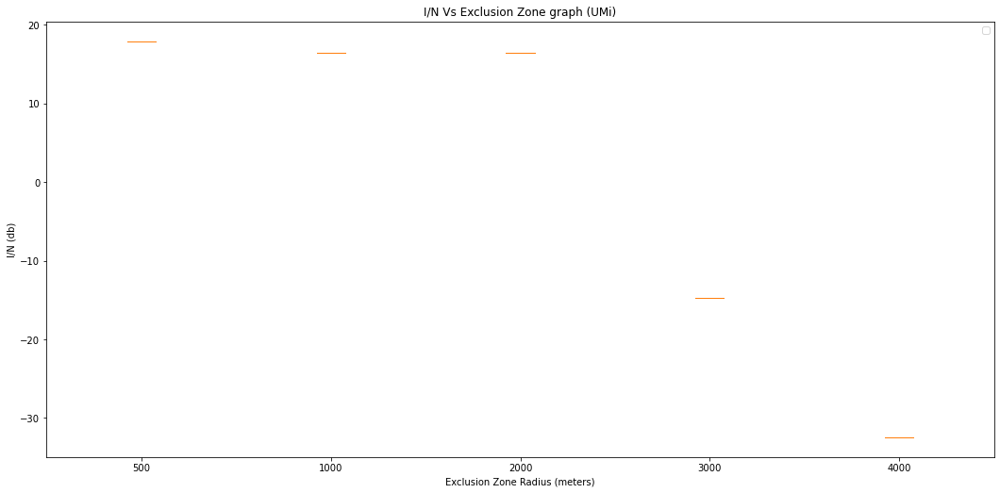

In [47]:
# EXCLUSION ZONE

# Creating dataset
# distance, interface_Noise = pairs_noAverage['UMi']
distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot([interface_Noise[exclusion_zone]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('aggregatedirecgraphUmiexclusion5km.pdf', dpi=100)
plt.show()

2022-11-04 12:46:29,838 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


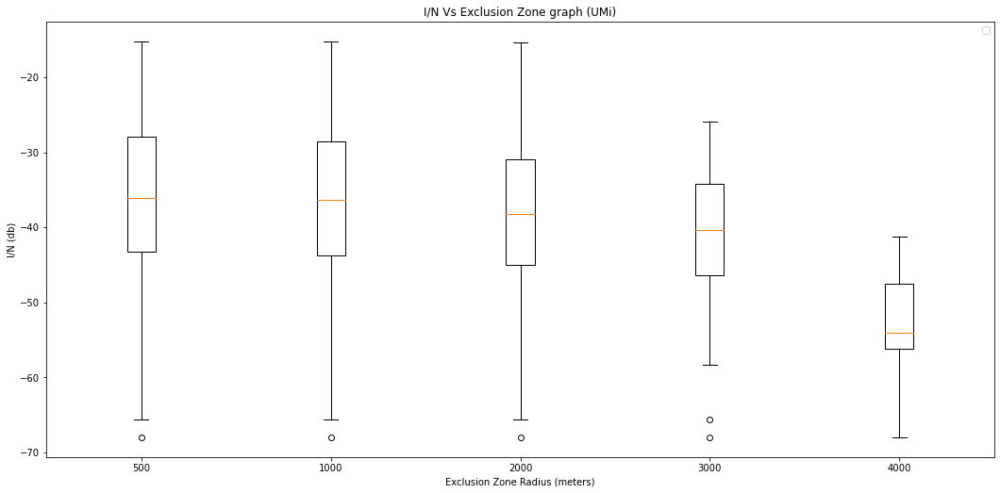

In [46]:
# EXCLUSION ZONE (-15db BS)

# Creating dataset
distance, interface_Noise = pairs_noAverage['UMi']
# distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot( [x for x in  interface_Noise[exclusion_zone] if x < -15],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('-15dbaggregatedirecgraphUmiexclusion5km.pdf', dpi=100)
plt.show()

In [34]:
# for key in pairs:
#   plt.scatter(pairs[key][0], pairs[key][1], label=key)

# plt.title('Average I/N Vs Distance graph')
# plt.xlabel('Distance (meter)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()

In [35]:
# for key in pairs_noAverage:
#   plt.scatter(pairs_noAverage[key][0], pairs_noAverage[key][1], label=key)

# plt.title('I/N Vs Distance graph')
# plt.xlabel('Distance (meter)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()

2022-11-02 13:26:36,519 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


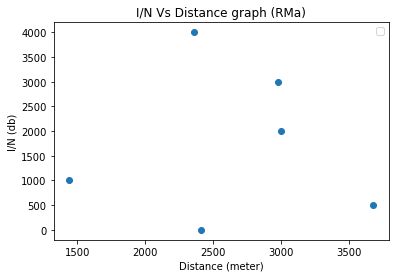

In [36]:
distance, interface_Noise = pairs_noAverage['RMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-02 13:26:36,600 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


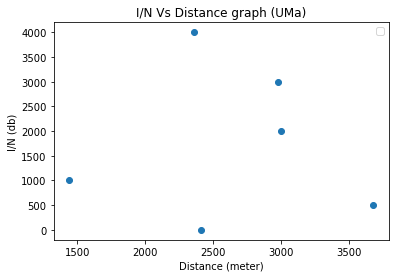

In [37]:
distance, interface_Noise = pairs_noAverage['UMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

2022-11-02 13:26:36,678 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


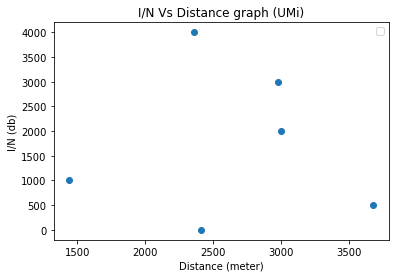

In [38]:
distance, interface_Noise = pairs_noAverage['UMi']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

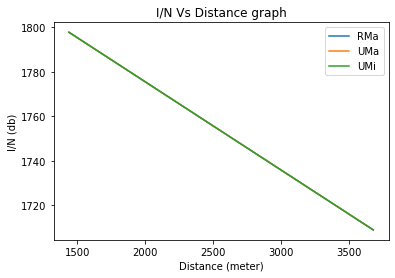

In [39]:
for key in pairs_noAverage:
  distance, interface_Noise = pairs_noAverage[key]
  distance_1D = np.array([])
  for arr in distance:
    distance_1D = np.append(distance_1D, arr)
  interface_Noise_1D = np.array([])
  for arr in interface_Noise:
    interface_Noise_1D = np.append(interface_Noise_1D, arr)
  distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance_1D, interface_Noise_1D)))
  coefficients = np.polyfit(distance_sorted, interface_Noise_sorted,1)
  # y = ax + b, where y is the average of interface_Noise_sorted
  plt.plot(np.array(distance_sorted), np.polyval(coefficients, distance_sorted), label=key)

plt.title('I/N Vs Distance graph')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

In [40]:
# from matplotlib.lines import Line2D
# output= False
# bs_ue_max_radius = 1000
# bs_ue_min_radius= 1
# base_station_count=33
# fig = plt.figure()
# ax = fig.add_subplot(111)


# fss1 = BS(radius, max_height=1.5, carr_freq=12e3, interference_type=None)
# x,y,z = 0,0,0
        
# FSS_X=np.array([])
# FSS_Y=np.array([])
# FSS_Z=np.array([])
# FSS_CHANNELS = []
# for i in range (1):
#     FSS_X = np.append(FSS_X, x)
#     FSS_Y = np.append(FSS_Y, y)
#     FSS_Z = np.append(FSS_Z, z)
#     # 0 means not in use, 1 means in use
#     channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
#     channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
#     FSS_CHANNELS.append(channels_used)
#     if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
# if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)


# BS_X=np.array([])
# BS_Y=np.array([])
# BS_Z=np.array([])

# # Randomly select base stations 
# base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

# for i in base_station_indexes:

#     lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#     bs1 = BS(radius, max_height=35, carr_freq=12e3, interference_type=None)
#     x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
#     y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
# #         z_BS = R * math.sin(math.radians(lat_BS))

#     BS_X = np.append(BS_X, x_BS - x_FSS)
#     BS_Y = np.append(BS_Y, y_BS - y_FSS)
#     BS_Z = np.append(BS_Z, 0)
#     if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))

# if output: print(BS_X,BS_Y,BS_Z)

# # Create user equipment
# UE_X=np.array([])
# UE_Y=np.array([])
# UE_Z=np.array([])
# UE_CHANNEL=np.array([])
# for p in range (len(BS_X)):
#     UE_X=np.array([])
#     UE_Y=np.array([])
#     UE_Z=np.array([])
#     UE_CHANNEL=np.array([])
#     for i in range(33):
# # number of split regions
# # i is the sector number
#         for j in range(10):
#   # number of UEs per region
#   # j is the number of the UE in one sector
#             bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
#             theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
#             # 0-120, 120-240, 240-360
#             radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

#             x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
#             y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

#             UE_X = np.append(UE_X, x1)
#             UE_Y = np.append(UE_Y, y1)
#             UE_Z = np.append(UE_Z, 1.5)

#             maximum_UEs_per_channel = 4

#             if j > maximum_UEs_per_channel * BS_Channels.channel_count:
#                 raise Exception(f"BS cannot support {j} UEs")

#             count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

#             channel = random.randint(1, BS_Channels.channel_count)

#             while count[channel] >= maximum_UEs_per_channel:
#                 channel = random.randint(1, BS_Channels.channel_count)

#             count[channel] += 1

#             UE_CHANNEL = np.append(UE_CHANNEL, channel)

#             if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
#         if output: print(UE_X,UE_Y,UE_Z)
#     ax.scatter(UE_X,UE_Y,alpha=0.8, s=30,label= 'UE Location', color='green',)
            

# ax.scatter(BS_X,BS_Y,alpha=0.8, s=30,label= 'BS Location', color='red')
# ax.scatter(FSS_X,FSS_Y,alpha=0.8, s=30,label= 'FSS Location',color='yellow')
# legend_handles = [Line2D([0], [0], marker='o', color='w', label='UE Location', markerfacecolor='g'),
#           Line2D([0], [0], marker='o', color='w', label='BS Location', markerfacecolor='r'),
#           Line2D([0], [0], marker='o', color='w', label='FSS Location', markerfacecolor='y')
# ]
          
# plt.legend(handles=legend_handles)

# # plt.legend(loc=2)
# plt.title('FSS, BS and UE Location plot')
# ax.set_xlabel('X Label')
# ax.set_ylabel('Y Label')

# # fig.savefig('graphcoex.pdf', dpi=100)
# plt.show()


In [41]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
#show plot
plt.show()
# plt.save

KeyError: 1

In [ ]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
plt.boxplot([box_dict_UMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
# show plot
plt.show()


In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
plt.boxplot([box_dict_RMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('No. of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
# show plot
# plt.show()

 
# show plot
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys][0])
# ax.set_xticklabels([keys[0]])
 
# show plot
plt.show()


In [ ]:
# # Creating dataset
# box_dict_UMi = dict()
# distance, interface_Noise = pairs_noAverage['UMi']
# for i in range(len(interface_Noise)):
#     if distance[i] not in box_dict_UMi:
#         box_dict_UMi[distance[i]] = []
#     box_dict_UMi[distance[i]].append(interface_Noise[i])

# elevation_dict_UMi = dict()

# for p in range (len(BS_X)):
#     x, y, z = BS_X[p]-FSS_X[0], BS_Y[p]-FSS_Y[0], 10-FSS_Z[0]

#     distance_2D = math.sqrt(((FSS_X[0]-BS_X[p])**2)+((FSS_Y[0]- BS_Y[p])**2)+((FSS_Z[0]-10)**2))

#     theta_bs_es = math.degrees(math.atan(y/x)) % 360
#     phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
#     fss_phi_difference = abs(15 - phi_bs_es)

    
#     if distance_2D in box_dict_UMi:
#         elevation_dict_UMi[fss_phi_difference] = box_dict_UMi[distance_2D]

# plt.title('I/N Vs Elevation graph (UMi)')
# plt.xlabel('Elevation (degrees)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()


In [ ]:
# elevation_dict_UMi

In [ ]:
#Elevation angles (FSS towards to sky )
fig, ax=plt.subplots()

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}

contexts = sorted([context for context in FSS_phi], key=lambda x:FSS_phi[x])
boxplots = []

boxplots=ax.boxplot([pairs_noAverage[context][1] for context in contexts])
# for context in contexts:
#     distance, interface_Noise = pairs_noAverage[context]
#     boxplots.append(plt.boxplot(interface_Noise))

ax.set_xticklabels([FSS_phi[context] for context in contexts])

ax.set_title('I/N Vs Elevation graph')
ax.set_xlabel('Elevation (degrees)')
ax.set_ylabel('I/N (db)')
ax.legend()
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmi.pdf', dpi=100)
plt.show()

In [ ]:
# # Creating dataset
# box_dict_UMa = dict()
# distance, interface_Noise = pairs_noAverage['UMa']
# for i in range(len(interface_Noise)):
#     if distance[i] not in box_dict_UMa:
#         box_dict_UMa[distance[i]] = []
#     box_dict_UMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# # print(box_dict_UMi)

# fig, ax= plt.subplots()
 
# # Creating plot
# keys = sorted([key for key in box_dict_UMa])
# for i, key in enumerate(keys):
#     # key is distance
#     # print(key)
#     # print(box_dict_UMi[key])
#     line_of_sight1 = box_dict_UMa[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMa[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# # keys = sorted([key for key in box_dict_UMi])
# # ax.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels([int(i) for i in keys])

# ax.set_title('I/N Vs Distance graph (UMa)')
# ax.set_xlabel('Distnace of Each BS to FSS (meters)')
# ax.set_ylabel('I/N (db)')
# ax.legend()
 
# # show plot
# # plt.show()
# fig.set_size_inches(18, 8.5)
# # fig.savefig('graphUMa.pdf', dpi=100)
# plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if not line_of_sight[i]:
        continue   
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1  else 'red'))
    
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='red' if not line_of_sight1))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi LOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if line_of_sight[i]:
        continue
        
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1))
    
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='red' if not line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi NLOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_RMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_RMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (RMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphRma.pdf', dpi=100)
plt.show()

In [ ]:
pathloss_UMi